In [1]:
import osmnx as ox
ox.config(use_cache=True, log_console=True)
import pickle
# Using this option to make sure we can open pickled dataframes back
pickle.HIGHEST_PROTOCOL = 4
import pandas as pd
import geopandas as gpd
import fiona
#from pandana.loaders import osm

import pickle

import os



In [2]:
gpd.__version__,pd.__version__

('0.9.0', '1.2.4')

In [3]:
def saveGraph(G,name):
    with open('data/'+name+'.pkl', 'wb') as output: 
        pickle.dump(G, output, pickle.HIGHEST_PROTOCOL)

# Arrondissement

[ 2.32559016 48.8466125   2.41643101 48.90216191]



<AxesSubplot:>

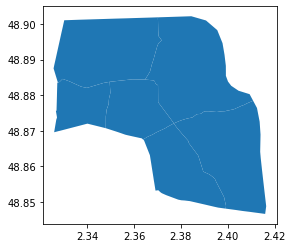

In [76]:
districts = "data/data_original/arrondissements.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
gdf = gpd.read_file(districts, driver='KML')
targets = [str(750000000 + x) for x in [9,18,19,20,10,11]]
df = gdf[gdf.Name.isin(targets)]
saveGraph(df,"district")
zoi = df.geometry.unary_union
saveGraph(zoi,"zoi")
[west, south, east, north] = df.total_bounds
print( df.total_bounds )
print()
df.plot()

In [5]:
df.total_bounds

array([ 2.32559016, 48.8466125 ,  2.41643101, 48.90216191])

Data loaded. Displaying routes


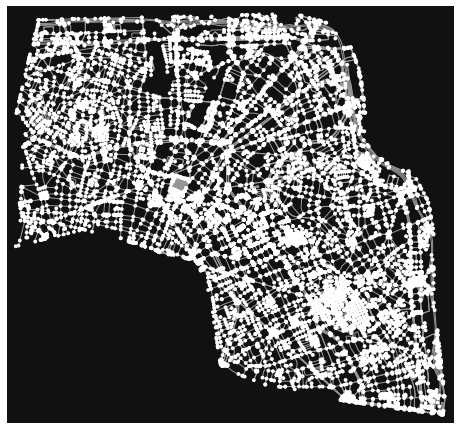

In [6]:
# create network from that bounding box
if not os.path.isfile('./data/G2.pkl'):
    print("Creating the cache")
    G2 = ox.graph_from_polygon(zoi, network_type='all')
    #G2 = ox.graph_from_bbox(north, south, east, west, network_type='all')
    G2 = ox.project_graph(G2)
    saveGraph(G2,"G2")
else:
    with open('./data/G2.pkl', 'rb') as input:
        G2 = pickle.load(input)
print("Data loaded. Displaying routes")
fig, ax = ox.plot_graph(G2)



In [8]:
with open('./data/G2_consolides.pkl', 'rb') as input:
    G3 = pickle.load(input)

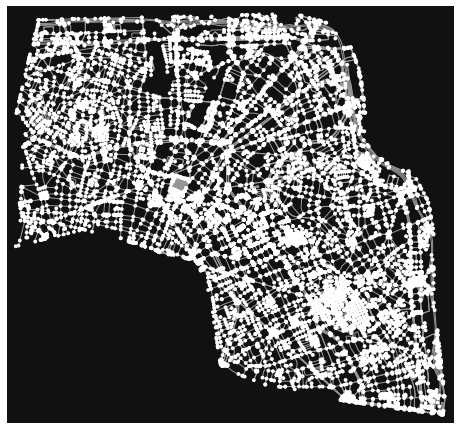

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [7]:
# Let's give it a clean
G3 = ox.consolidate_intersections(G2, tolerance=0.00001, rebuild_graph=True, dead_ends=True)
saveGraph(G3,"G2_consolides")
ox.plot_graph(G3)

# Buildings

In [9]:
districts = "data/data_original/volumesbatisparis.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
BATS = gpd.read_file(districts, driver='KML')
BATS

,Name,Description,geometry
0,V,,"POLYGON ((2.35288 48.87764, 2.35286 48.87759, ..."
1,V,,"POLYGON ((2.35324 48.87779, 2.35323 48.87779, ..."
2,V,,"POLYGON ((2.35318 48.87807, 2.35312 48.87805, ..."
3,V,,"POLYGON ((2.35310 48.87807, 2.35302 48.87805, ..."
4,V,,"POLYGON ((2.35302 48.87849, 2.35286 48.87844, ..."
...,...,...,...
359876,V,,"POLYGON ((2.34524 48.88727, 2.34523 48.88717, ..."
359877,V,,"POLYGON ((2.34596 48.88671, 2.34594 48.88671, ..."
359878,V,,"POLYGON ((2.34700 48.88675, 2.34673 48.88669, ..."
359879,V,,"POLYGON ((2.33990 48.88726, 2.33990 48.88725, ..."


In [10]:
BoI = BATS[BATS.within(zoi)]
BoI

,Name,Description,geometry
0,V,,"POLYGON ((2.35288 48.87764, 2.35286 48.87759, ..."
1,V,,"POLYGON ((2.35324 48.87779, 2.35323 48.87779, ..."
2,V,,"POLYGON ((2.35318 48.87807, 2.35312 48.87805, ..."
3,V,,"POLYGON ((2.35310 48.87807, 2.35302 48.87805, ..."
4,V,,"POLYGON ((2.35302 48.87849, 2.35286 48.87844, ..."
...,...,...,...
359876,V,,"POLYGON ((2.34524 48.88727, 2.34523 48.88717, ..."
359877,V,,"POLYGON ((2.34596 48.88671, 2.34594 48.88671, ..."
359878,V,,"POLYGON ((2.34700 48.88675, 2.34673 48.88669, ..."
359879,V,,"POLYGON ((2.33990 48.88726, 2.33990 48.88725, ..."


<AxesSubplot:>

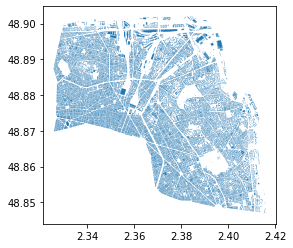

In [11]:
BoI.plot()

In [12]:
saveGraph(BoI,"BoI")

# Preparing trees

In [13]:
districts = "data/data_original/les-arbres.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
trees = gpd.read_file(districts, driver='KML')
trees

,Name,Description,geometry
0,271569,,POINT (2.30228 48.86160)
1,220797,,POINT (2.26499 48.83434)
2,236580,,POINT (2.32586 48.88313)
3,107325,,POINT (2.29715 48.85511)
4,160931,,POINT (2.42015 48.90595)
...,...,...,...
204475,113204,,POINT (2.41586 48.84867)
204476,116134,,POINT (2.40019 48.85069)
204477,126612,,POINT (2.29118 48.83699)
204478,222347,,POINT (2.30332 48.88421)


,Name,Description,geometry
9,241458,,POINT (2.38735 48.87378)
11,105945,,POINT (2.41102 48.86638)
12,120203,,POINT (2.34310 48.89607)
23,218592,,POINT (2.37445 48.87919)
24,219332,,POINT (2.39592 48.85479)
...,...,...,...
204463,285232,,POINT (2.33354 48.88783)
204465,297992,,POINT (2.41177 48.87200)
204472,238814,,POINT (2.39416 48.87876)
204475,113204,,POINT (2.41586 48.84867)


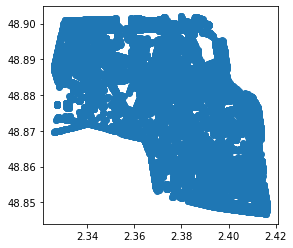

In [14]:
ToI = trees[trees.within(zoi)]
ToI.plot()
ToI

In [15]:
saveGraph(ToI,"ToI")

# Lights

In [16]:
districts = "data/data_original/eclairage-public.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
lights = gpd.read_file(districts, driver='KML')
lights

,Name,Description,geometry
0,BP11374,,POINT (2.30058 48.82562)
1,BP11377,,POINT (2.30068 48.82560)
2,BP11380,,POINT (2.30077 48.82558)
3,BP11391,,POINT (2.30124 48.82536)
4,BP11395,,POINT (2.30085 48.82556)
...,...,...,...
229116,27280,,POINT (2.28588 48.85119)
229117,27359,,POINT (2.31142 48.84825)
229118,27368,,POINT (2.31259 48.85277)
229119,27371,,POINT (2.31196 48.85280)


,Name,Description,geometry
14,BP04437,,POINT (2.41400 48.85408)
158,BP03599,,POINT (2.36035 48.90119)
159,BP03642,,POINT (2.35795 48.90101)
160,BP03646,,POINT (2.35642 48.90108)
161,BP03655,,POINT (2.35205 48.90128)
...,...,...,...
229062,26315,,POINT (2.35090 48.87015)
229074,26461,,POINT (2.38221 48.87872)
229075,26474,,POINT (2.38416 48.87933)
229076,26487,,POINT (2.38688 48.87957)


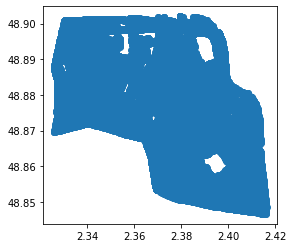

In [17]:
LoI = lights[lights.within(zoi)]
LoI.plot()
saveGraph(LoI,"LoI")
LoI

# Fountains?

In [18]:
districts = "data/data_original/fontaines-a-boire.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
fountains = gpd.read_file(districts, driver='KML')
fountains

,Name,Description,geometry
0,450019294,,POINT (2.40023 48.84786)
1,450019292,,POINT (2.40606 48.84734)
2,450024923,,POINT (2.29638 48.83758)
3,450080455,,POINT (2.33825 48.89835)
4,450077011,,POINT (2.29570 48.84696)
...,...,...,...
1190,450019320,,POINT (2.27325 48.84741)
1191,450070406,,POINT (2.27768 48.85779)
1192,450070601,,POINT (2.38286 48.86727)
1193,450080650,,POINT (2.33871 48.87644)


,Name,Description,geometry
3,450080455,,POINT (2.33825 48.89835)
5,450080592,,POINT (2.34978 48.89170)
15,450072538,,POINT (2.34353 48.88812)
16,450072573,,POINT (2.38682 48.88140)
17,450072150,,POINT (2.39144 48.85191)
...,...,...,...
1178,450080127,,POINT (2.35057 48.87116)
1183,450080775,,POINT (2.36257 48.89687)
1192,450070601,,POINT (2.38286 48.86727)
1193,450080650,,POINT (2.33871 48.87644)


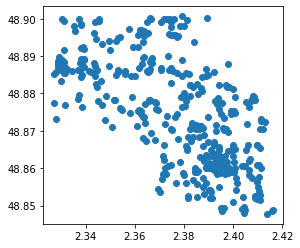

In [19]:
FoI = fountains[fountains.within(zoi)]
FoI.plot()
saveGraph(FoI,"FoI")
FoI

# Espaces verts

,identifiant,nsq_espace_,nom,type,p_vegetatio,proportion_,adresse,arrondissem,statut_ouve,ouvert_24h,...,horaires_pe,horaires_lu,horaires_ma,horaires_me,horaires_je,horaires_ve,horaires_sa,horaires_di,id_dicom,geometry
0,ID155,920.0,CIMETIERE SAINT-VINCENT,CimetiÃ¨res,0.014936,1.493633,"6, rue Lucien-Gaulard",75018,Ouvert,Non,...,None,08:00 - 18:00,08:00 - 18:00,08:00 - 18:00,08:00 - 18:00,08:00 - 18:00,08:30 - 18:00,09:00 - 18:00,4484,"POLYGON ((2.33929 48.88939, 2.33928 48.88938, ..."
8,ID732,663.0,Jardin de l'Ã®lot Riquet,Promenades ouvertes,0.249215,24.921454,8 RUE DOCTEUR LAMAZE,75019,Ouvert,Oui,...,Du 01/05/2021 au 31/08/2021,00:00 - 23:59,00:00 - 23:59,00:00 - 23:59,00:00 - 23:59,00:00 - 23:59,00:00 - 23:59,00:00 - 23:59,2657,"POLYGON ((2.37313 48.89046, 2.37326 48.89040, ..."
12,ID812,10963.0,JARDIN DE LA COUR DE LA FERME SAINT-LAZARE,Promenades ouvertes,0.003779,0.377944,6 SQ ALBAN SATRAGNE,75010,None,Non,...,None,None,None,None,None,None,None,None,None,"POLYGON ((2.35456 48.87585, 2.35451 48.87585, ..."
14,ID896,553.0,TERRAIN DE BOULES AVENUE JUNOT,Promenades ouvertes,0.655366,65.536628,8 VOIE M/18,75018,None,Non,...,None,None,None,None,None,None,None,None,None,"POLYGON ((2.33557 48.88821, 2.33558 48.88820, ..."
26,ID1107,746.0,SQUARE SARAH BERNHARDT,Promenades ouvertes,0.309828,30.982784,13 RUE MOUNET SULLY,75020,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 21:30,08:00 - 21:30,08:00 - 21:30,08:00 - 21:30,08:00 - 21:30,09:00 - 21:30,09:00 - 21:30,1774,"POLYGON ((2.40461 48.84979, 2.40475 48.84962, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
908,ID1268,535.0,SQUARE DE LA MADONE,Promenades ouvertes,0.515498,51.549802,17 RUE ROSES,75018,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,09:00 - 20:30,09:00 - 20:30,2669,"POLYGON ((2.36173 48.89316, 2.36159 48.89252, ..."
909,ID1242,10996.0,JARDIN RUE DU CHALET,Promenades ouvertes,0.001132,0.113168,18 RUE CHALET,75010,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,09:00 - 20:30,09:00 - 20:30,17442,"MULTIPOLYGON (((2.37343 48.87409, 2.37355 48.8..."
914,ID1353,665.0,SQUARE MARCEL MOULOUDJI,Promenades ouvertes,0.680334,68.033396,12 RUE PIERRE REVERDY,75019,Ouvert,Non,...,Du 19/05/2021 au 31/08/2021,09:30 - 20:30,09:30 - 20:30,09:30 - 20:30,09:30 - 20:30,09:30 - 20:30,09:00 - 20:30,09:00 - 20:30,2659,"POLYGON ((2.37727 48.88572, 2.37768 48.88536, ..."
917,ID1436,740.0,JARDIN DE LA RUE DES COURONNES,Promenades ouvertes,0.528231,52.823115,73 RUE COURONNES,75020,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,09:00 - 20:30,09:00 - 20:30,2748,"POLYGON ((2.38812 48.87112, 2.38812 48.87112, ..."


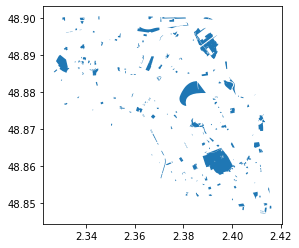

In [20]:
districts = "data/data_original/ilots-de-fraicheur-espaces-verts-frais.zip" 
Bon = gpd.read_file(districts)

FAoI = Bon[Bon.within(zoi)]
FAoI.plot()
saveGraph(FAoI,"FAoI")
FAoI


,Name,Description,geometry
0,Passage du Désir,,"LINESTRING (2.35652 48.87337, 2.35525 48.87370..."
1,Rue Jarry,,"LINESTRING (2.35677 48.87382, 2.35527 48.87416)"
2,Rue Tandou,,"LINESTRING (2.37834 48.88573, 2.37961 48.88607)"
4,Rue de la Tour d'Auvergne,,"LINESTRING (2.34122 48.87969, 2.34026 48.87993)"
6,Rue Gambey,,"LINESTRING (2.37147 48.86583, 2.37231 48.86464)"
...,...,...,...
138,Rue Popincourt,,"LINESTRING (2.37585 48.85942, 2.37650 48.85855)"
146,Rue Guillaume Bertrand,,"LINESTRING (2.37933 48.86308, 2.38110 48.86387)"
149,Rue d'Avron,,"LINESTRING (2.39867 48.85133, 2.41039 48.85349)"
151,Rue Saint-Maur,,"LINESTRING (2.37039 48.87370, 2.37133 48.87250..."


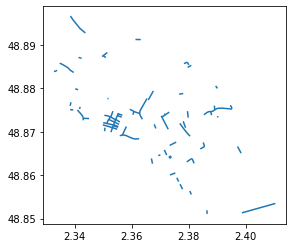

In [21]:
districts = "data/data_original/deconfinement-rues-amenagees-pour-pietons.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
RuesPietonnes = gpd.read_file(districts, driver='KML')
RPoI = RuesPietonnes[RuesPietonnes.within(zoi)]
RPoI.plot()
saveGraph(RPoI,"FoI")
RPoI

# Green spaces

,Name,Description,geometry
2,122,,"POLYGON ((2.35479 48.87538, 2.35474 48.87541, ..."
7,763,,"POLYGON ((2.41245 48.87123, 2.41258 48.87131, ..."
8,764,,"POLYGON ((2.39083 48.86639, 2.39091 48.86640, ..."
11,11231,,"POLYGON ((2.36180 48.88663, 2.36184 48.88661, ..."
12,10074,,"POLYGON ((2.38064 48.85612, 2.38067 48.85609, ..."
...,...,...,...
2136,12006,,"POLYGON ((2.32751 48.87650, 2.32750 48.87650, ..."
2140,12037,,"POLYGON ((2.34469 48.88195, 2.34469 48.88195, ..."
2145,12148,,"POLYGON ((2.38839 48.86608, 2.38861 48.86614, ..."
2146,12182,,"MULTIPOLYGON (((2.39818 48.86560, 2.39817 48.8..."


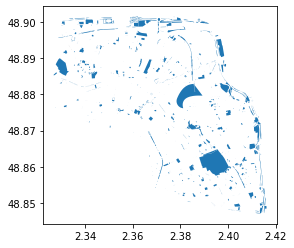

In [22]:
districts = "data/data_original/espaces_verts.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
EspacesVerts = gpd.read_file(districts, driver='KML')
EVoI = EspacesVerts[EspacesVerts.within(zoi)]
EVoI.plot()
saveGraph(EVoI,"EVoI")
EVoI

# Going for a full map

In [88]:
with open('./data/G2_consolides.pkl', 'rb') as input:
    G = pickle.load(input)
with open('./data/BoI.pkl', 'rb') as input:
    BoI = pickle.load(input) 
gdNodes,gdStreet = ox.utils_graph.graph_to_gdfs(G) 
gdNodes = gdNodes.reset_index().to_crs("EPSG:4326")
gdStreet = gdStreet.to_crs("EPSG:4326")


In [89]:
gdStreet

osmid                   name  \
u     v     key                                                             
0     1     0                            315818975    Rue Henri Duvernois   
      2     0                             31093720      Rue Louis Lumière   
      3     0                             85735969      Rue Louis Lumière   
      4     0               [266463585, 611974677]        Rue Louis Ganne   
1     0     0                            315818975    Rue Henri Duvernois   
...                                            ...                    ...   
11810 946   0     [69244433, 958991700, 958991701]        Impasse Sandrié   
11812 3503  0               [748636365, 168143655]  Rue Hélène Jakubowicz   
      4089  0                            961265783                    NaN   
11813 5092  0    [961264816, 961264817, 961264814]                    NaN   
11814 11267 0                            963951053   Place de la Bastille   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11810 946   0          pedestrian      NaN   False   88.401   
11812 3503  0         residential       30    True  140.798   
      4089  0             footway      NaN   False  115.209   
11813 5092  0    [steps, footway]      NaN   False   29.778   
11814 11267 0             footway      NaN   False   22.767   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11810 946   0    LINESTRING (2.32935 48.87175, 2.33007 48.87167...   
11812 3503  0    LINESTRING (2.39807 48.86955, 2.39825 48.86941...   
      4089  0    LINESTRING (2.39807 48.86955, 2.39850 48.86985...   
11813 5092  0    LINESTRING (2.39157 48.87100, 2.39156 48.87103...   
11814 11267 0    LINESTRING (2.36944 48.85320, 2.36933 48.85328...   

                 u_original  v_original lanes junction width tunnel access  \
u     v     key                                                              
0     1     0        125730   268675130   NaN      NaN   NaN    NaN    NaN   
      2     0        125730  2841627108     2      NaN   NaN    NaN    NaN   
      3     0        125730   244455548     2      NaN   NaN    NaN    NaN   
      4     0        125730  1089076050     2      NaN   NaN    NaN    NaN   
1     0     0     268675130      125730   NaN      NaN   NaN    NaN    NaN   
...                     ...         ...   ...      ...   ...    ...    ...   
11810 946   0    8873639223  8873639228   NaN      NaN   NaN    NaN    NaN   
11812 3503  0    8892125615   247352376   NaN      NaN   NaN    NaN    NaN   
      4089  0    8892125615  8892125608   NaN      NaN   NaN    NaN    NaN   
11813 5092  0    8892142688  8892142678   NaN      NaN   NaN    NaN    NaN   
11814 11267 0    8916466365  8916466367   NaN      NaN   NaN    NaN    NaN   

                bridge service  ref  
u     v     key                      
0     1     0      NaN     NaN  NaN  
      2     0      NaN     NaN  NaN  
      3     0      NaN     NaN  NaN  
      4     0      NaN     NaN  NaN  
1     0     0      NaN     NaN  NaN  
...                ...     ... 

In [90]:
print("There are",len(gdStreets[1]),"streets mapped.")

There are 26653 streets mapped.


<AxesSubplot:>

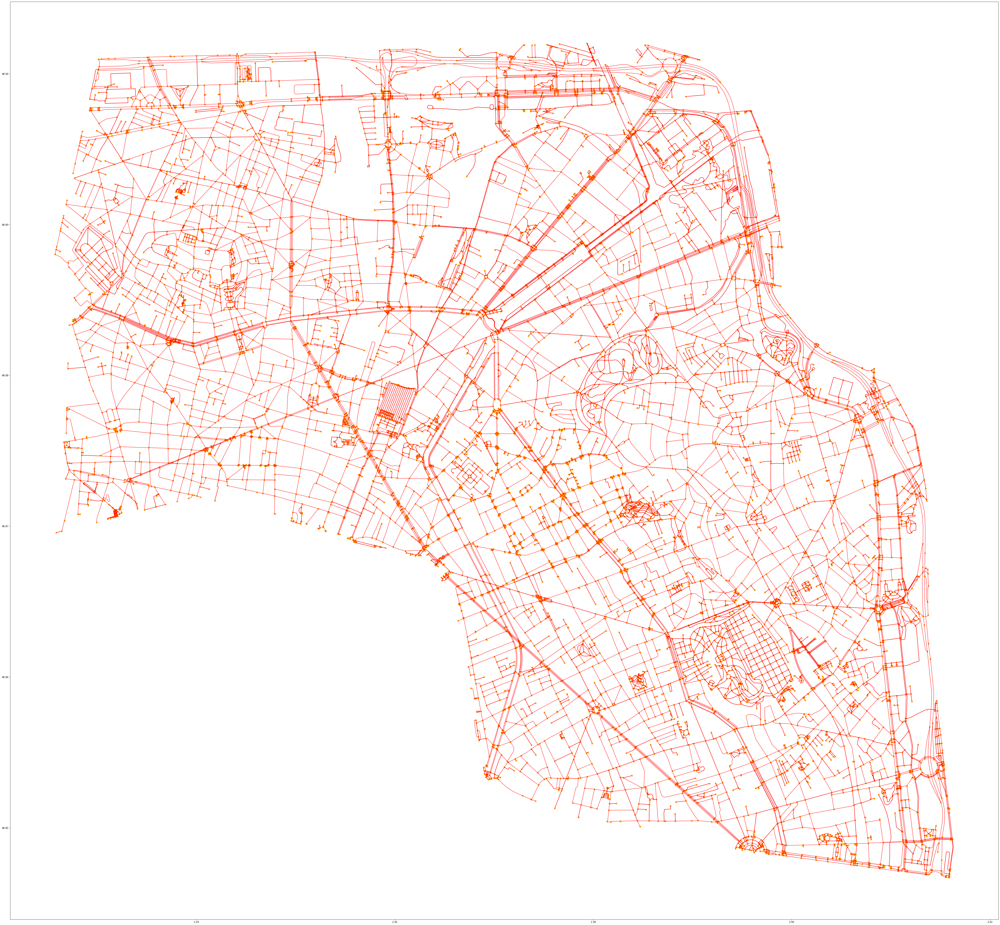

In [91]:
# Note  gdStreets[0] are nodes, gdStreets[1] are edges
ax = gdStreet.plot(figsize=(75, 75), alpha=0.8, edgecolor='r')
gdNodes.plot(ax=ax, alpha=1, markersize=35, color = "orange")

In [92]:
gdNodes.head()

,osmid,osmid_original,y,x,street_count,lon,lat,highway,ref,geometry
0,0,125730,5.412452e+06,456781.900993,4,2.410732,48.863523,NaN,NaN,POINT (2.41073 48.86352)
1,1,268675130,5.412447e+06,456789.384246,5,2.410834,48.863483,NaN,NaN,POINT (2.41083 48.86348)
2,2,2841627108,5.412574e+06,456744.278141,4,2.410206,48.864623,crossing,NaN,POINT (2.41021 48.86462)
3,3,244455548,5.412347e+06,456794.553236,4,2.410915,48.862578,NaN,NaN,POINT (2.41092 48.86258)
4,4,1089076050,5.412436e+06,456658.320573,4,2.409049,48.863371,NaN,NaN,POINT (2.40905 48.86337)


<AxesSubplot:>

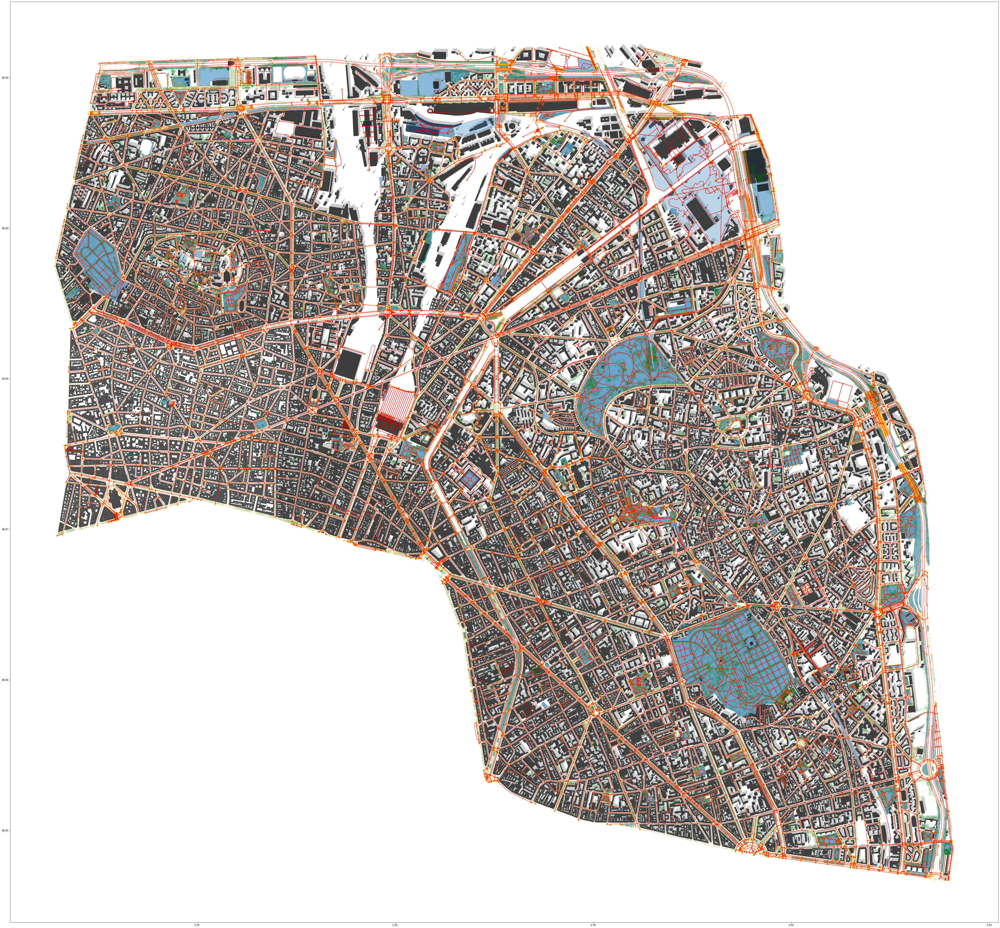

In [93]:
ax = EVoI.plot(figsize=(75, 75), alpha=0.5, edgecolor='k')
gdStreet.plot(ax=ax, alpha=0.8, edgecolor='r')
gdNodes.plot(ax=ax, alpha=1, markersize=35, color = "orange")
with open('./data/BoI_shaded_simple.pkl', 'rb') as input:
    # this requires the "BoI_shaded_simple" file generated later on
    BoIS = pickle.load(input) 
BoIS.plot(ax=ax, alpha=0.4, color='grey')
BoI.plot(ax=ax, alpha=0.7, color='black')
FoI.plot(ax=ax, alpha=0.99)
FAoI.plot(ax=ax, alpha=0.3)
ToI.plot(ax=ax, alpha=0.06,markersize =90,color="green")
LoI.plot(ax=ax, alpha=0.06,markersize =90,color="orange")

<AxesSubplot:>

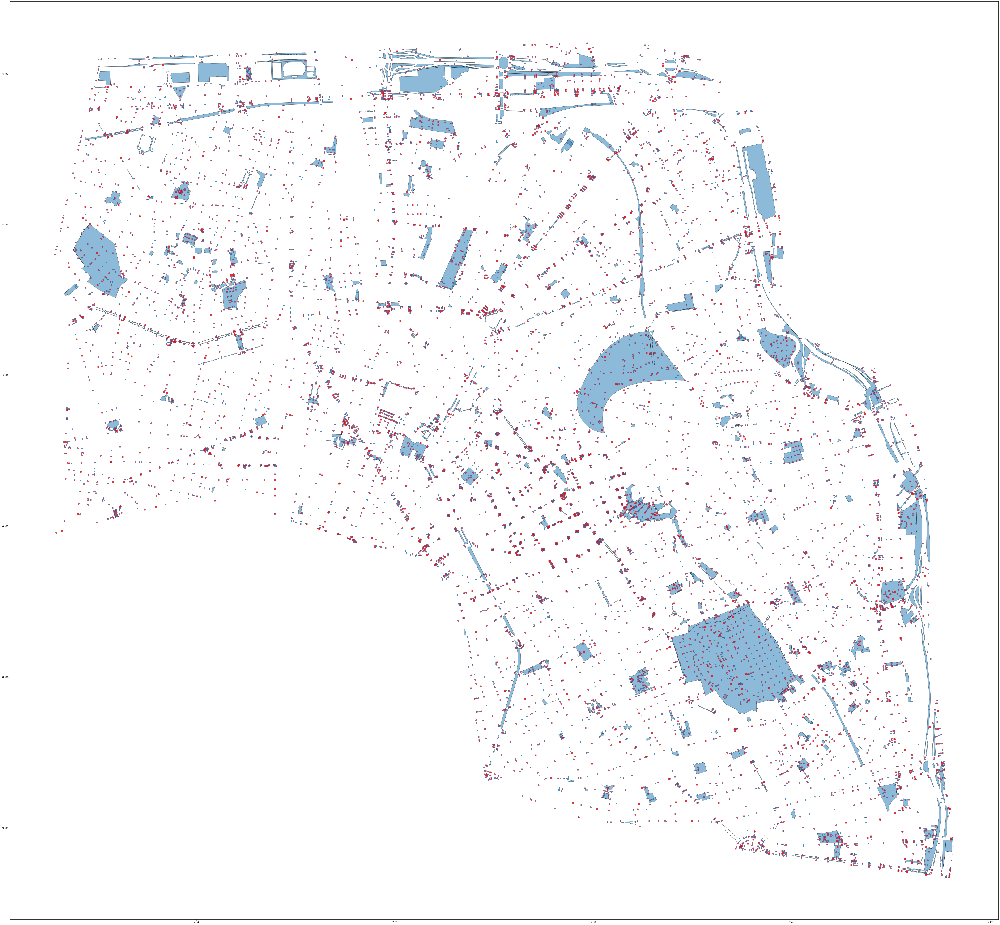

In [94]:
ax = EVoI.plot(figsize=(75, 75), alpha=0.5, edgecolor='k')
gdNodes.plot(ax=ax, alpha=0.8, edgecolor='r')

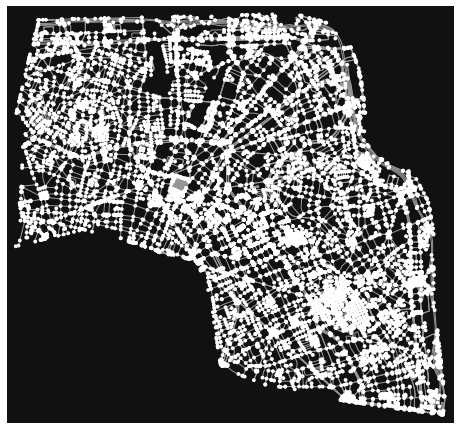

<Figure size 432x288 with 0 Axes>

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [95]:
fig, ax = ox.plot_graph(G)
ox.plot.plot_footprints(EVoI, ax=ax, figsize=(15, 15))#, color='orange', alpha=None, bgcolor='#111111', bbox=None, save=False, show=True, close=False, filepath=None, dpi=600)

# Let's see what our buildings look like

## We don't need all individual blocks, let's keep only the overall footprint

#### Reference mapping

<AxesSubplot:>

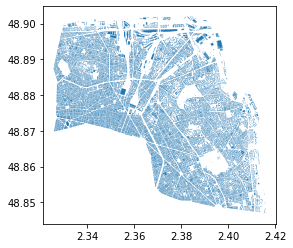

In [96]:
with open('./data/BoI.pkl', 'rb') as input:
    BoI = pickle.load(input) 
    
BoI.plot()

#### Let's merge these

In [97]:
pickle.HIGHEST_PROTOCOL = 5
combined_polygons = BoI.dissolve().explode()
pickle.HIGHEST_PROTOCOL = 4

<AxesSubplot:>

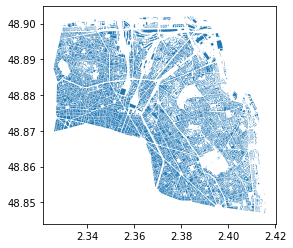

In [98]:
combined_polygons.plot()

# We can keep around 3% of the initial shapes!

In [99]:
len(combined_polygons)/len(BoI)*100

3.5327328136816645

<AxesSubplot:>

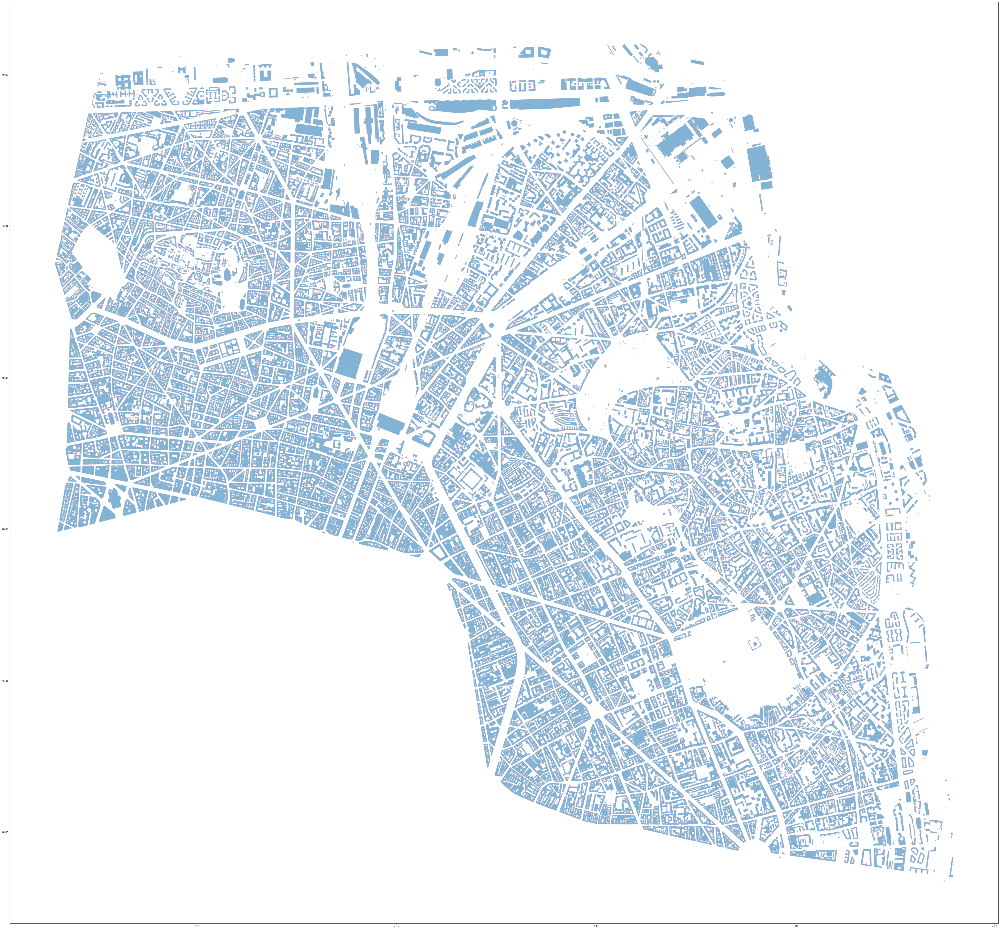

In [100]:
ax = BoI.plot(figsize=(75, 75), alpha=0.1)
combined_polygons.plot(ax=ax, alpha=0.5, edgecolor='pink')

In [101]:
saveGraph(combined_polygons,"BoI_simple")

In [102]:
gdStreets[1]

osmid                   name  \
u     v     key                                                             
0     1     0                            315818975    Rue Henri Duvernois   
      2     0                             31093720      Rue Louis Lumière   
      3     0                             85735969      Rue Louis Lumière   
      4     0               [266463585, 611974677]        Rue Louis Ganne   
1     0     0                            315818975    Rue Henri Duvernois   
...                                            ...                    ...   
11810 946   0     [69244433, 958991700, 958991701]        Impasse Sandrié   
11812 3503  0               [748636365, 168143655]  Rue Hélène Jakubowicz   
      4089  0                            961265783                    NaN   
11813 5092  0    [961264816, 961264817, 961264814]                    NaN   
11814 11267 0                            963951053   Place de la Bastille   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11810 946   0          pedestrian      NaN   False   88.401   
11812 3503  0         residential       30    True  140.798   
      4089  0             footway      NaN   False  115.209   
11813 5092  0    [steps, footway]      NaN   False   29.778   
11814 11267 0             footway      NaN   False   22.767   

                                                          geometry  \
u     v     key                                                      
0     1     0    LINESTRING (456781.901 5412451.867, 456789.384...   
      2     0    LINESTRING (456781.901 5412451.867, 456762.909...   
      3     0    LINESTRING (456781.901 5412451.867, 456784.558...   
      4     0    LINESTRING (456781.901 5412451.867, 456773.325...   
1     0     0    LINESTRING (456789.384 5412447.384, 456781.901...   
...                                                            ...   
11810 946   0    LINESTRING (450821.379 5413415.342, 450874.303...   
11812 3503  0    LINESTRING (455858.579 5413128.943, 455871.963...   
      4089  0    LINESTRING (455858.579 5413128.943, 455890.116...   
11813 5092  0    LINESTRING (455382.853 5413293.978, 455382.416...   
11814 11267 0    LINESTRING (453743.618 5411328.818, 453736.088...   

                 u_original  v_original lanes junction width tunnel access  \
u     v     key                                                              
0     1     0        125730   268675130   NaN      NaN   NaN    NaN    NaN   
      2     0        125730  2841627108     2      NaN   NaN    NaN    NaN   
      3     0        125730   244455548     2      NaN   NaN    NaN    NaN   
      4     0        125730  1089076050     2      NaN   NaN    NaN    NaN   
1     0     0     268675130      125730   NaN      NaN   NaN    NaN    NaN   
...                     ...         ...   ...      ...   ...    ...    ...   
11810 946   0    8873639223  8873639228   NaN      NaN   NaN    NaN    NaN   
11812 3503  0    8892125615   247352376   NaN      NaN   NaN    NaN    NaN   
      4089  0    8892125615  8892125608   NaN      NaN   NaN    NaN    NaN   
11813 5092  0    8892142688  8892142678   NaN      NaN   NaN    NaN    NaN   
11814 11267 0    8916466365  8916466367   NaN      NaN   NaN    NaN    NaN   

                bridge service  ref  
u     v     key                      
0     1     0      NaN     NaN  NaN  
      2     0      NaN     NaN  NaN  
      3     0      NaN     NaN  NaN  
      4     0      NaN     NaN  NaN  
1     0     0      NaN     NaN  NaN  
...                ...     ... 

In [103]:
BoI

,Name,Description,geometry
0,V,,"POLYGON ((2.35288 48.87764, 2.35286 48.87759, ..."
1,V,,"POLYGON ((2.35324 48.87779, 2.35323 48.87779, ..."
2,V,,"POLYGON ((2.35318 48.87807, 2.35312 48.87805, ..."
3,V,,"POLYGON ((2.35310 48.87807, 2.35302 48.87805, ..."
4,V,,"POLYGON ((2.35302 48.87849, 2.35286 48.87844, ..."
...,...,...,...
359876,V,,"POLYGON ((2.34524 48.88727, 2.34523 48.88717, ..."
359877,V,,"POLYGON ((2.34596 48.88671, 2.34594 48.88671, ..."
359878,V,,"POLYGON ((2.34700 48.88675, 2.34673 48.88669, ..."
359879,V,,"POLYGON ((2.33990 48.88726, 2.33990 48.88725, ..."


# Polygons

In [109]:
from shapely.geometry.polygon import Polygon
from shapely.geometry.multipolygon import MultiPolygon
# gdNodes,gdStreet
listStrees = gdStreet.reset_index()
RUE =listStrees[(listStrees.u == 209133647) & (listStrees.v == 209138149)]
RUE

,u,v,key,osmid,name,highway,maxspeed,oneway,length,geometry,u_original,v_original,lanes,junction,width,tunnel,access,bridge,service,ref


In [110]:
for row in gdStreet:
    print(row)

osmid
name
highway
maxspeed
oneway
length
geometry
u_original
v_original
lanes
junction
width
tunnel
access
bridge
service
ref


In [111]:
STREETS = gdStreet
STREETS["trees"] = -1
STREETS["lights"] = -1
STREETS["fountains"] = -1
STREETS["greenspaces"] = -1
STREETS["freshplaces"] = -1
STREETS.head()

osmid                 name      highway maxspeed  \
u v key                                                                      
0 1 0                 315818975  Rue Henri Duvernois  residential       30   
  2 0                  31093720    Rue Louis Lumière  residential       30   
  3 0                  85735969    Rue Louis Lumière  residential       30   
  4 0    [266463585, 611974677]      Rue Louis Ganne  residential       30   
1 0 0                 315818975  Rue Henri Duvernois  residential       30   

         oneway   length                                           geometry  \
u v key                                                                       
0 1 0     False    8.707    LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
  2 0     False  128.700  LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
  3 0     False  105.925  LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
  4 0     False  124.290  LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1 0 0     False    8.707    LINESTRING (2.41083 48.86348, 2.41073 48.86352)   

         u_original  v_original lanes  ... tunnel access bridge service  ref  \
u v key                                ...                                     
0 1 0        125730   268675130   NaN  ...    NaN    NaN    NaN     NaN  NaN   
  2 0        125730  2841627108     2  ...    NaN    NaN    NaN     NaN  NaN   
  3 0        125730   244455548     2  ...    NaN    NaN    NaN     NaN  NaN   
  4 0        125730  1089076050     2  ...    NaN    NaN    NaN     NaN  NaN   
1 0 0     268675130      125730   NaN  ...    NaN    NaN    NaN     NaN  NaN   

        trees lights  fountains  greenspaces  freshplaces  
u v key                                                    
0 1 0      -1     -1         -1           -1           -1  
  2 0      -1     -1         -1           -1           -1  
  3 0      -1     -1         -1           -1           -1  
  4 0      -1     -1         -1           -1           -1  
1 0 0      -1     -1         -1           -1           -1  

[5 rows x 22 columns]

In [112]:
len(STREETS[STREETS.freshplaces >= 0])

0

In [113]:
for index,row in STREETS.iterrows():
    if row["freshplaces"]<0:
        # Trees
        POLY = Polygon(row.geometry.buffer(0.0005))
        cTrees = len(ToI[ToI.within(POLY)])
        STREETS.loc[index,"trees"] = cTrees
        # Lighting
        cLights = len(LoI[LoI.within(POLY)])
        STREETS.loc[index,"lights"] = cLights
        POLY = Polygon(row.geometry.buffer(0.002))
        # Fontaines
        cFountains = len(FoI[FoI.within(POLY)])
        STREETS.loc[index,"fountains"] = cFountains
        # Espaces verts
        cEV = len(EVoI[EVoI.overlaps(POLY)])
        STREETS.loc[index,"greenspaces"] = cEV
        cFresh = len(FAoI[FAoI.overlaps(POLY)])
        STREETS.loc[index,"freshplaces"] = cFresh
        print(index,": ",cTrees,"trees -- ",cTrees,cLights,cFountains,cEV,cFresh)

(0, 1, 0) :  6 trees --  6 23 1 3 1
(0, 2, 0) :  34 trees --  34 48 3 3 0
(0, 3, 0) :  25 trees --  25 40 3 4 2
(0, 4, 0) :  12 trees --  12 66 1 3 2
(1, 0, 0) :  6 trees --  6 23 1 3 1
(1, 4678, 0) :  14 trees --  14 31 0 5 1
(1, 4023, 0) :  25 trees --  25 40 1 4 2
(1, 4679, 0) :  34 trees --  34 51 3 4 1
(1, 4680, 0) :  51 trees --  51 73 3 6 1
(2, 473, 0) :  33 trees --  33 24 3 4 1
(2, 4679, 0) :  33 trees --  33 26 3 4 1
(2, 9284, 0) :  32 trees --  32 25 3 4 1
(2, 0, 0) :  34 trees --  34 48 3 3 0
(3, 4023, 0) :  21 trees --  21 19 2 3 2
(3, 4020, 0) :  70 trees --  70 41 3 3 2
(3, 4024, 0) :  43 trees --  43 67 2 3 2
(3, 0, 0) :  25 trees --  25 40 3 4 2
(4, 6869, 0) :  15 trees --  15 65 0 3 2
(4, 6870, 0) :  9 trees --  9 58 0 2 2
(4, 6871, 0) :  8 trees --  8 46 0 2 2
(4, 0, 0) :  12 trees --  12 66 1 3 2
(5, 6, 0) :  2 trees --  2 22 2 1 0
(5, 7, 0) :  5 trees --  5 16 1 3 1
(5, 8, 0) :  14 trees --  14 31 2 3 1
(6, 1141, 0) :  6 trees --  6 26 1 2 1
(6, 1142, 0) :  2 trees

(78, 2212, 0) :  23 trees --  23 42 0 0 0
(79, 80, 0) :  20 trees --  20 35 4 4 2
(79, 81, 0) :  16 trees --  16 35 6 4 2
(80, 9843, 0) :  12 trees --  12 28 3 3 2
(80, 450, 0) :  16 trees --  16 28 3 4 2
(81, 4778, 0) :  5 trees --  5 6 5 5 2
(81, 4780, 0) :  3 trees --  3 8 5 5 2
(82, 83, 0) :  51 trees --  51 32 6 2 2
(82, 84, 0) :  148 trees --  148 63 4 3 2
(83, 11148, 0) :  32 trees --  32 26 7 1 1
(83, 82, 0) :  51 trees --  51 32 6 2 2
(84, 82, 0) :  148 trees --  148 63 4 3 2
(84, 2133, 0) :  99 trees --  99 53 2 1 2
(84, 2131, 0) :  53 trees --  53 43 1 2 1
(84, 648, 0) :  53 trees --  53 42 0 2 1
(85, 86, 0) :  16 trees --  16 14 6 3 1
(86, 2283, 0) :  31 trees --  31 12 9 2 1
(86, 2282, 0) :  3 trees --  3 15 5 2 1
(87, 88, 0) :  27 trees --  27 17 5 2 1
(87, 89, 0) :  68 trees --  68 11 6 3 2
(88, 4481, 0) :  13 trees --  13 12 5 2 1
(89, 653, 0) :  72 trees --  72 21 7 2 1
(89, 10941, 0) :  35 trees --  35 11 6 3 2
(90, 91, 0) :  1 trees --  1 46 3 3 3
(90, 92, 0) :  104 

(161, 156, 0) :  24 trees --  24 26 3 1 0
(161, 7098, 0) :  25 trees --  25 24 3 1 0
(162, 163, 0) :  11 trees --  11 15 2 1 0
(163, 7687, 0) :  15 trees --  15 20 3 1 0
(163, 162, 0) :  11 trees --  11 15 2 1 0
(163, 161, 0) :  23 trees --  23 22 3 1 0
(164, 165, 0) :  27 trees --  27 17 3 6 3
(164, 166, 0) :  27 trees --  27 17 3 6 3
(164, 167, 0) :  31 trees --  31 17 3 6 3
(164, 168, 0) :  27 trees --  27 17 3 5 2
(164, 169, 0) :  57 trees --  57 21 3 6 2
(165, 7522, 0) :  27 trees --  27 15 3 6 3
(165, 7902, 0) :  26 trees --  26 15 3 6 3
(165, 167, 0) :  31 trees --  31 17 3 6 3
(166, 164, 0) :  27 trees --  27 17 3 6 3
(166, 7902, 0) :  24 trees --  24 15 3 5 3
(166, 2763, 0) :  32 trees --  32 19 4 6 3
(166, 168, 0) :  27 trees --  27 17 3 5 2
(167, 9534, 0) :  58 trees --  58 21 3 5 2
(167, 165, 0) :  31 trees --  31 17 3 6 3
(167, 164, 0) :  31 trees --  31 17 3 6 3
(168, 10833, 0) :  28 trees --  28 16 3 5 2
(168, 3041, 0) :  35 trees --  35 27 3 5 2
(168, 166, 0) :  27 tree

(241, 3981, 0) :  18 trees --  18 18 8 2 2
(242, 243, 0) :  16 trees --  16 74 2 2 1
(243, 1197, 0) :  21 trees --  21 72 2 2 1
(243, 1198, 0) :  20 trees --  20 72 2 2 1
(244, 245, 0) :  14 trees --  14 58 2 1 1
(244, 246, 0) :  14 trees --  14 65 2 1 1
(244, 247, 0) :  13 trees --  13 68 2 1 1
(245, 244, 0) :  14 trees --  14 58 2 1 1
(245, 3536, 0) :  17 trees --  17 63 1 1 1
(245, 8478, 0) :  16 trees --  16 65 2 1 1
(245, 5755, 0) :  15 trees --  15 57 1 1 1
(246, 8478, 0) :  10 trees --  10 55 2 1 1
(246, 9336, 0) :  9 trees --  9 66 2 1 1
(246, 9335, 0) :  19 trees --  19 84 2 1 1
(247, 3537, 0) :  10 trees --  10 62 2 1 1
(247, 244, 0) :  13 trees --  13 68 2 1 1
(248, 249, 0) :  11 trees --  11 69 4 4 1
(248, 250, 0) :  11 trees --  11 81 4 3 0
(248, 251, 0) :  15 trees --  15 80 4 2 0
(249, 5267, 0) :  11 trees --  11 51 4 4 1
(249, 5345, 0) :  12 trees --  12 71 4 4 1
(249, 7497, 0) :  11 trees --  11 55 4 3 1
(250, 7496, 0) :  11 trees --  11 78 4 2 0
(250, 6901, 0) :  12 t

(314, 315, 0) :  36 trees --  36 24 0 0 0
(314, 316, 0) :  67 trees --  67 30 0 4 2
(315, 314, 0) :  36 trees --  36 24 0 0 0
(315, 5749, 0) :  60 trees --  60 40 0 0 0
(316, 9427, 0) :  38 trees --  38 15 0 4 2
(316, 314, 0) :  67 trees --  67 30 0 4 2
(316, 661, 0) :  37 trees --  37 24 0 4 2
(317, 318, 0) :  19 trees --  19 44 0 0 0
(317, 319, 0) :  18 trees --  18 43 0 0 0
(318, 5765, 0) :  19 trees --  19 44 0 0 0
(318, 5764, 0) :  26 trees --  26 44 0 0 0
(318, 5766, 0) :  22 trees --  22 44 0 0 0
(319, 5769, 0) :  20 trees --  20 46 0 0 0
(319, 2967, 0) :  23 trees --  23 48 0 0 0
(320, 321, 0) :  17 trees --  17 23 0 4 1
(320, 322, 0) :  19 trees --  19 19 0 3 0
(320, 323, 0) :  19 trees --  19 35 1 2 0
(320, 324, 0) :  30 trees --  30 24 0 3 0
(321, 3965, 0) :  9 trees --  9 24 2 3 1
(321, 320, 0) :  17 trees --  17 23 0 4 1
(321, 3966, 0) :  9 trees --  9 22 0 3 1
(322, 5528, 0) :  17 trees --  17 23 0 4 1
(322, 4471, 0) :  16 trees --  16 17 0 3 0
(322, 320, 0) :  19 trees -

(397, 5570, 0) :  77 trees --  77 41 2 1 0
(397, 2959, 0) :  31 trees --  31 23 2 1 0
(398, 418, 0) :  49 trees --  49 24 0 1 1
(398, 132, 0) :  70 trees --  70 42 1 1 1
(399, 400, 0) :  44 trees --  44 22 1 1 1
(399, 401, 0) :  103 trees --  103 58 2 2 2
(400, 396, 0) :  48 trees --  48 29 1 1 0
(400, 5995, 0) :  105 trees --  105 54 2 1 1
(401, 5995, 0) :  61 trees --  61 33 2 2 1
(401, 10425, 0) :  68 trees --  68 43 2 2 1
(401, 10426, 0) :  61 trees --  61 35 2 2 1
(402, 403, 0) :  39 trees --  39 21 0 1 1
(402, 404, 0) :  99 trees --  99 42 1 2 2
(403, 8397, 0) :  25 trees --  25 25 0 1 1
(403, 8400, 0) :  27 trees --  27 19 0 1 1
(403, 8401, 0) :  27 trees --  27 19 0 1 1
(404, 2963, 0) :  49 trees --  49 18 1 2 2
(404, 399, 0) :  90 trees --  90 44 1 1 1
(404, 417, 0) :  61 trees --  61 42 1 2 2
(405, 406, 0) :  41 trees --  41 26 1 2 1
(405, 402, 0) :  75 trees --  75 46 1 1 1
(405, 407, 0) :  53 trees --  53 39 1 2 1
(406, 405, 0) :  41 trees --  41 26 1 2 1
(406, 5573, 0) :  

(477, 475, 0) :  97 trees --  97 68 5 1 1
(477, 1355, 0) :  21 trees --  21 32 3 2 1
(477, 1356, 0) :  73 trees --  73 57 3 1 1
(477, 1357, 0) :  59 trees --  59 37 3 1 1
(478, 492, 0) :  6 trees --  6 23 2 1 1
(478, 475, 0) :  39 trees --  39 46 4 1 1
(479, 3872, 0) :  42 trees --  42 19 3 1 1
(479, 3873, 0) :  61 trees --  61 21 5 1 1
(479, 475, 0) :  46 trees --  46 31 4 1 1
(479, 3874, 0) :  81 trees --  81 29 4 1 1
(480, 478, 0) :  34 trees --  34 32 3 1 1
(481, 482, 0) :  42 trees --  42 17 1 1 1
(481, 483, 0) :  63 trees --  63 25 1 1 1
(481, 476, 0) :  101 trees --  101 53 3 1 1
(482, 481, 0) :  42 trees --  42 17 1 1 1
(483, 484, 0) :  76 trees --  76 38 2 1 1
(483, 481, 0) :  63 trees --  63 25 1 1 1
(483, 3871, 0) :  82 trees --  82 22 1 1 1
(484, 485, 0) :  35 trees --  35 24 2 1 1
(484, 486, 0) :  34 trees --  34 40 2 1 1
(484, 483, 0) :  76 trees --  76 38 2 1 1
(485, 484, 0) :  35 trees --  35 24 2 1 1
(485, 487, 0) :  38 trees --  38 32 1 2 1
(485, 488, 0) :  98 trees -

(564, 566, 0) :  57 trees --  57 50 1 0 0
(564, 562, 0) :  41 trees --  41 24 1 1 0
(564, 567, 0) :  39 trees --  39 28 1 1 0
(565, 580, 0) :  39 trees --  39 59 2 1 0
(565, 1083, 0) :  33 trees --  33 35 2 1 1
(565, 1084, 0) :  30 trees --  30 38 3 1 1
(566, 564, 0) :  57 trees --  57 50 1 0 0
(566, 9371, 0) :  18 trees --  18 36 1 1 1
(566, 570, 0) :  21 trees --  21 39 1 1 1
(567, 580, 0) :  46 trees --  46 43 1 1 0
(567, 1087, 0) :  32 trees --  32 22 1 1 0
(567, 564, 0) :  39 trees --  39 28 1 1 0
(568, 569, 0) :  25 trees --  25 36 2 0 0
(568, 560, 0) :  12 trees --  12 34 2 2 1
(569, 566, 0) :  18 trees --  18 24 1 0 0
(570, 571, 0) :  22 trees --  22 44 0 1 1
(570, 572, 0) :  12 trees --  12 24 0 1 1
(571, 7501, 0) :  5 trees --  5 24 0 3 1
(571, 572, 0) :  15 trees --  15 39 0 2 1
(572, 614, 0) :  11 trees --  11 24 0 3 0
(572, 570, 0) :  12 trees --  12 24 0 1 1
(572, 615, 0) :  8 trees --  8 16 0 2 0
(573, 570, 0) :  9 trees --  9 29 0 1 1
(573, 574, 0) :  12 trees --  12 35

(652, 654, 0) :  3 trees --  3 28 3 2 1
(653, 3241, 0) :  27 trees --  27 18 4 1 1
(653, 652, 0) :  31 trees --  31 51 5 2 1
(654, 10022, 0) :  0 trees --  0 3 4 3 2
(654, 87, 0) :  23 trees --  23 13 5 3 2
(655, 656, 0) :  18 trees --  18 24 1 1 1
(655, 657, 0) :  33 trees --  33 31 1 0 0
(656, 3239, 0) :  45 trees --  45 34 1 1 1
(656, 699, 0) :  19 trees --  19 25 1 1 1
(657, 5543, 0) :  88 trees --  88 17 1 0 0
(657, 5544, 0) :  32 trees --  32 33 1 2 1
(658, 643, 0) :  18 trees --  18 34 0 4 1
(658, 7906, 0) :  2 trees --  2 26 1 2 0
(659, 651, 0) :  37 trees --  37 31 1 1 1
(659, 5545, 0) :  42 trees --  42 9 1 0 0
(660, 7908, 0) :  32 trees --  32 7 1 0 0
(660, 5546, 0) :  64 trees --  64 10 1 0 0
(661, 662, 0) :  15 trees --  15 20 0 3 1
(661, 663, 0) :  67 trees --  67 62 0 2 1
(661, 316, 0) :  37 trees --  37 24 0 4 2
(661, 664, 0) :  30 trees --  30 32 0 3 1
(662, 661, 0) :  15 trees --  15 20 0 3 1
(662, 692, 0) :  14 trees --  14 20 0 3 1
(663, 602, 0) :  45 trees --  45 3

(740, 725, 0) :  5 trees --  5 34 2 1 1
(740, 4792, 0) :  1 trees --  1 18 3 2 1
(740, 737, 0) :  1 trees --  1 42 3 0 0
(741, 742, 0) :  17 trees --  17 28 0 1 0
(741, 743, 0) :  22 trees --  22 34 0 1 0
(742, 894, 0) :  9 trees --  9 37 0 1 0
(742, 744, 0) :  9 trees --  9 30 0 1 0
(743, 1085, 0) :  28 trees --  28 38 0 1 0
(743, 589, 0) :  22 trees --  22 26 1 1 0
(743, 303, 0) :  28 trees --  28 30 0 1 0
(744, 710, 0) :  14 trees --  14 34 0 1 0
(744, 742, 0) :  9 trees --  9 30 0 1 0
(745, 550, 0) :  32 trees --  32 54 2 3 2
(745, 582, 0) :  19 trees --  19 24 1 0 0
(746, 747, 0) :  16 trees --  16 40 2 1 0
(747, 750, 0) :  12 trees --  12 45 3 1 1
(747, 748, 0) :  0 trees --  0 19 2 1 1
(748, 749, 0) :  0 trees --  0 18 1 1 1
(749, 769, 0) :  0 trees --  0 9 0 2 1
(749, 9737, 0) :  0 trees --  0 4 0 1 0
(750, 5337, 0) :  40 trees --  40 29 2 1 1
(750, 3267, 0) :  23 trees --  23 47 2 2 2
(751, 752, 0) :  17 trees --  17 30 3 2 0
(751, 154, 0) :  24 trees --  24 23 2 0 0
(752, 753

(827, 6220, 0) :  35 trees --  35 51 2 1 0
(828, 829, 0) :  26 trees --  26 36 0 2 0
(828, 830, 0) :  37 trees --  37 47 0 1 0
(829, 3305, 0) :  32 trees --  32 43 0 2 0
(829, 11352, 0) :  23 trees --  23 40 0 1 0
(830, 3305, 0) :  33 trees --  33 41 0 1 0
(830, 3306, 0) :  68 trees --  68 62 0 2 1
(830, 3307, 0) :  41 trees --  41 45 0 1 0
(831, 196, 0) :  18 trees --  18 22 0 0 0
(831, 4185, 0) :  13 trees --  13 19 0 0 0
(832, 883, 0) :  14 trees --  14 21 0 0 0
(832, 196, 0) :  17 trees --  17 24 0 0 0
(833, 834, 0) :  4 trees --  4 25 1 0 0
(833, 835, 0) :  2 trees --  2 34 1 0 0
(834, 1812, 0) :  5 trees --  5 23 0 2 0
(834, 1791, 0) :  6 trees --  6 26 0 2 0
(835, 1781, 0) :  2 trees --  2 21 1 0 0
(836, 837, 0) :  20 trees --  20 24 0 0 0
(836, 838, 0) :  27 trees --  27 28 0 0 0
(837, 3702, 0) :  26 trees --  26 33 0 0 0
(837, 8352, 0) :  21 trees --  21 24 0 0 0
(837, 10780, 0) :  39 trees --  39 49 0 0 0
(838, 3702, 0) :  16 trees --  16 20 0 0 0
(838, 3703, 0) :  17 trees -

(924, 1283, 0) :  19 trees --  19 18 1 4 1
(924, 3919, 0) :  25 trees --  25 16 2 4 1
(924, 3919, 1) :  25 trees --  25 16 2 4 1
(924, 922, 0) :  33 trees --  33 38 1 7 2
(924, 7061, 0) :  21 trees --  21 16 1 4 1
(925, 1279, 0) :  12 trees --  12 63 4 1 1
(925, 922, 0) :  59 trees --  59 76 5 5 2
(926, 927, 0) :  14 trees --  14 38 1 8 1
(926, 928, 0) :  6 trees --  6 30 3 5 1
(927, 912, 0) :  12 trees --  12 19 0 5 0
(927, 915, 0) :  22 trees --  22 36 1 6 0
(928, 1292, 0) :  23 trees --  23 55 4 4 0
(929, 930, 0) :  45 trees --  45 12 2 4 1
(929, 926, 0) :  41 trees --  41 31 2 5 1
(930, 4864, 0) :  48 trees --  48 13 2 4 1
(930, 9395, 0) :  134 trees --  134 90 3 2 0
(931, 932, 0) :  16 trees --  16 30 3 1 0
(931, 933, 0) :  18 trees --  18 26 3 1 0
(932, 1278, 0) :  20 trees --  20 26 3 1 0
(932, 935, 0) :  38 trees --  38 58 3 1 0
(933, 8266, 0) :  25 trees --  25 23 2 2 0
(933, 8264, 0) :  23 trees --  23 21 3 3 1
(934, 935, 0) :  20 trees --  20 28 2 2 1
(934, 931, 0) :  19 tre

(1019, 4247, 0) :  278 trees --  278 111 7 3 2
(1020, 3011, 0) :  67 trees --  67 23 5 3 2
(1020, 5875, 0) :  70 trees --  70 24 5 3 2
(1021, 1022, 0) :  0 trees --  0 30 2 1 0
(1022, 2243, 0) :  33 trees --  33 72 3 1 0
(1023, 990, 0) :  0 trees --  0 14 2 2 1
(1024, 1025, 0) :  0 trees --  0 14 0 3 1
(1024, 993, 0) :  9 trees --  9 21 0 3 2
(1025, 994, 0) :  9 trees --  9 16 2 3 3
(1026, 1028, 0) :  43 trees --  43 24 1 0 0
(1026, 999, 0) :  18 trees --  18 20 1 0 0
(1027, 1031, 0) :  23 trees --  23 31 1 4 2
(1028, 997, 0) :  31 trees --  31 18 1 0 0
(1028, 1034, 0) :  39 trees --  39 24 1 1 0
(1029, 1030, 0) :  29 trees --  29 36 1 2 1
(1029, 1031, 0) :  36 trees --  36 32 1 4 2
(1029, 1032, 0) :  50 trees --  50 49 1 4 2
(1030, 1036, 0) :  23 trees --  23 24 1 1 0
(1030, 1037, 0) :  35 trees --  35 32 1 1 0
(1031, 2977, 0) :  50 trees --  50 57 3 3 2
(1031, 2976, 0) :  44 trees --  44 36 1 4 2
(1031, 1029, 0) :  36 trees --  36 32 1 4 2
(1032, 1004, 0) :  53 trees --  53 50 1 0 0


(1101, 11153, 0) :  6 trees --  6 50 2 4 1
(1102, 4608, 0) :  5 trees --  5 88 2 5 2
(1102, 11272, 0) :  5 trees --  5 92 2 5 2
(1102, 4609, 0) :  5 trees --  5 98 3 5 2
(1103, 1151, 0) :  13 trees --  13 20 3 0 0
(1103, 1152, 0) :  28 trees --  28 32 3 0 0
(1104, 1105, 0) :  8 trees --  8 25 2 1 1
(1104, 1106, 0) :  42 trees --  42 32 2 1 1
(1105, 1107, 0) :  10 trees --  10 21 2 1 1
(1105, 817, 0) :  14 trees --  14 39 3 1 1
(1106, 6247, 0) :  37 trees --  37 11 0 1 0
(1106, 10878, 0) :  37 trees --  37 11 0 1 0
(1106, 10879, 0) :  37 trees --  37 9 0 1 0
(1107, 4486, 0) :  27 trees --  27 28 2 1 1
(1107, 4482, 0) :  10 trees --  10 19 1 2 1
(1108, 1109, 0) :  11 trees --  11 32 1 0 0
(1109, 1112, 0) :  11 trees --  11 32 1 0 0
(1109, 1110, 0) :  39 trees --  39 60 2 0 0
(1110, 1111, 0) :  20 trees --  20 15 1 0 0
(1111, 5092, 0) :  22 trees --  22 19 1 1 1
(1111, 3165, 0) :  37 trees --  37 26 1 0 0
(1112, 1113, 0) :  10 trees --  10 31 1 0 0
(1112, 1114, 0) :  35 trees --  35 52 1 

(1182, 5725, 0) :  22 trees --  22 14 0 4 0
(1182, 4199, 0) :  21 trees --  21 16 0 4 0
(1182, 4198, 0) :  25 trees --  25 16 0 4 0
(1183, 1184, 0) :  6 trees --  6 32 6 3 2
(1183, 1185, 0) :  6 trees --  6 27 6 2 2
(1183, 1186, 0) :  11 trees --  11 31 6 3 2
(1184, 6884, 0) :  8 trees --  8 31 6 3 2
(1184, 238, 0) :  3 trees --  3 34 8 2 2
(1185, 1183, 0) :  6 trees --  6 27 6 2 2
(1185, 1187, 0) :  15 trees --  15 46 6 4 2
(1185, 1188, 0) :  4 trees --  4 31 7 3 2
(1186, 6884, 0) :  9 trees --  9 29 6 3 2
(1186, 6881, 0) :  20 trees --  20 40 5 3 2
(1186, 1183, 0) :  11 trees --  11 31 6 3 2
(1187, 4005, 0) :  12 trees --  12 21 2 5 2
(1187, 11348, 0) :  11 trees --  11 21 2 5 2
(1187, 4009, 0) :  10 trees --  10 22 2 5 2
(1188, 6879, 0) :  1 trees --  1 33 8 3 2
(1188, 1185, 0) :  4 trees --  4 31 7 3 2
(1188, 4158, 0) :  3 trees --  3 49 9 2 1
(1189, 1190, 0) :  0 trees --  0 37 0 6 0
(1189, 1191, 0) :  4 trees --  4 50 0 5 0
(1190, 6823, 0) :  0 trees --  0 39 0 6 0
(1191, 1192, 0

(1265, 1267, 0) :  3 trees --  3 20 1 1 0
(1266, 1261, 0) :  60 trees --  60 73 1 0 0
(1266, 1351, 0) :  5 trees --  5 24 1 0 0
(1267, 1268, 0) :  18 trees --  18 24 1 3 0
(1268, 1946, 0) :  24 trees --  24 31 1 2 0
(1268, 1944, 0) :  29 trees --  29 24 1 1 0
(1269, 1270, 0) :  19 trees --  19 31 3 2 1
(1269, 1271, 0) :  15 trees --  15 19 2 2 0
(1270, 1274, 0) :  14 trees --  14 19 3 3 2
(1270, 1269, 0) :  19 trees --  19 31 3 2 1
(1270, 10386, 0) :  25 trees --  25 39 3 1 0
(1271, 4377, 0) :  11 trees --  11 14 2 1 0
(1272, 935, 0) :  20 trees --  20 33 3 2 1
(1272, 934, 0) :  19 trees --  19 36 3 3 2
(1273, 902, 0) :  58 trees --  58 59 3 3 1
(1273, 935, 0) :  23 trees --  23 28 2 2 1
(1273, 3772, 0) :  54 trees --  54 59 3 3 1
(1273, 3767, 0) :  23 trees --  23 34 3 2 1
(1273, 3773, 0) :  24 trees --  24 36 3 2 1
(1274, 1270, 0) :  14 trees --  14 19 3 3 2
(1274, 1275, 0) :  25 trees --  25 38 3 1 0
(1274, 1276, 0) :  24 trees --  24 34 2 3 2
(1275, 3762, 0) :  13 trees --  13 19 2

(1340, 1341, 0) :  47 trees --  47 36 0 1 1
(1341, 4345, 0) :  38 trees --  38 39 0 1 1
(1341, 4333, 0) :  32 trees --  32 21 0 1 1
(1342, 1336, 0) :  32 trees --  32 37 0 1 1
(1342, 1343, 0) :  58 trees --  58 49 1 1 1
(1342, 1344, 0) :  15 trees --  15 33 0 1 1
(1343, 2520, 0) :  29 trees --  29 29 1 1 1
(1343, 1342, 0) :  58 trees --  58 49 1 1 1
(1343, 489, 0) :  63 trees --  63 42 3 2 1
(1343, 2523, 0) :  52 trees --  52 27 1 1 1
(1344, 3450, 0) :  0 trees --  0 19 0 1 1
(1344, 3451, 0) :  0 trees --  0 21 0 1 1
(1344, 1342, 0) :  15 trees --  15 33 0 1 1
(1345, 1331, 0) :  48 trees --  48 59 1 1 1
(1345, 1311, 0) :  18 trees --  18 41 1 1 1
(1345, 9598, 0) :  26 trees --  26 36 1 1 1
(1346, 925, 0) :  26 trees --  26 46 3 2 1
(1346, 1347, 0) :  35 trees --  35 31 3 1 1
(1346, 1348, 0) :  26 trees --  26 55 3 1 1
(1347, 3921, 0) :  36 trees --  36 27 4 2 1
(1347, 1346, 0) :  35 trees --  35 31 3 1 1
(1348, 1949, 0) :  17 trees --  17 39 3 2 1
(1348, 1951, 0) :  37 trees --  37 51 

(1411, 5955, 0) :  3 trees --  3 323 9 13 1
(1411, 5956, 0) :  0 trees --  0 287 9 8 1
(1412, 1410, 0) :  0 trees --  0 190 9 10 2
(1412, 5953, 0) :  0 trees --  0 102 9 10 2
(1412, 7184, 0) :  3 trees --  3 184 8 10 2
(1413, 1414, 0) :  16 trees --  16 28 8 4 0
(1413, 1415, 0) :  16 trees --  16 29 9 4 0
(1414, 5148, 0) :  12 trees --  12 18 7 4 0
(1414, 5145, 0) :  32 trees --  32 32 7 4 0
(1415, 1416, 0) :  12 trees --  12 30 9 8 0
(1415, 1417, 0) :  10 trees --  10 40 9 5 0
(1416, 6496, 0) :  16 trees --  16 41 9 9 0
(1416, 6495, 0) :  110 trees --  110 40 9 10 0
(1417, 1418, 0) :  17 trees --  17 105 9 8 0
(1418, 7119, 0) :  21 trees --  21 148 9 8 0
(1418, 5955, 0) :  21 trees --  21 337 9 10 0
(1419, 1420, 0) :  13 trees --  13 18 1 5 0
(1419, 1421, 0) :  19 trees --  19 33 6 4 0
(1420, 1419, 0) :  13 trees --  13 18 1 5 0
(1420, 4105, 0) :  14 trees --  14 23 1 5 0
(1420, 4101, 0) :  14 trees --  14 21 1 5 0
(1421, 1413, 0) :  17 trees --  17 30 8 4 0
(1422, 1423, 0) :  94 tree

(1493, 1494, 0) :  19 trees --  19 23 1 2 2
(1493, 1499, 0) :  31 trees --  31 52 1 2 2
(1494, 407, 0) :  30 trees --  30 37 1 1 1
(1494, 4275, 0) :  29 trees --  29 31 1 2 2
(1495, 1496, 0) :  24 trees --  24 28 0 2 1
(1495, 1498, 0) :  26 trees --  26 32 0 2 1
(1496, 1497, 0) :  23 trees --  23 37 1 2 1
(1496, 1498, 0) :  24 trees --  24 33 0 2 1
(1497, 1493, 0) :  17 trees --  17 33 1 2 2
(1497, 5752, 0) :  15 trees --  15 37 1 2 2
(1498, 1480, 0) :  22 trees --  22 33 0 2 2
(1498, 5752, 0) :  31 trees --  31 52 0 2 2
(1499, 1503, 0) :  14 trees --  14 29 0 0 0
(1499, 8408, 0) :  37 trees --  37 119 1 0 0
(1500, 1501, 0) :  10 trees --  10 9 0 1 1
(1500, 1502, 0) :  15 trees --  15 23 0 1 1
(1501, 8387, 0) :  10 trees --  10 10 0 1 1
(1501, 8388, 0) :  10 trees --  10 9 0 1 1
(1502, 5754, 0) :  16 trees --  16 34 1 0 0
(1502, 5753, 0) :  17 trees --  17 41 0 0 0
(1503, 138, 0) :  34 trees --  34 104 1 0 0
(1503, 1482, 0) :  25 trees --  25 57 0 0 0
(1504, 1505, 0) :  0 trees --  0 2

(1564, 1051, 0) :  33 trees --  33 42 0 0 0
(1565, 1566, 0) :  6 trees --  6 22 1 0 0
(1566, 1559, 0) :  6 trees --  6 21 1 0 0
(1566, 8871, 0) :  6 trees --  6 19 1 0 0
(1566, 8872, 0) :  6 trees --  6 20 1 0 0
(1567, 1568, 0) :  38 trees --  38 29 2 4 3
(1567, 1569, 0) :  34 trees --  34 28 2 3 3
(1568, 7710, 0) :  36 trees --  36 26 2 4 3
(1568, 10779, 0) :  35 trees --  35 27 2 4 3
(1569, 6202, 0) :  35 trees --  35 27 3 3 3
(1569, 6203, 0) :  39 trees --  39 28 2 4 3
(1570, 1571, 0) :  0 trees --  0 15 2 1 1
(1571, 3091, 0) :  0 trees --  0 15 2 1 1
(1571, 11093, 0) :  0 trees --  0 15 2 1 1
(1571, 11094, 0) :  0 trees --  0 13 2 1 1
(1572, 1573, 0) :  29 trees --  29 18 2 1 0
(1573, 6788, 0) :  41 trees --  41 14 2 1 0
(1573, 6789, 0) :  33 trees --  33 26 2 1 0
(1574, 1575, 0) :  7 trees --  7 16 0 0 0
(1575, 4256, 0) :  7 trees --  7 18 0 0 0
(1575, 4257, 0) :  9 trees --  9 18 0 0 0
(1576, 1577, 0) :  9 trees --  9 15 2 0 0
(1576, 1578, 0) :  11 trees --  11 16 2 0 0
(1577, 88

(1649, 1647, 0) :  0 trees --  0 16 0 3 0
(1650, 8325, 0) :  0 trees --  0 39 1 2 0
(1650, 8319, 0) :  1 trees --  1 19 0 1 0
(1650, 1649, 0) :  0 trees --  0 16 0 3 0
(1651, 1652, 0) :  0 trees --  0 22 2 1 0
(1651, 1653, 0) :  9 trees --  9 35 2 0 0
(1652, 7160, 0) :  0 trees --  0 24 2 2 0
(1652, 1651, 0) :  0 trees --  0 22 2 1 0
(1653, 3257, 0) :  11 trees --  11 17 2 0 0
(1653, 1740, 0) :  15 trees --  15 26 2 0 0
(1654, 1655, 0) :  0 trees --  0 23 1 2 2
(1654, 1656, 0) :  0 trees --  0 19 1 2 2
(1654, 1657, 0) :  0 trees --  0 20 1 2 2
(1654, 1658, 0) :  0 trees --  0 25 2 3 2
(1655, 8335, 0) :  0 trees --  0 35 2 0 0
(1655, 6703, 0) :  0 trees --  0 20 1 2 1
(1655, 8338, 0) :  0 trees --  0 20 1 2 2
(1656, 6450, 0) :  0 trees --  0 46 0 3 1
(1656, 6457, 0) :  0 trees --  0 18 1 3 2
(1656, 6456, 0) :  0 trees --  0 19 0 4 2
(1657, 1654, 0) :  0 trees --  0 20 1 2 2
(1657, 7161, 0) :  0 trees --  0 30 1 1 1
(1658, 6702, 0) :  0 trees --  0 36 2 1 0
(1658, 8339, 0) :  0 trees -- 

(1739, 1741, 0) :  19 trees --  19 34 1 0 0
(1740, 1741, 0) :  13 trees --  13 20 1 0 0
(1740, 1742, 0) :  13 trees --  13 29 1 0 0
(1740, 1743, 0) :  18 trees --  18 34 1 0 0
(1741, 1740, 0) :  13 trees --  13 20 1 0 0
(1741, 3257, 0) :  16 trees --  16 26 2 0 0
(1742, 1616, 0) :  0 trees --  0 12 1 0 0
(1742, 8362, 0) :  0 trees --  0 14 1 0 0
(1742, 1617, 0) :  0 trees --  0 12 1 0 0
(1743, 1688, 0) :  5 trees --  5 45 1 0 0
(1744, 1612, 0) :  0 trees --  0 28 1 1 1
(1745, 1746, 0) :  9 trees --  9 24 1 1 1
(1745, 1747, 0) :  18 trees --  18 37 1 2 1
(1746, 2091, 0) :  11 trees --  11 30 1 0 0
(1746, 1763, 0) :  7 trees --  7 32 1 0 0
(1747, 1762, 0) :  12 trees --  12 24 1 0 0
(1747, 1763, 0) :  12 trees --  12 38 1 1 0
(1748, 1745, 0) :  21 trees --  21 28 0 1 0
(1748, 1749, 0) :  10 trees --  10 26 0 1 0
(1749, 1765, 0) :  0 trees --  0 17 0 1 0
(1749, 1764, 0) :  13 trees --  13 45 1 0 0
(1750, 1751, 0) :  12 trees --  12 48 2 3 1
(1750, 1752, 0) :  15 trees --  15 23 2 2 0
(175

(1832, 1829, 0) :  15 trees --  15 31 2 2 0
(1833, 1022, 0) :  0 trees --  0 34 2 3 0
(1833, 1834, 0) :  0 trees --  0 22 2 2 1
(1834, 2160, 0) :  22 trees --  22 49 2 3 2
(1834, 1833, 0) :  0 trees --  0 22 2 2 1
(1835, 1836, 0) :  20 trees --  20 32 0 2 0
(1835, 1837, 0) :  20 trees --  20 32 0 2 0
(1835, 1838, 0) :  17 trees --  17 27 0 2 0
(1836, 1841, 0) :  22 trees --  22 25 0 2 0
(1836, 1840, 0) :  45 trees --  45 60 0 3 1
(1837, 449, 0) :  36 trees --  36 28 0 2 0
(1837, 4307, 0) :  12 trees --  12 21 0 2 0
(1837, 1835, 0) :  20 trees --  20 32 0 2 0
(1838, 2047, 0) :  17 trees --  17 54 1 2 0
(1838, 1835, 0) :  17 trees --  17 27 0 2 0
(1839, 1840, 0) :  12 trees --  12 22 0 3 1
(1839, 1841, 0) :  45 trees --  45 63 0 3 1
(1840, 1839, 0) :  12 trees --  12 22 0 3 1
(1840, 2071, 0) :  46 trees --  46 61 2 2 0
(1841, 1836, 0) :  22 trees --  22 25 0 2 0
(1841, 2085, 0) :  23 trees --  23 29 0 2 0
(1841, 1835, 0) :  23 trees --  23 32 0 2 0
(1842, 1843, 0) :  27 trees --  27 28 2

(1912, 1910, 0) :  28 trees --  28 56 1 2 0
(1912, 9185, 0) :  10 trees --  10 34 1 2 0
(1912, 8206, 0) :  12 trees --  12 52 1 1 0
(1913, 1910, 0) :  25 trees --  25 45 1 3 1
(1913, 9185, 0) :  29 trees --  29 52 1 2 0
(1913, 6571, 0) :  34 trees --  34 56 1 1 0
(1914, 6566, 0) :  26 trees --  26 47 2 3 2
(1914, 1910, 0) :  30 trees --  30 53 2 4 2
(1914, 6567, 0) :  53 trees --  53 90 3 5 3
(1915, 1916, 0) :  37 trees --  37 56 2 2 1
(1916, 6580, 0) :  33 trees --  33 46 2 2 1
(1916, 6549, 0) :  124 trees --  124 169 3 3 2
(1917, 1918, 0) :  23 trees --  23 37 2 2 1
(1917, 1919, 0) :  29 trees --  29 41 2 2 1
(1917, 1920, 0) :  24 trees --  24 37 2 2 1
(1918, 1941, 0) :  48 trees --  48 77 2 5 3
(1918, 3320, 0) :  29 trees --  29 46 3 2 1
(1918, 1919, 0) :  27 trees --  27 39 2 3 1
(1919, 6573, 0) :  27 trees --  27 33 2 3 1
(1919, 6574, 0) :  59 trees --  59 87 2 2 1
(1919, 1918, 0) :  27 trees --  27 39 2 3 1
(1920, 1917, 0) :  24 trees --  24 37 2 2 1
(1920, 11351, 0) :  28 trees 

(1984, 10526, 0) :  24 trees --  24 17 2 2 2
(1984, 11426, 0) :  26 trees --  26 17 2 2 2
(1984, 1989, 0) :  24 trees --  24 26 2 2 2
(1985, 1986, 0) :  0 trees --  0 15 0 2 1
(1985, 1987, 0) :  0 trees --  0 14 0 2 1
(1986, 10939, 0) :  0 trees --  0 15 0 2 1
(1986, 10940, 0) :  0 trees --  0 15 0 2 1
(1986, 493, 0) :  18 trees --  18 35 1 1 1
(1987, 8668, 0) :  0 trees --  0 14 0 2 1
(1987, 11776, 0) :  0 trees --  0 14 0 2 1
(1987, 1355, 0) :  0 trees --  0 15 1 2 1
(1988, 1993, 0) :  15 trees --  15 39 0 1 1
(1988, 1596, 0) :  18 trees --  18 26 0 2 1
(1989, 1990, 0) :  3 trees --  3 12 1 1 1
(1989, 1991, 0) :  3 trees --  3 12 1 1 1
(1989, 1992, 0) :  5 trees --  5 12 1 1 1
(1990, 1989, 0) :  3 trees --  3 12 1 1 1
(1990, 10526, 0) :  24 trees --  24 24 2 2 2
(1991, 7812, 0) :  9 trees --  9 20 1 1 1
(1991, 10519, 0) :  3 trees --  3 12 1 1 1
(1991, 10520, 0) :  4 trees --  4 12 1 1 1
(1992, 5474, 0) :  6 trees --  6 12 1 1 1
(1992, 5475, 0) :  6 trees --  6 19 1 2 1
(1993, 1994, 

(2072, 7927, 0) :  15 trees --  15 25 2 2 0
(2072, 1847, 0) :  17 trees --  17 33 2 2 0
(2072, 7928, 0) :  23 trees --  23 28 2 2 0
(2073, 9805, 0) :  31 trees --  31 27 2 2 0
(2073, 8318, 0) :  43 trees --  43 31 2 2 0
(2073, 2071, 0) :  29 trees --  29 30 2 2 0
(2074, 1756, 0) :  8 trees --  8 21 2 1 1
(2075, 2076, 0) :  6 trees --  6 23 0 1 0
(2076, 6983, 0) :  2 trees --  2 17 0 2 0
(2076, 2098, 0) :  2 trees --  2 21 0 2 0
(2077, 2075, 0) :  15 trees --  15 27 0 1 0
(2077, 1838, 0) :  23 trees --  23 33 0 2 0
(2078, 2079, 0) :  0 trees --  0 16 0 2 0
(2079, 2124, 0) :  6 trees --  6 18 0 1 0
(2080, 2081, 0) :  0 trees --  0 18 1 1 0
(2081, 6982, 0) :  3 trees --  3 21 1 1 0
(2081, 6981, 0) :  2 trees --  2 21 1 1 0
(2081, 2093, 0) :  0 trees --  0 23 1 0 0
(2082, 2083, 0) :  23 trees --  23 15 0 3 1
(2082, 2084, 0) :  20 trees --  20 17 0 3 1
(2083, 7953, 0) :  19 trees --  19 13 0 3 1
(2083, 7945, 0) :  59 trees --  59 38 2 3 1
(2084, 2088, 0) :  11 trees --  11 19 0 3 1
(2084, 2

(2165, 5960, 0) :  11 trees --  11 32 0 3 0
(2165, 1829, 0) :  37 trees --  37 50 0 3 0
(2166, 2167, 0) :  46 trees --  46 34 0 1 0
(2167, 5503, 0) :  25 trees --  25 19 0 1 0
(2167, 5504, 0) :  36 trees --  36 29 0 1 0
(2168, 2169, 0) :  0 trees --  0 18 4 4 3
(2169, 9419, 0) :  0 trees --  0 20 2 3 2
(2169, 2166, 0) :  26 trees --  26 38 2 3 2
(2170, 2168, 0) :  5 trees --  5 35 4 1 0
(2170, 1060, 0) :  6 trees --  6 35 4 0 0
(2171, 2154, 0) :  19 trees --  19 45 7 1 2
(2171, 2155, 0) :  19 trees --  19 40 7 2 2
(2172, 2173, 0) :  44 trees --  44 38 2 2 2
(2172, 2163, 0) :  6 trees --  6 48 2 2 1
(2172, 2174, 0) :  63 trees --  63 38 3 1 1
(2173, 2172, 0) :  44 trees --  44 38 2 2 2
(2173, 2175, 0) :  68 trees --  68 47 2 2 1
(2173, 2176, 0) :  78 trees --  78 40 4 2 2
(2173, 2177, 0) :  53 trees --  53 79 3 6 5
(2174, 2176, 0) :  88 trees --  88 28 4 1 1
(2174, 5881, 0) :  60 trees --  60 26 3 3 1
(2174, 2172, 0) :  63 trees --  63 38 3 1 1
(2175, 5909, 0) :  63 trees --  63 41 2 2 

(2256, 7930, 0) :  30 trees --  30 30 1 0 0
(2256, 1080, 0) :  57 trees --  57 50 1 1 0
(2257, 2258, 0) :  35 trees --  35 39 0 1 0
(2258, 1879, 0) :  17 trees --  17 25 0 1 1
(2258, 7452, 0) :  14 trees --  14 25 0 0 0
(2259, 2260, 0) :  11 trees --  11 45 1 1 0
(2259, 2261, 0) :  39 trees --  39 48 1 0 0
(2260, 2262, 0) :  17 trees --  17 32 1 0 0
(2261, 1080, 0) :  37 trees --  37 28 1 0 0
(2261, 1078, 0) :  64 trees --  64 53 1 0 0
(2262, 7937, 0) :  20 trees --  20 32 1 1 0
(2262, 7961, 0) :  18 trees --  18 30 1 0 0
(2262, 7938, 0) :  24 trees --  24 35 1 1 0
(2263, 2260, 0) :  6 trees --  6 36 1 1 1
(2263, 2264, 0) :  0 trees --  0 18 1 1 1
(2264, 6123, 0) :  39 trees --  39 36 1 0 0
(2264, 2373, 0) :  4 trees --  4 21 1 0 0
(2264, 2372, 0) :  6 trees --  6 31 4 1 1
(2265, 2266, 0) :  3 trees --  3 30 3 2 1
(2265, 2263, 0) :  0 trees --  0 14 1 1 1
(2266, 2226, 0) :  3 trees --  3 18 2 2 1
(2267, 2259, 0) :  6 trees --  6 14 0 0 0
(2267, 2268, 0) :  6 trees --  6 22 0 0 0
(2267,

(2346, 2343, 0) :  31 trees --  31 54 0 0 0
(2346, 3441, 0) :  45 trees --  45 56 0 1 1
(2347, 2229, 0) :  3 trees --  3 22 1 1 1
(2347, 2348, 0) :  3 trees --  3 23 0 0 0
(2347, 2349, 0) :  12 trees --  12 35 0 0 0
(2347, 2350, 0) :  4 trees --  4 19 0 0 0
(2348, 2347, 0) :  3 trees --  3 23 0 0 0
(2348, 2344, 0) :  16 trees --  16 31 0 0 0
(2348, 7224, 0) :  5 trees --  5 21 0 1 0
(2348, 2350, 0) :  3 trees --  3 24 0 0 0
(2349, 2352, 0) :  10 trees --  10 33 0 1 1
(2350, 2348, 0) :  3 trees --  3 24 0 0 0
(2350, 3442, 0) :  10 trees --  10 41 0 0 0
(2351, 2375, 0) :  17 trees --  17 23 2 0 0
(2351, 7566, 0) :  26 trees --  26 48 4 0 0
(2352, 2267, 0) :  16 trees --  16 39 0 1 1
(2352, 2361, 0) :  10 trees --  10 29 0 1 1
(2352, 2359, 0) :  4 trees --  4 27 1 1 1
(2353, 2354, 0) :  41 trees --  41 40 0 0 0
(2353, 2273, 0) :  62 trees --  62 60 0 1 0
(2354, 9013, 0) :  5 trees --  5 22 0 0 0
(2354, 10278, 0) :  3 trees --  3 12 0 0 0
(2355, 2353, 0) :  39 trees --  39 36 0 1 0
(2355, 

(2426, 5094, 0) :  22 trees --  22 22 2 0 0
(2427, 2428, 0) :  0 trees --  0 32 3 4 2
(2427, 2429, 0) :  0 trees --  0 28 1 2 2
(2428, 3035, 0) :  0 trees --  0 34 3 2 0
(2428, 3032, 0) :  5 trees --  5 29 3 3 1
(2429, 5085, 0) :  0 trees --  0 21 2 0 0
(2429, 2564, 0) :  4 trees --  4 22 2 2 1
(2430, 2431, 0) :  4 trees --  4 21 1 1 1
(2430, 2432, 0) :  4 trees --  4 12 0 2 2
(2431, 1365, 0) :  18 trees --  18 23 1 0 0
(2431, 2436, 0) :  17 trees --  17 25 2 0 0
(2432, 11771, 0) :  10 trees --  10 5 0 1 1
(2432, 8198, 0) :  35 trees --  35 17 2 2 2
(2433, 2434, 0) :  4 trees --  4 21 4 2 2
(2433, 1368, 0) :  4 trees --  4 27 6 3 3
(2433, 1369, 0) :  10 trees --  10 29 4 3 3
(2434, 6501, 0) :  20 trees --  20 32 4 3 2
(2434, 6502, 0) :  3 trees --  3 21 4 1 1
(2435, 1370, 0) :  30 trees --  30 48 2 1 1
(2435, 2423, 0) :  41 trees --  41 31 1 4 3
(2436, 2435, 0) :  9 trees --  9 21 1 0 0
(2437, 1363, 0) :  41 trees --  41 39 1 0 0
(2437, 1365, 0) :  50 trees --  50 53 1 0 0
(2438, 2395,

(2505, 6231, 0) :  41 trees --  41 25 2 1 0
(2505, 6232, 0) :  39 trees --  39 27 2 0 0
(2506, 9711, 0) :  53 trees --  53 26 2 0 0
(2506, 2503, 0) :  49 trees --  49 23 2 0 0
(2507, 2508, 0) :  21 trees --  21 21 0 3 1
(2508, 7887, 0) :  13 trees --  13 12 0 4 1
(2508, 5177, 0) :  16 trees --  16 17 0 3 1
(2509, 2510, 0) :  8 trees --  8 12 0 1 0
(2510, 7810, 0) :  8 trees --  8 12 0 1 0
(2510, 7811, 0) :  8 trees --  8 12 0 1 0
(2510, 7735, 0) :  14 trees --  14 20 0 1 0
(2511, 2512, 0) :  0 trees --  0 14 1 1 1
(2511, 2513, 0) :  4 trees --  4 31 1 2 2
(2512, 11058, 0) :  0 trees --  0 12 1 1 1
(2512, 11059, 0) :  0 trees --  0 12 1 1 1
(2512, 1988, 0) :  23 trees --  23 41 1 2 2
(2513, 2514, 0) :  3 trees --  3 16 0 1 1
(2513, 2509, 0) :  22 trees --  22 30 0 1 1
(2514, 1985, 0) :  2 trees --  2 18 0 2 1
(2514, 10937, 0) :  2 trees --  2 15 0 2 1
(2514, 10938, 0) :  2 trees --  2 15 0 2 1
(2515, 1593, 0) :  5 trees --  5 15 0 2 1
(2516, 2486, 0) :  5 trees --  5 23 0 1 0
(2516, 496

(2584, 6342, 0) :  13 trees --  13 45 4 1 1
(2585, 2584, 0) :  4 trees --  4 14 2 2 1
(2585, 5750, 0) :  4 trees --  4 14 2 2 1
(2585, 5751, 0) :  9 trees --  9 40 4 1 1
(2586, 7375, 0) :  7 trees --  7 28 0 3 2
(2586, 7376, 0) :  5 trees --  5 21 0 2 1
(2586, 7377, 0) :  5 trees --  5 19 0 2 1
(2587, 226, 0) :  16 trees --  16 31 0 1 0
(2587, 1968, 0) :  22 trees --  22 45 0 1 0
(2587, 2588, 0) :  17 trees --  17 29 0 1 0
(2588, 4044, 0) :  14 trees --  14 30 0 2 0
(2588, 4045, 0) :  7 trees --  7 23 0 2 1
(2589, 2590, 0) :  73 trees --  73 37 0 2 0
(2589, 2591, 0) :  40 trees --  40 29 2 3 1
(2590, 8278, 0) :  45 trees --  45 23 0 1 0
(2590, 6206, 0) :  27 trees --  27 10 0 1 0
(2591, 2608, 0) :  32 trees --  32 25 2 3 1
(2592, 2593, 0) :  29 trees --  29 44 0 3 2
(2592, 2594, 0) :  21 trees --  21 30 0 3 2
(2592, 2013, 0) :  38 trees --  38 68 4 1 1
(2592, 2595, 0) :  38 trees --  38 58 2 3 2
(2593, 2592, 0) :  29 trees --  29 44 0 3 2
(2593, 7588, 0) :  20 trees --  20 31 0 4 2
(25

(2664, 2666, 0) :  30 trees --  30 15 4 4 2
(2665, 6236, 0) :  18 trees --  18 17 4 5 2
(2665, 5822, 0) :  29 trees --  29 17 4 5 2
(2666, 2689, 0) :  29 trees --  29 24 3 7 3
(2666, 5822, 0) :  23 trees --  23 15 3 7 3
(2667, 2668, 0) :  28 trees --  28 14 3 2 1
(2667, 2664, 0) :  86 trees --  86 32 4 4 2
(2667, 2669, 0) :  42 trees --  42 14 4 2 1
(2668, 2667, 0) :  28 trees --  28 14 3 2 1
(2668, 6234, 0) :  25 trees --  25 20 4 4 3
(2668, 2665, 0) :  80 trees --  80 32 4 4 2
(2669, 3275, 0) :  45 trees --  45 16 5 2 1
(2669, 3276, 0) :  120 trees --  120 29 7 1 1
(2669, 2667, 0) :  42 trees --  42 14 4 2 1
(2670, 2671, 0) :  34 trees --  34 10 0 0 0
(2670, 2672, 0) :  79 trees --  79 28 1 1 0
(2671, 2673, 0) :  78 trees --  78 29 1 1 0
(2671, 6250, 0) :  33 trees --  33 12 0 1 0
(2672, 2673, 0) :  33 trees --  33 17 1 1 0
(2672, 2674, 0) :  35 trees --  35 16 1 1 0
(2672, 2675, 0) :  84 trees --  84 45 4 4 2
(2673, 6251, 0) :  46 trees --  46 37 1 2 0
(2673, 2675, 0) :  83 trees --

(2745, 2747, 0) :  65 trees --  65 96 0 5 1
(2746, 274, 0) :  134 trees --  134 1148 1 7 1
(2746, 4560, 0) :  84 trees --  84 232 0 5 1
(2747, 2751, 0) :  13 trees --  13 54 0 5 1
(2747, 2745, 0) :  65 trees --  65 96 0 5 1
(2747, 467, 0) :  15 trees --  15 64 0 4 1
(2748, 2749, 0) :  97 trees --  97 568 0 4 1
(2748, 2750, 0) :  117 trees --  117 1425 1 6 1
(2749, 4561, 0) :  37 trees --  37 99 0 5 1
(2749, 5509, 0) :  45 trees --  45 239 0 6 1
(2750, 3599, 0) :  180 trees --  180 417 3 7 2
(2751, 2747, 0) :  13 trees --  13 54 0 5 1
(2751, 2752, 0) :  11 trees --  11 56 0 5 1
(2751, 2753, 0) :  26 trees --  26 106 0 5 1
(2752, 2751, 0) :  11 trees --  11 56 0 5 1
(2752, 7479, 0) :  27 trees --  27 98 0 6 1
(2752, 4562, 0) :  154 trees --  154 240 0 5 1
(2752, 4546, 0) :  10 trees --  10 52 0 5 1
(2753, 7479, 0) :  17 trees --  17 24 0 4 1
(2753, 2751, 0) :  26 trees --  26 106 0 5 1
(2753, 7482, 0) :  20 trees --  20 49 0 3 1
(2754, 2755, 0) :  23 trees --  23 101 3 2 0
(2754, 875, 0)

(2824, 2825, 0) :  54 trees --  54 62 5 8 1
(2824, 2826, 0) :  54 trees --  54 42 3 7 1
(2825, 8255, 0) :  29 trees --  29 39 3 10 2
(2825, 2824, 0) :  54 trees --  54 62 5 8 1
(2825, 9594, 0) :  38 trees --  38 45 5 14 2
(2826, 8610, 0) :  48 trees --  48 35 3 7 1
(2826, 11567, 0) :  49 trees --  49 36 3 7 1
(2826, 7642, 0) :  92 trees --  92 111 3 10 1
(2827, 2828, 0) :  4 trees --  4 135 0 5 0
(2827, 2808, 0) :  10 trees --  10 155 0 7 0
(2828, 7604, 0) :  4 trees --  4 108 0 5 0
(2828, 8989, 0) :  6 trees --  6 114 0 5 0
(2828, 9148, 0) :  10 trees --  10 145 0 6 0
(2829, 2830, 0) :  12 trees --  12 12 1 1 0
(2829, 2831, 0) :  10 trees --  10 11 1 1 0
(2830, 9602, 0) :  15 trees --  15 14 1 1 0
(2830, 9488, 0) :  14 trees --  14 13 1 1 0
(2830, 11631, 0) :  12 trees --  12 10 1 1 0
(2831, 2789, 0) :  11 trees --  11 10 1 1 0
(2831, 10877, 0) :  11 trees --  11 10 1 1 0
(2831, 7628, 0) :  10 trees --  10 9 1 1 0
(2832, 2833, 0) :  1 trees --  1 26 1 2 1
(2832, 2834, 0) :  1 trees --

(2903, 2902, 0) :  66 trees --  66 47 2 4 2
(2904, 9701, 0) :  10 trees --  10 13 2 5 3
(2904, 2903, 0) :  33 trees --  33 24 2 5 3
(2904, 2874, 0) :  27 trees --  27 38 2 6 3
(2904, 2874, 1) :  27 trees --  27 40 2 7 4
(2905, 2563, 0) :  28 trees --  28 39 2 9 6
(2905, 5385, 0) :  79 trees --  79 52 3 4 3
(2906, 1118, 0) :  0 trees --  0 17 2 1 2
(2906, 4868, 0) :  0 trees --  0 13 2 1 2
(2906, 4869, 0) :  3 trees --  3 12 2 1 2
(2906, 8897, 0) :  0 trees --  0 10 2 1 2
(2907, 3166, 0) :  4 trees --  4 11 2 3 4
(2907, 1116, 0) :  27 trees --  27 27 3 4 3
(2908, 1009, 0) :  9 trees --  9 21 5 2 2
(2908, 2910, 0) :  18 trees --  18 19 4 3 2
(2909, 9815, 0) :  18 trees --  18 14 4 2 2
(2909, 9817, 0) :  19 trees --  19 19 4 2 2
(2910, 1010, 0) :  11 trees --  11 12 1 2 1
(2910, 1025, 0) :  18 trees --  18 24 1 3 1
(2911, 4462, 0) :  6 trees --  6 12 3 4 2
(2912, 1006, 0) :  4 trees --  4 12 3 4 3
(2912, 9366, 0) :  4 trees --  4 6 3 4 3
(2913, 2914, 0) :  26 trees --  26 12 5 1 1
(2913, 

(2987, 2988, 0) :  12 trees --  12 31 2 2 1
(2987, 2984, 0) :  48 trees --  48 51 2 2 1
(2987, 2989, 0) :  17 trees --  17 29 2 1 1
(2988, 2978, 0) :  41 trees --  41 49 2 2 1
(2988, 7553, 0) :  13 trees --  13 41 3 4 2
(2989, 10585, 0) :  12 trees --  12 26 2 1 1
(2989, 10584, 0) :  14 trees --  14 26 2 1 1
(2989, 212, 0) :  14 trees --  14 30 2 1 1
(2989, 2987, 0) :  17 trees --  17 29 2 1 1
(2990, 5567, 0) :  76 trees --  76 39 3 1 1
(2990, 5568, 0) :  39 trees --  39 18 3 1 1
(2991, 5571, 0) :  33 trees --  33 20 1 2 1
(2991, 5567, 0) :  37 trees --  37 20 1 2 1
(2992, 345, 0) :  0 trees --  0 12 1 3 1
(2992, 10680, 0) :  3 trees --  3 14 0 1 0
(2993, 2994, 0) :  3 trees --  3 11 1 1 0
(2993, 2995, 0) :  3 trees --  3 12 1 2 1
(2994, 9606, 0) :  3 trees --  3 6 1 0 0
(2994, 9607, 0) :  3 trees --  3 3 1 1 0
(2995, 7523, 0) :  10 trees --  10 7 1 1 0
(2995, 3005, 0) :  3 trees --  3 14 1 3 1
(2996, 6002, 0) :  47 trees --  47 54 2 0 0
(2996, 7078, 0) :  45 trees --  45 52 2 0 0
(299

(3076, 3583, 0) :  45 trees --  45 59 3 4 1
(3076, 1136, 0) :  31 trees --  31 43 3 3 1
(3077, 3074, 0) :  5 trees --  5 14 1 3 2
(3077, 7611, 0) :  7 trees --  7 12 0 3 3
(3078, 3079, 0) :  23 trees --  23 37 3 2 1
(3078, 3080, 0) :  5 trees --  5 19 2 1 0
(3078, 3081, 0) :  31 trees --  31 25 2 2 1
(3079, 3078, 0) :  23 trees --  23 37 3 2 1
(3079, 3583, 0) :  29 trees --  29 38 3 3 1
(3079, 9569, 0) :  25 trees --  25 33 3 2 1
(3080, 3579, 0) :  22 trees --  22 29 2 3 2
(3081, 3075, 0) :  18 trees --  18 10 2 1 1
(3081, 9675, 0) :  32 trees --  32 16 3 1 1
(3082, 3083, 0) :  18 trees --  18 15 0 2 1
(3082, 3084, 0) :  18 trees --  18 15 0 2 1
(3082, 3085, 0) :  21 trees --  21 24 0 4 1
(3082, 3086, 0) :  37 trees --  37 27 0 3 1
(3083, 3082, 0) :  18 trees --  18 15 0 2 1
(3083, 3969, 0) :  16 trees --  16 19 0 4 1
(3083, 3084, 0) :  16 trees --  16 14 0 2 1
(3083, 3581, 0) :  39 trees --  39 28 0 2 1
(3084, 3956, 0) :  16 trees --  16 20 0 5 3
(3084, 3082, 0) :  18 trees --  18 15 

(3159, 3154, 0) :  9 trees --  9 19 10 4 1
(3160, 3161, 0) :  19 trees --  19 30 3 4 3
(3160, 3146, 0) :  13 trees --  13 32 5 3 3
(3161, 3162, 0) :  26 trees --  26 15 3 3 2
(3161, 4854, 0) :  8 trees --  8 6 5 4 3
(3162, 3163, 0) :  12 trees --  12 11 2 1 2
(3162, 3164, 0) :  23 trees --  23 34 2 1 2
(3163, 3162, 0) :  12 trees --  12 11 2 1 2
(3163, 4460, 0) :  9 trees --  9 11 2 2 2
(3163, 11800, 0) :  9 trees --  9 11 2 2 2
(3164, 2562, 0) :  17 trees --  17 22 1 1 2
(3164, 4871, 0) :  21 trees --  21 27 2 1 1
(3165, 3166, 0) :  25 trees --  25 16 1 2 3
(3165, 3167, 0) :  17 trees --  17 14 0 1 1
(3166, 3168, 0) :  8 trees --  8 16 1 2 3
(3166, 3165, 0) :  25 trees --  25 16 1 2 3
(3167, 6954, 0) :  0 trees --  0 6 0 2 1
(3167, 2563, 0) :  0 trees --  0 19 0 5 3
(3168, 1110, 0) :  26 trees --  26 29 1 1 1
(3168, 1108, 0) :  14 trees --  14 50 1 1 2
(3169, 3170, 0) :  8 trees --  8 21 1 1 1
(3169, 3171, 0) :  21 trees --  21 23 0 0 0
(3170, 11732, 0) :  0 trees --  0 16 1 1 1
(3170

(3235, 3233, 0) :  56 trees --  56 128 2 0 0
(3235, 8600, 0) :  35 trees --  35 60 2 0 0
(3236, 9742, 0) :  26 trees --  26 66 2 0 0
(3236, 8620, 0) :  23 trees --  23 74 1 0 0
(3236, 3233, 0) :  21 trees --  21 69 1 0 0
(3236, 8618, 0) :  20 trees --  20 72 1 0 0
(3237, 3238, 0) :  0 trees --  0 1 0 0 0
(3238, 3237, 0) :  0 trees --  0 1 0 0 0
(3238, 9692, 0) :  0 trees --  0 7 0 0 0
(3238, 200, 0) :  0 trees --  0 11 1 0 0
(3239, 314, 0) :  26 trees --  26 16 1 1 1
(3239, 9425, 0) :  50 trees --  50 21 1 1 1
(3240, 700, 0) :  9 trees --  9 22 5 3 2
(3240, 87, 0) :  14 trees --  14 12 4 2 1
(3241, 653, 0) :  27 trees --  27 18 4 1 1
(3241, 3242, 0) :  80 trees --  80 54 10 1 1
(3242, 10316, 0) :  22 trees --  22 26 7 1 1
(3243, 980, 0) :  0 trees --  0 13 1 1 1
(3243, 979, 0) :  0 trees --  0 26 4 1 1
(3244, 667, 0) :  2 trees --  2 16 0 1 1
(3244, 3243, 0) :  2 trees --  2 27 1 1 1
(3245, 605, 0) :  0 trees --  0 38 3 2 1
(3245, 3246, 0) :  0 trees --  0 11 1 3 1
(3246, 7478, 0) :  1

(3323, 3321, 0) :  37 trees --  37 28 3 1 0
(3324, 3325, 0) :  54 trees --  54 77 0 3 1
(3325, 6551, 0) :  22 trees --  22 38 0 2 0
(3325, 1921, 0) :  23 trees --  23 40 0 1 0
(3326, 3327, 0) :  31 trees --  31 33 0 3 1
(3326, 3328, 0) :  49 trees --  49 50 0 3 1
(3326, 3329, 0) :  34 trees --  34 38 0 3 1
(3327, 6026, 0) :  82 trees --  82 55 1 4 2
(3327, 6027, 0) :  61 trees --  61 68 0 7 1
(3328, 4572, 0) :  41 trees --  41 43 0 7 1
(3328, 3326, 0) :  49 trees --  49 50 0 3 1
(3328, 6134, 0) :  31 trees --  31 25 0 3 1
(3329, 5192, 0) :  28 trees --  28 35 0 4 1
(3329, 3326, 0) :  34 trees --  34 38 0 3 1
(3329, 3330, 0) :  55 trees --  55 85 0 4 1
(3330, 3331, 0) :  27 trees --  27 38 0 1 1
(3330, 3332, 0) :  33 trees --  33 42 0 2 1
(3330, 3329, 0) :  55 trees --  55 85 0 4 1
(3331, 3327, 0) :  62 trees --  62 90 0 2 1
(3331, 3335, 0) :  42 trees --  42 56 1 3 1
(3332, 3330, 0) :  33 trees --  33 42 0 2 1
(3332, 6028, 0) :  28 trees --  28 35 0 2 1
(3332, 907, 0) :  56 trees --  5

(3400, 3402, 0) :  13 trees --  13 40 8 3 2
(3400, 3398, 0) :  13 trees --  13 29 7 4 3
(3401, 8431, 0) :  4 trees --  4 12 1 1 1
(3401, 3398, 0) :  8 trees --  8 19 4 3 2
(3401, 8434, 0) :  16 trees --  16 18 2 1 1
(3402, 3416, 0) :  20 trees --  20 36 3 3 0
(3402, 3419, 0) :  0 trees --  0 19 3 3 2
(3403, 3404, 0) :  24 trees --  24 32 8 3 3
(3403, 3400, 0) :  26 trees --  26 37 8 3 3
(3404, 3403, 0) :  24 trees --  24 32 8 3 3
(3405, 3406, 0) :  19 trees --  19 19 7 2 2
(3405, 3403, 0) :  32 trees --  32 47 8 2 2
(3406, 5209, 0) :  37 trees --  37 22 8 2 2
(3406, 3405, 0) :  19 trees --  19 19 7 2 2
(3406, 8727, 0) :  44 trees --  44 22 8 2 2
(3407, 3405, 0) :  36 trees --  36 21 7 1 1
(3408, 3409, 0) :  81 trees --  81 52 3 2 1
(3408, 3410, 0) :  57 trees --  57 34 3 3 2
(3408, 3411, 0) :  94 trees --  94 45 5 3 1
(3409, 3940, 0) :  74 trees --  74 53 1 4 3
(3409, 3414, 0) :  46 trees --  46 55 1 3 2
(3410, 5208, 0) :  53 trees --  53 33 3 2 2
(3410, 3408, 0) :  57 trees --  57 34 

(3482, 11411, 0) :  0 trees --  0 11 2 2 2
(3482, 4398, 0) :  0 trees --  0 17 2 1 1
(3483, 3484, 0) :  10 trees --  10 104 1 2 1
(3483, 3485, 0) :  6 trees --  6 118 1 3 2
(3483, 3486, 0) :  13 trees --  13 111 1 2 1
(3484, 3487, 0) :  10 trees --  10 128 1 3 2
(3484, 6164, 0) :  13 trees --  13 88 1 2 1
(3485, 3487, 0) :  5 trees --  5 120 1 3 2
(3485, 3488, 0) :  11 trees --  11 124 1 3 2
(3486, 9174, 0) :  14 trees --  14 80 1 2 1
(3486, 5425, 0) :  33 trees --  33 159 1 3 2
(3487, 3480, 0) :  5 trees --  5 125 1 4 2
(3487, 6933, 0) :  10 trees --  10 131 1 3 2
(3488, 7498, 0) :  9 trees --  9 96 1 3 2
(3488, 4594, 0) :  13 trees --  13 99 1 3 2
(3489, 3490, 0) :  6 trees --  6 21 2 2 1
(3489, 3481, 0) :  0 trees --  0 28 1 5 4
(3489, 3491, 0) :  0 trees --  0 23 1 3 3
(3490, 3492, 0) :  12 trees --  12 24 2 3 0
(3490, 5386, 0) :  39 trees --  39 70 2 3 1
(3491, 2382, 0) :  14 trees --  14 31 0 2 2
(3492, 2384, 0) :  28 trees --  28 28 2 3 1
(3492, 3493, 0) :  18 trees --  18 35 3 

(3567, 5829, 0) :  11 trees --  11 28 4 4 2
(3567, 3089, 0) :  4 trees --  4 15 4 4 2
(3568, 3569, 0) :  5 trees --  5 14 3 4 1
(3568, 3570, 0) :  4 trees --  4 14 3 5 1
(3568, 3571, 0) :  6 trees --  6 20 3 5 1
(3569, 10069, 0) :  8 trees --  8 13 2 2 1
(3569, 3572, 0) :  36 trees --  36 38 3 2 1
(3570, 3568, 0) :  4 trees --  4 14 3 5 1
(3571, 3567, 0) :  1 trees --  1 16 4 4 1
(3571, 5828, 0) :  12 trees --  12 23 4 4 1
(3572, 3573, 0) :  48 trees --  48 38 3 3 1
(3572, 3574, 0) :  40 trees --  40 34 3 3 1
(3573, 3575, 0) :  39 trees --  39 30 3 1 0
(3573, 3576, 0) :  36 trees --  36 26 3 0 0
(3574, 3575, 0) :  42 trees --  42 40 3 3 1
(3574, 3996, 0) :  37 trees --  37 50 3 2 1
(3574, 4000, 0) :  37 trees --  37 37 3 2 1
(3574, 3572, 0) :  40 trees --  40 34 3 3 1
(3575, 3573, 0) :  39 trees --  39 30 3 1 0
(3575, 3998, 0) :  32 trees --  32 29 3 2 0
(3575, 3574, 0) :  42 trees --  42 40 3 3 1
(3576, 3986, 0) :  52 trees --  52 46 3 0 0
(3576, 8160, 0) :  59 trees --  59 32 3 0 0
(

(3654, 5694, 0) :  48 trees --  48 93 4 10 4
(3655, 3653, 0) :  55 trees --  55 62 4 9 3
(3655, 9385, 0) :  50 trees --  50 58 4 9 3
(3655, 8245, 0) :  61 trees --  61 57 5 8 3
(3655, 9228, 0) :  126 trees --  126 123 5 7 3
(3656, 3657, 0) :  49 trees --  49 31 5 10 2
(3656, 3658, 0) :  57 trees --  57 36 6 10 3
(3656, 3659, 0) :  106 trees --  106 53 6 11 3
(3657, 3656, 0) :  49 trees --  49 31 5 10 2
(3657, 7018, 0) :  49 trees --  49 36 6 10 3
(3657, 7019, 0) :  90 trees --  90 53 5 7 2
(3658, 10507, 0) :  162 trees --  162 277 5 10 2
(3658, 7018, 0) :  53 trees --  53 35 5 10 3
(3659, 8462, 0) :  84 trees --  84 50 5 11 3
(3659, 8454, 0) :  106 trees --  106 41 6 9 3
(3660, 3661, 0) :  52 trees --  52 56 5 9 3
(3660, 3662, 0) :  66 trees --  66 62 5 9 3
(3661, 3660, 0) :  52 trees --  52 56 5 9 3
(3661, 9216, 0) :  38 trees --  38 54 5 10 3
(3661, 9225, 0) :  59 trees --  59 97 6 9 3
(3662, 3660, 0) :  66 trees --  66 62 5 9 3
(3662, 8465, 0) :  72 trees --  72 54 5 10 3
(3662, 922

(3742, 3744, 0) :  31 trees --  31 36 1 1 1
(3743, 3426, 0) :  40 trees --  40 64 2 1 0
(3743, 3746, 0) :  26 trees --  26 41 2 2 1
(3743, 3429, 0) :  24 trees --  24 38 2 2 1
(3744, 3937, 0) :  33 trees --  33 34 1 2 2
(3745, 3742, 0) :  34 trees --  34 38 1 3 2
(3745, 3746, 0) :  35 trees --  35 42 2 3 2
(3746, 5872, 0) :  40 trees --  40 66 2 2 1
(3746, 6805, 0) :  41 trees --  41 41 2 3 2
(3746, 3743, 0) :  26 trees --  26 41 2 2 1
(3747, 3745, 0) :  39 trees --  39 39 1 3 2
(3748, 1448, 0) :  6 trees --  6 20 3 1 1
(3748, 2001, 0) :  6 trees --  6 22 2 3 2
(3749, 6114, 0) :  36 trees --  36 26 1 0 0
(3749, 6106, 0) :  31 trees --  31 25 1 1 0
(3750, 2575, 0) :  10 trees --  10 19 5 4 3
(3750, 3501, 0) :  4 trees --  4 21 4 4 3
(3751, 3752, 0) :  0 trees --  0 0 0 1 1
(3752, 3781, 0) :  0 trees --  0 0 0 1 1
(3752, 3751, 0) :  0 trees --  0 0 0 1 1
(3752, 9006, 0) :  0 trees --  0 0 0 2 1
(3752, 8931, 0) :  0 trees --  0 0 0 1 1
(3753, 2482, 0) :  1 trees --  1 40 0 1 1
(3753, 3451

(3822, 9702, 0) :  4 trees --  4 9 0 5 0
(3823, 918, 0) :  22 trees --  22 25 1 3 0
(3823, 6131, 0) :  42 trees --  42 50 1 3 0
(3823, 3824, 0) :  26 trees --  26 39 2 2 0
(3824, 6021, 0) :  8 trees --  8 24 2 1 0
(3824, 3823, 0) :  26 trees --  26 39 2 2 0
(3824, 10271, 0) :  41 trees --  41 46 3 3 0
(3825, 11501, 0) :  7 trees --  7 11 1 4 2
(3825, 11502, 0) :  12 trees --  12 14 2 5 2
(3825, 937, 0) :  8 trees --  8 13 1 6 2
(3826, 3827, 0) :  25 trees --  25 13 2 6 2
(3826, 937, 0) :  27 trees --  27 21 2 6 2
(3827, 7060, 0) :  25 trees --  25 12 2 5 2
(3827, 3834, 0) :  26 trees --  26 12 2 5 2
(3828, 3829, 0) :  11 trees --  11 17 0 3 1
(3828, 3830, 0) :  88 trees --  88 57 1 5 2
(3828, 3831, 0) :  13 trees --  13 22 0 4 1
(3829, 3828, 0) :  11 trees --  11 17 0 3 1
(3829, 6027, 0) :  32 trees --  32 43 0 5 1
(3829, 6026, 0) :  77 trees --  77 45 1 5 2
(3830, 1296, 0) :  48 trees --  48 54 1 4 0
(3830, 3828, 0) :  88 trees --  88 57 1 5 2
(3830, 3334, 0) :  59 trees --  59 53 1 4

(3882, 3883, 0) :  133 trees --  133 12 5 1 1
(3882, 3881, 0) :  143 trees --  143 29 4 1 1
(3882, 3867, 0) :  121 trees --  121 15 5 1 1
(3883, 3884, 0) :  55 trees --  55 4 5 1 1
(3883, 3882, 0) :  133 trees --  133 12 5 1 1
(3883, 3885, 0) :  84 trees --  84 4 5 1 1
(3884, 3868, 0) :  51 trees --  51 3 5 1 1
(3884, 8344, 0) :  59 trees --  59 4 5 1 1
(3884, 3883, 0) :  55 trees --  55 4 5 1 1
(3884, 3874, 0) :  111 trees --  111 16 6 1 1
(3885, 6222, 0) :  100 trees --  100 4 5 1 1
(3885, 6222, 1) :  116 trees --  116 5 5 1 1
(3885, 3883, 0) :  84 trees --  84 4 5 1 1
(3885, 3872, 0) :  107 trees --  107 24 5 1 1
(3886, 3887, 0) :  59 trees --  59 8 4 1 1
(3886, 1357, 0) :  79 trees --  79 31 4 1 1
(3886, 10981, 0) :  59 trees --  59 20 4 1 1
(3887, 3880, 0) :  55 trees --  55 4 4 1 1
(3887, 3886, 0) :  59 trees --  59 8 4 1 1
(3887, 3872, 0) :  94 trees --  94 35 4 1 1
(3888, 3889, 0) :  51 trees --  51 3 3 2 1
(3888, 3890, 0) :  87 trees --  87 5 3 2 1
(3888, 2523, 0) :  169 trees

(3951, 3950, 0) :  23 trees --  23 16 2 3 2
(3951, 8127, 0) :  17 trees --  17 8 2 3 2
(3951, 3945, 0) :  28 trees --  28 29 3 2 0
(3952, 1139, 0) :  29 trees --  29 21 1 2 1
(3952, 3950, 0) :  31 trees --  31 31 2 3 2
(3953, 3086, 0) :  30 trees --  30 23 0 3 0
(3953, 3954, 0) :  0 trees --  0 14 0 2 0
(3953, 3955, 0) :  0 trees --  0 17 0 1 0
(3954, 4294, 0) :  0 trees --  0 11 0 5 2
(3954, 4295, 0) :  0 trees --  0 9 0 2 1
(3954, 3953, 0) :  0 trees --  0 14 0 2 0
(3955, 8148, 0) :  13 trees --  13 9 0 1 0
(3955, 8147, 0) :  0 trees --  0 7 0 1 0
(3956, 3948, 0) :  0 trees --  0 6 0 4 2
(3956, 4292, 0) :  0 trees --  0 5 0 5 2
(3956, 3084, 0) :  16 trees --  16 20 0 5 3
(3957, 7636, 0) :  17 trees --  17 26 3 1 1
(3957, 7638, 0) :  14 trees --  14 22 3 1 1
(3958, 3964, 0) :  30 trees --  30 40 3 3 0
(3958, 3945, 0) :  30 trees --  30 43 3 2 0
(3958, 7640, 0) :  30 trees --  30 39 3 3 0
(3959, 3960, 0) :  29 trees --  29 18 1 3 0
(3959, 324, 0) :  30 trees --  30 14 0 2 0
(3959, 3086

(4023, 1, 0) :  25 trees --  25 40 1 4 2
(4024, 6872, 0) :  16 trees --  16 52 1 2 1
(4024, 6870, 0) :  22 trees --  22 83 1 4 2
(4024, 6920, 0) :  16 trees --  16 56 1 2 1
(4024, 3, 0) :  43 trees --  43 67 2 3 2
(4025, 4026, 0) :  23 trees --  23 62 2 2 1
(4025, 4027, 0) :  27 trees --  27 66 2 3 1
(4025, 4028, 0) :  28 trees --  28 57 2 2 1
(4026, 9008, 0) :  48 trees --  48 133 3 3 1
(4026, 9322, 0) :  28 trees --  28 60 2 4 2
(4027, 6896, 0) :  26 trees --  26 62 2 2 1
(4027, 4022, 0) :  25 trees --  25 56 3 3 2
(4027, 4025, 0) :  27 trees --  27 66 2 3 1
(4028, 4025, 0) :  28 trees --  28 57 2 2 1
(4028, 3586, 0) :  37 trees --  37 28 3 6 3
(4028, 10092, 0) :  14 trees --  14 10 4 5 2
(4029, 4030, 0) :  18 trees --  18 20 2 1 1
(4029, 4010, 0) :  29 trees --  29 30 2 2 1
(4030, 5741, 0) :  21 trees --  21 24 2 2 1
(4030, 4031, 0) :  22 trees --  22 27 2 1 1
(4031, 4032, 0) :  28 trees --  28 25 2 2 1
(4031, 4029, 0) :  23 trees --  23 26 2 1 1
(4032, 4034, 0) :  15 trees --  15 1

(4102, 4103, 0) :  29 trees --  29 15 0 3 1
(4102, 4104, 0) :  30 trees --  30 13 0 3 1
(4103, 1436, 0) :  39 trees --  39 26 2 5 2
(4103, 4102, 0) :  29 trees --  29 15 0 3 1
(4103, 5142, 0) :  26 trees --  26 13 0 3 1
(4104, 4102, 0) :  30 trees --  30 13 0 3 1
(4104, 5141, 0) :  29 trees --  29 11 0 3 1
(4104, 8030, 0) :  54 trees --  54 22 0 3 1
(4105, 8032, 0) :  55 trees --  55 45 1 2 0
(4105, 4101, 0) :  12 trees --  12 19 1 5 0
(4106, 4107, 0) :  45 trees --  45 27 3 4 1
(4107, 4111, 0) :  45 trees --  45 47 3 5 1
(4108, 4109, 0) :  41 trees --  41 20 3 7 2
(4108, 4110, 0) :  56 trees --  56 33 3 7 2
(4109, 4664, 0) :  47 trees --  47 22 3 7 2
(4109, 4108, 0) :  41 trees --  41 20 3 7 2
(4109, 4121, 0) :  60 trees --  60 27 3 7 2
(4110, 4121, 0) :  27 trees --  27 13 3 5 1
(4110, 4117, 0) :  48 trees --  48 24 3 6 2
(4110, 4106, 0) :  50 trees --  50 18 3 6 2
(4111, 7340, 0) :  38 trees --  38 34 3 6 2
(4111, 4108, 0) :  45 trees --  45 32 3 7 2
(4112, 4113, 0) :  30 trees --  

(4179, 2611, 0) :  32 trees --  32 32 2 3 1
(4180, 4179, 0) :  26 trees --  26 25 2 3 1
(4181, 4179, 0) :  26 trees --  26 28 2 3 1
(4182, 4183, 0) :  13 trees --  13 35 6 2 1
(4183, 2002, 0) :  13 trees --  13 35 6 1 1
(4183, 6055, 0) :  28 trees --  28 52 6 1 1
(4184, 9414, 0) :  10 trees --  10 41 3 3 4
(4184, 6226, 0) :  11 trees --  11 34 1 0 0
(4185, 7268, 0) :  13 trees --  13 20 0 0 0
(4186, 3134, 0) :  17 trees --  17 17 0 2 1
(4187, 1623, 0) :  0 trees --  0 17 0 1 0
(4187, 1760, 0) :  0 trees --  0 18 0 1 0
(4187, 1666, 0) :  0 trees --  0 18 0 1 0
(4188, 4803, 0) :  24 trees --  24 15 1 0 0
(4188, 4801, 0) :  35 trees --  35 21 1 0 0
(4188, 1797, 0) :  22 trees --  22 23 1 0 0
(4189, 102, 0) :  5 trees --  5 14 1 1 0
(4190, 4802, 0) :  24 trees --  24 25 1 0 0
(4190, 1818, 0) :  18 trees --  18 26 1 0 0
(4191, 4192, 0) :  9 trees --  9 25 3 7 3
(4191, 4193, 0) :  21 trees --  21 52 4 4 0
(4192, 4191, 0) :  9 trees --  9 25 3 7 3
(4192, 10175, 0) :  19 trees --  19 41 3 3 3


(4263, 5762, 0) :  19 trees --  19 43 0 0 0
(4263, 5771, 0) :  18 trees --  18 41 0 0 0
(4263, 8391, 0) :  16 trees --  16 43 0 0 0
(4264, 1042, 0) :  0 trees --  0 9 0 0 0
(4264, 4265, 0) :  0 trees --  0 10 0 0 0
(4264, 8882, 0) :  0 trees --  0 24 1 1 0
(4265, 4264, 0) :  0 trees --  0 10 0 0 0
(4266, 11310, 0) :  7 trees --  7 20 1 0 0
(4266, 11311, 0) :  8 trees --  8 20 1 0 0
(4266, 7055, 0) :  24 trees --  24 40 1 0 0
(4267, 11306, 0) :  6 trees --  6 18 1 0 0
(4267, 11307, 0) :  6 trees --  6 19 1 0 0
(4267, 10859, 0) :  8 trees --  8 30 1 1 0
(4268, 4269, 0) :  10 trees --  10 16 1 0 0
(4268, 4270, 0) :  10 trees --  10 16 1 0 0
(4268, 4271, 0) :  10 trees --  10 17 1 0 0
(4269, 11025, 0) :  8 trees --  8 15 1 0 0
(4269, 11026, 0) :  10 trees --  10 15 1 0 0
(4269, 10854, 0) :  11 trees --  11 28 2 1 1
(4270, 8876, 0) :  8 trees --  8 30 1 0 0
(4270, 11023, 0) :  9 trees --  9 16 1 0 0
(4270, 11024, 0) :  8 trees --  8 16 1 0 0
(4271, 1155, 0) :  13 trees --  13 17 1 0 0
(4271

(4350, 3924, 0) :  40 trees --  40 8 2 1 1
(4351, 4345, 0) :  10 trees --  10 24 0 1 1
(4351, 4334, 0) :  10 trees --  10 41 0 1 1
(4352, 4351, 0) :  10 trees --  10 24 0 1 1
(4352, 9416, 0) :  19 trees --  19 29 0 1 1
(4353, 1335, 0) :  0 trees --  0 32 1 1 1
(4354, 4355, 0) :  15 trees --  15 33 1 0 0
(4354, 4356, 0) :  14 trees --  14 33 1 0 0
(4354, 4357, 0) :  15 trees --  15 34 1 0 0
(4355, 4359, 0) :  14 trees --  14 28 1 0 0
(4355, 4357, 0) :  15 trees --  15 29 1 0 0
(4356, 4370, 0) :  14 trees --  14 31 1 0 0
(4356, 4750, 0) :  13 trees --  13 31 1 0 0
(4356, 4354, 0) :  14 trees --  14 33 1 0 0
(4356, 4751, 0) :  22 trees --  22 64 1 1 0
(4357, 4938, 0) :  16 trees --  16 26 1 0 0
(4357, 4355, 0) :  15 trees --  15 29 1 0 0
(4357, 4358, 0) :  15 trees --  15 27 1 0 0
(4358, 4359, 0) :  15 trees --  15 28 1 0 0
(4358, 4360, 0) :  101 trees --  101 99 3 2 1
(4359, 4358, 0) :  15 trees --  15 28 1 0 0
(4359, 4379, 0) :  100 trees --  100 98 3 2 1
(4359, 3803, 0) :  20 trees -- 

(4429, 4430, 0) :  10 trees --  10 25 3 1 1
(4429, 4431, 0) :  17 trees --  17 19 1 1 1
(4430, 3563, 0) :  0 trees --  0 18 3 2 2
(4430, 6269, 0) :  37 trees --  37 68 3 1 1
(4431, 2786, 0) :  16 trees --  16 15 1 1 1
(4431, 4429, 0) :  17 trees --  17 19 1 1 1
(4432, 4433, 0) :  11 trees --  11 30 0 1 0
(4432, 4434, 0) :  11 trees --  11 18 0 1 0
(4433, 4441, 0) :  9 trees --  9 26 0 1 0
(4434, 4436, 0) :  9 trees --  9 12 0 2 0
(4434, 4432, 0) :  11 trees --  11 18 0 1 0
(4434, 3524, 0) :  28 trees --  28 78 0 1 0
(4435, 3512, 0) :  0 trees --  0 25 1 3 1
(4436, 4434, 0) :  9 trees --  9 12 0 2 0
(4437, 3532, 0) :  0 trees --  0 10 0 0 0
(4437, 4438, 0) :  0 trees --  0 10 0 0 0
(4438, 4437, 0) :  0 trees --  0 10 0 0 0
(4439, 4433, 0) :  12 trees --  12 51 1 0 0
(4439, 4440, 0) :  6 trees --  6 33 1 0 0
(4440, 3509, 0) :  5 trees --  5 36 1 1 0
(4440, 4441, 0) :  6 trees --  6 41 1 0 0
(4441, 3509, 0) :  8 trees --  8 33 0 0 0
(4441, 4440, 0) :  6 trees --  6 41 1 0 0
(4442, 4437, 0

(4519, 4521, 0) :  63 trees --  63 73 0 6 2
(4519, 4522, 0) :  34 trees --  34 45 2 7 2
(4520, 4619, 0) :  84 trees --  84 70 1 5 2
(4521, 4774, 0) :  38 trees --  38 57 1 5 0
(4521, 4519, 0) :  63 trees --  63 73 0 6 2
(4522, 10227, 0) :  17 trees --  17 26 2 5 2
(4522, 4519, 0) :  34 trees --  34 45 2 7 2
(4523, 4524, 0) :  35 trees --  35 38 3 3 1
(4523, 4525, 0) :  133 trees --  133 134 3 4 0
(4524, 4615, 0) :  94 trees --  94 76 3 4 1
(4524, 7583, 0) :  80 trees --  80 69 3 3 0
(4525, 4523, 0) :  133 trees --  133 134 3 4 0
(4525, 4519, 0) :  54 trees --  54 60 2 6 0
(4526, 4527, 0) :  34 trees --  34 14 0 3 0
(4526, 4528, 0) :  56 trees --  56 41 0 6 0
(4526, 4529, 0) :  38 trees --  38 18 0 3 0
(4527, 7214, 0) :  59 trees --  59 44 0 6 0
(4527, 7215, 0) :  147 trees --  147 55 0 4 0
(4527, 7216, 0) :  40 trees --  40 18 0 3 0
(4528, 7214, 0) :  15 trees --  15 28 0 5 0
(4528, 4530, 0) :  22 trees --  22 36 0 5 0
(4528, 4526, 0) :  56 trees --  56 41 0 6 0
(4529, 4822, 0) :  27 t

(4595, 7499, 0) :  18 trees --  18 141 1 3 2
(4596, 3458, 0) :  23 trees --  23 17 3 3 1
(4596, 4320, 0) :  20 trees --  20 25 3 4 1
(4596, 1325, 0) :  28 trees --  28 30 3 2 1
(4597, 4598, 0) :  5 trees --  5 79 0 1 1
(4597, 4599, 0) :  9 trees --  9 84 0 1 1
(4597, 4600, 0) :  5 trees --  5 80 0 1 1
(4597, 4601, 0) :  7 trees --  7 78 0 2 1
(4598, 4597, 0) :  5 trees --  5 79 0 1 1
(4598, 7397, 0) :  5 trees --  5 78 0 1 1
(4598, 8213, 0) :  5 trees --  5 76 0 2 1
(4599, 4597, 0) :  9 trees --  9 84 0 1 1
(4600, 4597, 0) :  5 trees --  5 80 0 1 1
(4600, 6470, 0) :  5 trees --  5 81 0 1 1
(4601, 4597, 0) :  7 trees --  7 78 0 2 1
(4602, 292, 0) :  3 trees --  3 33 0 3 2
(4602, 4603, 0) :  3 trees --  3 33 0 3 2
(4602, 4604, 0) :  3 trees --  3 31 0 3 2
(4603, 4602, 0) :  3 trees --  3 33 0 3 2
(4603, 10436, 0) :  1 trees --  1 38 0 3 2
(4604, 8992, 0) :  3 trees --  3 33 0 3 2
(4604, 4602, 0) :  3 trees --  3 31 0 3 2
(4604, 8972, 0) :  4 trees --  4 75 0 3 2
(4604, 8971, 0) :  5 tree

(4676, 4675, 0) :  17 trees --  17 33 1 5 1
(4676, 474, 0) :  21 trees --  21 34 2 5 1
(4676, 10071, 0) :  52 trees --  52 59 3 4 1
(4676, 4679, 0) :  52 trees --  52 61 3 5 1
(4677, 4675, 0) :  16 trees --  16 34 2 4 1
(4677, 1201, 0) :  22 trees --  22 38 2 4 1
(4677, 1176, 0) :  24 trees --  24 37 3 4 1
(4678, 1, 0) :  14 trees --  14 31 0 5 1
(4678, 4023, 0) :  49 trees --  49 36 1 5 2
(4678, 5831, 0) :  29 trees --  29 24 0 5 1
(4679, 10071, 0) :  30 trees --  30 26 3 5 2
(4679, 2, 0) :  33 trees --  33 26 3 4 1
(4679, 1, 0) :  34 trees --  34 51 3 4 1
(4679, 4676, 0) :  52 trees --  52 61 3 5 1
(4680, 5836, 0) :  41 trees --  41 44 1 6 1
(4680, 10487, 0) :  22 trees --  22 25 1 7 1
(4680, 1, 0) :  51 trees --  51 73 3 6 1
(4681, 4682, 0) :  8 trees --  8 21 2 3 2
(4681, 4683, 0) :  8 trees --  8 21 2 3 2
(4681, 4684, 0) :  8 trees --  8 19 2 2 2
(4681, 4685, 0) :  8 trees --  8 19 2 3 2
(4682, 9489, 0) :  8 trees --  8 24 2 3 2
(4682, 4681, 0) :  8 trees --  8 21 2 3 2
(4682, 468

(4740, 4742, 0) :  51 trees --  51 14 5 7 3
(4741, 5326, 0) :  84 trees --  84 10 8 6 3
(4741, 4740, 0) :  78 trees --  78 15 5 7 3
(4741, 10604, 0) :  80 trees --  80 7 6 5 2
(4742, 4740, 0) :  51 trees --  51 14 5 7 3
(4743, 4744, 0) :  175 trees --  175 7 6 2 1
(4743, 4745, 0) :  85 trees --  85 15 7 1 1
(4743, 4746, 0) :  60 trees --  60 11 6 2 1
(4744, 4743, 0) :  175 trees --  175 7 6 2 1
(4744, 5322, 0) :  109 trees --  109 0 5 2 1
(4744, 4735, 0) :  99 trees --  99 0 5 3 2
(4744, 5323, 0) :  110 trees --  110 0 6 2 1
(4745, 4734, 0) :  71 trees --  71 10 7 2 2
(4745, 4743, 0) :  85 trees --  85 15 7 1 1
(4745, 5324, 0) :  61 trees --  61 10 6 1 1
(4746, 4743, 0) :  60 trees --  60 11 6 2 1
(4747, 5803, 0) :  38 trees --  38 79 1 1 0
(4747, 3358, 0) :  24 trees --  24 24 1 2 0
(4747, 8472, 0) :  25 trees --  25 24 1 2 0
(4747, 4748, 0) :  22 trees --  22 26 1 2 0
(4748, 6534, 0) :  52 trees --  52 91 1 2 0
(4748, 3358, 0) :  23 trees --  23 25 1 1 0
(4748, 4747, 0) :  22 trees -

(4829, 263, 0) :  32 trees --  32 113 2 9 2
(4830, 9216, 0) :  93 trees --  93 222 7 9 4
(4830, 10120, 0) :  25 trees --  25 102 2 7 2
(4830, 4827, 0) :  22 trees --  22 90 2 7 2
(4831, 4540, 0) :  27 trees --  27 122 2 7 2
(4831, 4541, 0) :  40 trees --  40 194 2 7 2
(4831, 4828, 0) :  34 trees --  34 129 2 6 2
(4832, 4833, 0) :  12 trees --  12 35 2 7 2
(4832, 4834, 0) :  30 trees --  30 81 2 7 2
(4833, 4832, 0) :  12 trees --  12 35 2 7 2
(4833, 4835, 0) :  18 trees --  18 34 2 7 2
(4833, 4836, 0) :  31 trees --  31 80 2 7 2
(4833, 4837, 0) :  16 trees --  16 48 2 7 2
(4834, 4838, 0) :  22 trees --  22 58 2 5 2
(4834, 4832, 0) :  30 trees --  30 81 2 7 2
(4834, 4836, 0) :  23 trees --  23 61 2 6 2
(4834, 5253, 0) :  45 trees --  45 76 2 5 2
(4835, 4833, 0) :  18 trees --  18 34 2 7 2
(4835, 9096, 0) :  22 trees --  22 47 2 7 2
(4836, 4834, 0) :  23 trees --  23 61 2 6 2
(4836, 4841, 0) :  28 trees --  28 108 2 4 2
(4836, 4833, 0) :  31 trees --  31 80 2 7 2
(4837, 9096, 0) :  10 tre

(4909, 7541, 0) :  69 trees --  69 38 4 6 2
(4910, 7542, 0) :  69 trees --  69 36 4 3 2
(4910, 4912, 0) :  75 trees --  75 46 6 2 2
(4910, 4907, 0) :  80 trees --  80 32 6 2 2
(4911, 4912, 0) :  26 trees --  26 28 6 3 3
(4911, 4913, 0) :  24 trees --  24 30 6 3 3
(4912, 4911, 0) :  26 trees --  26 28 6 3 3
(4912, 4910, 0) :  75 trees --  75 46 6 2 2
(4912, 2003, 0) :  40 trees --  40 56 6 2 2
(4913, 5424, 0) :  24 trees --  24 26 6 3 3
(4913, 839, 0) :  68 trees --  68 82 7 3 3
(4914, 4915, 0) :  23 trees --  23 44 0 0 1
(4915, 7462, 0) :  32 trees --  32 52 0 0 0
(4915, 438, 0) :  23 trees --  23 47 0 0 1
(4915, 439, 0) :  28 trees --  28 49 0 0 1
(4916, 1516, 0) :  38 trees --  38 21 0 2 2
(4916, 1515, 0) :  59 trees --  59 27 0 1 1
(4916, 4917, 0) :  33 trees --  33 8 0 1 1
(4917, 11188, 0) :  31 trees --  31 8 0 1 1
(4917, 11189, 0) :  30 trees --  30 8 0 1 1
(4918, 4919, 0) :  1 trees --  1 6 1 1 1
(4918, 4920, 0) :  0 trees --  0 0 1 1 1
(4919, 5925, 0) :  1 trees --  1 9 1 3 2
(

(4994, 3470, 0) :  38 trees --  38 71 0 4 2
(4994, 3471, 0) :  24 trees --  24 55 1 4 2
(4995, 4141, 0) :  46 trees --  46 67 1 5 2
(4995, 4993, 0) :  17 trees --  17 40 0 3 2
(4996, 4993, 0) :  34 trees --  34 72 0 5 3
(4996, 4992, 0) :  52 trees --  52 76 0 5 2
(4997, 4998, 0) :  150 trees --  150 12 6 1 1
(4997, 3878, 0) :  117 trees --  117 5 4 1 1
(4997, 3874, 0) :  68 trees --  68 11 5 1 1
(4998, 6223, 0) :  69 trees --  69 11 4 1 1
(4998, 3877, 0) :  108 trees --  108 10 4 1 1
(4998, 4997, 0) :  150 trees --  150 12 6 1 1
(4999, 5000, 0) :  55 trees --  55 0 4 1 1
(4999, 5000, 1) :  55 trees --  55 0 4 1 1
(4999, 5001, 0) :  69 trees --  69 2 4 1 1
(5000, 5001, 0) :  75 trees --  75 2 4 1 1
(5000, 4999, 0) :  55 trees --  55 0 4 1 1
(5000, 4999, 1) :  55 trees --  55 0 4 1 1
(5001, 3849, 0) :  63 trees --  63 2 4 1 1
(5001, 5000, 0) :  75 trees --  75 2 4 1 1
(5001, 4999, 0) :  69 trees --  69 2 4 1 1
(5002, 5005, 0) :  49 trees --  49 3 3 2 1
(5002, 5004, 0) :  52 trees --  52 

(5053, 5601, 0) :  112 trees --  112 0 8 2 2
(5053, 5051, 0) :  106 trees --  106 0 8 2 2
(5054, 5055, 0) :  107 trees --  107 0 7 0 1
(5054, 5056, 0) :  98 trees --  98 0 7 0 1
(5054, 5057, 0) :  97 trees --  97 0 7 1 1
(5054, 5058, 0) :  170 trees --  170 0 9 0 1
(5055, 5052, 0) :  99 trees --  99 0 6 0 1
(5055, 5054, 0) :  107 trees --  107 0 7 0 1
(5055, 5057, 0) :  116 trees --  116 0 6 1 1
(5056, 5059, 0) :  127 trees --  127 0 7 0 1
(5056, 5054, 0) :  98 trees --  98 0 7 0 1
(5056, 10622, 0) :  99 trees --  99 0 7 0 1
(5057, 5054, 0) :  97 trees --  97 0 7 1 1
(5057, 5055, 0) :  116 trees --  116 0 6 1 1
(5057, 5617, 0) :  109 trees --  109 0 6 1 1
(5058, 5309, 0) :  146 trees --  146 0 7 0 1
(5058, 5613, 0) :  83 trees --  83 0 6 0 1
(5058, 5317, 0) :  90 trees --  90 0 5 0 1
(5058, 5054, 0) :  170 trees --  170 0 9 0 1
(5059, 5060, 0) :  108 trees --  108 0 6 2 1
(5059, 5061, 0) :  104 trees --  104 0 8 1 1
(5059, 5062, 0) :  104 trees --  104 0 6 0 1
(5059, 5056, 0) :  127 tr

(5116, 5117, 0) :  15 trees --  15 18 3 2 2
(5116, 1609, 0) :  13 trees --  13 29 3 4 3
(5117, 8357, 0) :  21 trees --  21 25 3 1 0
(5117, 5116, 0) :  15 trees --  15 18 3 2 2
(5117, 8358, 0) :  17 trees --  17 20 3 1 1
(5118, 5119, 0) :  0 trees --  0 9 2 1 1
(5118, 5120, 0) :  0 trees --  0 9 2 1 1
(5118, 5121, 0) :  26 trees --  26 28 7 2 2
(5119, 5118, 0) :  0 trees --  0 9 2 1 1
(5120, 5118, 0) :  0 trees --  0 9 2 1 1
(5121, 5122, 0) :  34 trees --  34 32 12 6 3
(5121, 5171, 0) :  86 trees --  86 70 9 3 1
(5122, 5123, 0) :  18 trees --  18 22 13 4 3
(5122, 2494, 0) :  23 trees --  23 28 14 5 4
(5123, 5122, 0) :  18 trees --  18 22 13 4 3
(5124, 5125, 0) :  11 trees --  11 17 11 3 2
(5124, 5126, 0) :  0 trees --  0 5 8 3 2
(5125, 5127, 0) :  16 trees --  16 15 11 3 2
(5125, 2489, 0) :  41 trees --  41 27 12 2 2
(5126, 5124, 0) :  0 trees --  0 5 8 3 2
(5127, 5125, 0) :  16 trees --  16 15 11 3 2
(5128, 5129, 0) :  17 trees --  17 43 3 0 0
(5128, 5111, 0) :  20 trees --  20 40 3 0 

(5195, 5191, 0) :  30 trees --  30 41 0 3 1
(5195, 8894, 0) :  52 trees --  52 54 0 3 1
(5196, 3291, 0) :  20 trees --  20 18 1 1 1
(5196, 5975, 0) :  50 trees --  50 44 4 4 3
(5196, 10323, 0) :  53 trees --  53 44 4 4 3
(5197, 294, 0) :  14 trees --  14 13 1 1 1
(5197, 293, 0) :  14 trees --  14 33 1 3 2
(5198, 8428, 0) :  9 trees --  9 24 1 2 2
(5198, 8429, 0) :  6 trees --  6 27 1 2 2
(5198, 3415, 0) :  7 trees --  7 23 1 2 2
(5199, 8813, 0) :  1 trees --  1 15 0 1 2
(5199, 8811, 0) :  2 trees --  2 20 0 1 2
(5200, 5201, 0) :  0 trees --  0 14 1 2 2
(5200, 5202, 0) :  0 trees --  0 12 1 2 2
(5200, 5203, 0) :  0 trees --  0 25 1 2 2
(5201, 5200, 0) :  0 trees --  0 14 1 2 2
(5201, 8964, 0) :  0 trees --  0 14 1 2 2
(5201, 8968, 0) :  0 trees --  0 12 1 2 2
(5202, 5200, 0) :  0 trees --  0 12 1 2 2
(5203, 5200, 0) :  0 trees --  0 25 1 2 2
(5203, 8435, 0) :  0 trees --  0 17 1 2 2
(5204, 5203, 0) :  2 trees --  2 21 1 2 2
(5204, 5205, 0) :  3 trees --  3 21 1 2 2
(5205, 5204, 0) :  3 

(5274, 5273, 0) :  76 trees --  76 0 5 7 3
(5274, 5294, 0) :  89 trees --  89 0 6 4 3
(5274, 10610, 0) :  59 trees --  59 0 6 4 3
(5275, 5280, 0) :  89 trees --  89 0 4 6 2
(5275, 5273, 0) :  77 trees --  77 0 4 7 3
(5275, 5065, 0) :  116 trees --  116 2 4 5 2
(5276, 5273, 0) :  58 trees --  58 0 4 7 3
(5276, 5277, 0) :  79 trees --  79 4 4 6 2
(5276, 10610, 0) :  62 trees --  62 0 4 5 3
(5277, 5276, 0) :  79 trees --  79 4 4 6 2
(5277, 5278, 0) :  93 trees --  93 8 3 6 2
(5277, 5279, 0) :  72 trees --  72 15 4 6 2
(5278, 5291, 0) :  119 trees --  119 4 5 6 2
(5278, 5277, 0) :  93 trees --  93 8 3 6 2
(5278, 10610, 0) :  90 trees --  90 2 3 6 2
(5279, 5277, 0) :  72 trees --  72 15 4 6 2
(5280, 5275, 0) :  89 trees --  89 0 4 6 2
(5280, 5281, 0) :  140 trees --  140 0 6 5 2
(5280, 5066, 0) :  91 trees --  91 0 4 4 2
(5280, 5282, 0) :  116 trees --  116 0 5 5 2
(5281, 5027, 0) :  106 trees --  106 0 5 3 2
(5281, 5296, 0) :  104 trees --  104 0 6 2 2
(5281, 5298, 0) :  107 trees --  107 

(5332, 5331, 0) :  13 trees --  13 18 2 0 0
(5332, 5333, 0) :  13 trees --  13 22 2 2 1
(5332, 10408, 0) :  13 trees --  13 16 2 0 0
(5333, 5332, 0) :  13 trees --  13 22 2 2 1
(5334, 5838, 0) :  17 trees --  17 31 4 5 3
(5334, 3038, 0) :  21 trees --  21 22 2 4 2
(5335, 3040, 0) :  8 trees --  8 27 2 5 2
(5335, 3041, 0) :  11 trees --  11 23 2 5 2
(5336, 2538, 0) :  1 trees --  1 11 3 2 1
(5336, 2458, 0) :  23 trees --  23 45 4 5 2
(5336, 1323, 0) :  4 trees --  4 17 3 5 2
(5337, 750, 0) :  40 trees --  40 29 2 1 1
(5338, 5339, 0) :  20 trees --  20 37 3 2 2
(5338, 5340, 0) :  29 trees --  29 48 2 2 2
(5338, 5186, 0) :  27 trees --  27 55 3 2 2
(5339, 5338, 0) :  20 trees --  20 37 3 2 2
(5339, 3266, 0) :  20 trees --  20 39 4 2 2
(5339, 9124, 0) :  28 trees --  28 54 3 2 2
(5340, 9124, 0) :  13 trees --  13 27 1 2 2
(5340, 5338, 0) :  29 trees --  29 48 2 2 2
(5340, 9125, 0) :  22 trees --  22 32 1 3 3
(5341, 5342, 0) :  23 trees --  23 31 2 2 2
(5341, 5343, 0) :  52 trees --  52 66 

(5417, 4172, 0) :  54 trees --  54 12 1 4 1
(5417, 5415, 0) :  60 trees --  60 18 1 4 1
(5417, 10203, 0) :  66 trees --  66 7 1 5 1
(5417, 5416, 0) :  65 trees --  65 9 1 3 1
(5418, 5415, 0) :  26 trees --  26 25 1 5 2
(5418, 5705, 0) :  50 trees --  50 49 1 4 1
(5418, 5401, 0) :  20 trees --  20 23 1 5 2
(5419, 5451, 0) :  0 trees --  0 23 1 0 0
(5419, 9965, 0) :  0 trees --  0 18 1 0 0
(5420, 6424, 0) :  20 trees --  20 22 8 3 1
(5420, 2137, 0) :  25 trees --  25 30 8 2 1
(5420, 6406, 0) :  23 trees --  23 24 8 4 1
(5421, 7227, 0) :  26 trees --  26 27 0 3 1
(5421, 7228, 0) :  56 trees --  56 59 0 3 1
(5421, 6698, 0) :  28 trees --  28 27 0 2 1
(5422, 6698, 0) :  0 trees --  0 0 0 1 1
(5422, 3339, 0) :  0 trees --  0 0 0 3 1
(5422, 5245, 0) :  31 trees --  31 22 1 2 1
(5423, 3339, 0) :  0 trees --  0 0 0 3 1
(5423, 6379, 0) :  0 trees --  0 0 0 3 1
(5423, 6698, 0) :  0 trees --  0 0 0 3 1
(5424, 4913, 0) :  24 trees --  24 26 6 3 3
(5424, 4912, 0) :  25 trees --  25 26 6 3 3
(5424, 6

(5498, 3252, 0) :  3 trees --  3 31 0 2 1
(5498, 9403, 0) :  2 trees --  2 31 0 2 1
(5499, 707, 0) :  31 trees --  31 54 0 1 1
(5499, 5497, 0) :  16 trees --  16 50 0 2 1
(5499, 5500, 0) :  24 trees --  24 26 0 4 2
(5500, 5499, 0) :  24 trees --  24 26 0 4 2
(5500, 10207, 0) :  39 trees --  39 35 2 6 3
(5501, 4216, 0) :  22 trees --  22 41 4 2 1
(5501, 2156, 0) :  16 trees --  16 55 4 3 1
(5501, 4470, 0) :  7 trees --  7 38 4 3 1
(5502, 4236, 0) :  14 trees --  14 36 2 3 2
(5503, 2167, 0) :  25 trees --  25 19 0 1 0
(5504, 2253, 0) :  26 trees --  26 28 0 2 0
(5504, 9700, 0) :  17 trees --  17 17 0 1 0
(5505, 5506, 0) :  36 trees --  36 60 3 4 1
(5505, 3688, 0) :  32 trees --  32 55 3 8 2
(5505, 5507, 0) :  42 trees --  42 80 4 7 2
(5506, 6211, 0) :  21 trees --  21 42 3 7 1
(5506, 5505, 0) :  36 trees --  36 60 3 4 1
(5506, 3692, 0) :  18 trees --  18 38 3 6 1
(5507, 3690, 0) :  24 trees --  24 44 2 6 2
(5507, 5505, 0) :  42 trees --  42 80 4 7 2
(5508, 3796, 0) :  0 trees --  0 0 0 1

(5578, 5580, 0) :  92 trees --  92 0 7 1 1
(5579, 5616, 0) :  89 trees --  89 0 6 0 1
(5579, 5618, 0) :  83 trees --  83 0 6 0 1
(5579, 5578, 0) :  113 trees --  113 0 7 0 1
(5580, 5636, 0) :  70 trees --  70 0 7 1 1
(5580, 5578, 0) :  92 trees --  92 0 7 1 1
(5580, 4717, 0) :  97 trees --  97 0 7 1 1
(5581, 5067, 0) :  76 trees --  76 0 4 3 1
(5581, 5071, 0) :  61 trees --  61 0 5 3 1
(5581, 5068, 0) :  90 trees --  90 2 5 3 1
(5581, 5283, 0) :  109 trees --  109 0 4 3 1
(5582, 5583, 0) :  94 trees --  94 0 6 3 2
(5582, 5584, 0) :  110 trees --  110 0 6 3 2
(5583, 5653, 0) :  88 trees --  88 0 5 3 2
(5583, 5654, 0) :  121 trees --  121 0 5 3 2
(5584, 10627, 0) :  102 trees --  102 0 4 3 2
(5584, 5582, 0) :  110 trees --  110 0 6 3 2
(5584, 5647, 0) :  123 trees --  123 0 6 4 2
(5585, 5305, 0) :  64 trees --  64 0 5 3 2
(5585, 5612, 0) :  115 trees --  115 0 6 3 2
(5585, 5312, 0) :  91 trees --  91 0 5 3 2
(5586, 5641, 0) :  96 trees --  96 0 5 3 2
(5586, 5623, 0) :  125 trees --  125 

(5642, 5619, 0) :  155 trees --  155 0 7 0 1
(5643, 5612, 0) :  96 trees --  96 0 6 3 2
(5643, 5582, 0) :  101 trees --  101 0 6 3 2
(5644, 5650, 0) :  102 trees --  102 0 5 3 2
(5644, 5612, 0) :  125 trees --  125 0 6 3 2
(5644, 5656, 0) :  116 trees --  116 0 5 3 2
(5645, 4720, 0) :  117 trees --  117 16 5 5 3
(5645, 5611, 0) :  100 trees --  100 8 4 5 3
(5645, 5646, 0) :  78 trees --  78 8 5 4 3
(5646, 4720, 0) :  120 trees --  120 16 6 5 3
(5646, 5645, 0) :  78 trees --  78 8 5 4 3
(5646, 5663, 0) :  88 trees --  88 0 4 4 3
(5647, 5584, 0) :  123 trees --  123 0 6 4 2
(5647, 5655, 0) :  100 trees --  100 0 6 4 2
(5647, 5610, 0) :  105 trees --  105 0 6 6 2
(5648, 5652, 0) :  68 trees --  68 0 4 3 2
(5648, 5641, 0) :  130 trees --  130 0 6 3 2
(5648, 5650, 0) :  117 trees --  117 0 6 3 2
(5649, 5662, 0) :  82 trees --  82 0 5 3 2
(5649, 5020, 0) :  132 trees --  132 0 6 3 2
(5649, 5656, 0) :  99 trees --  99 0 5 3 2
(5649, 5659, 0) :  95 trees --  95 0 5 3 2
(5650, 5644, 0) :  102 t

(5717, 5718, 0) :  119 trees --  119 56 3 7 1
(5718, 4079, 0) :  37 trees --  37 12 2 10 2
(5718, 4081, 0) :  47 trees --  47 12 2 10 2
(5718, 5717, 0) :  119 trees --  119 56 3 7 1
(5718, 5720, 0) :  101 trees --  101 34 2 11 3
(5719, 4081, 0) :  52 trees --  52 12 2 11 2
(5719, 5716, 0) :  130 trees --  130 55 3 5 1
(5719, 4080, 0) :  54 trees --  54 12 2 11 2
(5720, 4083, 0) :  19 trees --  19 21 0 5 2
(5720, 4085, 0) :  16 trees --  16 10 0 7 2
(5720, 5718, 0) :  101 trees --  101 34 2 11 3
(5721, 5722, 0) :  19 trees --  19 14 0 4 0
(5721, 5723, 0) :  19 trees --  19 13 0 4 0
(5721, 5724, 0) :  30 trees --  30 24 0 5 0
(5721, 5725, 0) :  22 trees --  22 16 0 4 0
(5722, 8557, 0) :  18 trees --  18 14 0 5 0
(5722, 5721, 0) :  19 trees --  19 14 0 4 0
(5722, 8827, 0) :  18 trees --  18 14 0 5 0
(5723, 8124, 0) :  26 trees --  26 17 0 5 0
(5723, 5721, 0) :  19 trees --  19 13 0 4 0
(5723, 8827, 0) :  17 trees --  17 14 0 4 0
(5724, 8554, 0) :  23 trees --  23 30 0 5 0
(5724, 5721, 0) 

(5789, 5790, 0) :  41 trees --  41 42 15 6 4
(5789, 2497, 0) :  34 trees --  34 36 15 5 3
(5789, 5857, 0) :  40 trees --  40 40 15 5 3
(5790, 5789, 0) :  41 trees --  41 42 15 6 4
(5790, 5791, 0) :  57 trees --  57 47 15 6 4
(5790, 5792, 0) :  55 trees --  55 55 16 2 3
(5791, 5848, 0) :  45 trees --  45 42 15 4 3
(5791, 5849, 0) :  44 trees --  44 40 15 4 3
(5791, 5790, 0) :  57 trees --  57 47 15 6 4
(5792, 5794, 0) :  112 trees --  112 57 15 3 3
(5792, 5790, 0) :  55 trees --  55 55 16 2 3
(5792, 5853, 0) :  53 trees --  53 50 15 3 3
(5793, 5087, 0) :  92 trees --  92 40 13 3 3
(5793, 5794, 0) :  96 trees --  96 39 13 3 3
(5793, 5795, 0) :  101 trees --  101 51 13 3 3
(5794, 5793, 0) :  96 trees --  96 39 13 3 3
(5794, 5086, 0) :  146 trees --  146 53 14 4 4
(5794, 5792, 0) :  112 trees --  112 57 15 3 3
(5794, 5854, 0) :  99 trees --  99 44 13 3 3
(5795, 5793, 0) :  101 trees --  101 51 13 3 3
(5796, 5797, 0) :  11 trees --  11 33 1 3 2
(5797, 6714, 0) :  8 trees --  8 28 1 3 1
(579

(5856, 5852, 0) :  145 trees --  145 58 13 4 4
(5857, 5845, 0) :  37 trees --  37 31 15 4 3
(5857, 5849, 0) :  45 trees --  45 40 15 4 3
(5857, 5789, 0) :  40 trees --  40 40 15 5 3
(5858, 10713, 0) :  124 trees --  124 41 13 3 3
(5858, 5854, 0) :  130 trees --  130 47 13 3 3
(5858, 10712, 0) :  126 trees --  126 46 13 3 3
(5859, 5860, 0) :  87 trees --  87 44 15 4 3
(5859, 5851, 0) :  81 trees --  81 41 15 5 4
(5859, 5861, 0) :  125 trees --  125 54 16 3 2
(5859, 5082, 0) :  134 trees --  134 69 16 3 3
(5860, 5084, 0) :  88 trees --  88 40 15 3 2
(5860, 5859, 0) :  87 trees --  87 44 15 4 3
(5860, 10700, 0) :  134 trees --  134 58 16 3 2
(5861, 10715, 0) :  88 trees --  88 34 14 4 2
(5861, 10700, 0) :  91 trees --  91 38 14 4 2
(5861, 5859, 0) :  125 trees --  125 54 16 3 2
(5862, 5077, 0) :  111 trees --  111 38 14 4 2
(5862, 5084, 0) :  111 trees --  111 43 16 3 2
(5862, 7489, 0) :  104 trees --  104 39 14 4 2
(5862, 8690, 0) :  102 trees --  102 43 16 4 2
(5863, 5084, 0) :  108 tre

(5922, 5920, 0) :  0 trees --  0 14 0 2 2
(5923, 11197, 0) :  2 trees --  2 14 0 2 2
(5923, 5920, 0) :  1 trees --  1 10 0 2 2
(5924, 4939, 0) :  1 trees --  1 10 1 3 2
(5924, 5925, 0) :  1 trees --  1 9 1 3 2
(5925, 4919, 0) :  1 trees --  1 9 1 3 2
(5925, 5926, 0) :  8 trees --  8 14 2 2 1
(5925, 5924, 0) :  1 trees --  1 9 1 3 2
(5926, 5925, 0) :  8 trees --  8 14 2 2 1
(5927, 5924, 0) :  1 trees --  1 11 1 2 1
(5928, 5929, 0) :  0 trees --  0 0 0 1 1
(5928, 5930, 0) :  0 trees --  0 0 1 1 1
(5928, 5931, 0) :  0 trees --  0 0 0 1 1
(5929, 5928, 0) :  0 trees --  0 0 0 1 1
(5929, 5932, 0) :  0 trees --  0 0 0 1 1
(5929, 5933, 0) :  0 trees --  0 0 0 1 1
(5930, 5928, 0) :  0 trees --  0 0 1 1 1
(5930, 4918, 0) :  0 trees --  0 0 1 1 1
(5931, 5928, 0) :  0 trees --  0 0 0 1 1
(5931, 11180, 0) :  0 trees --  0 0 0 1 1
(5932, 5930, 0) :  0 trees --  0 0 1 1 1
(5932, 5917, 0) :  0 trees --  0 0 0 1 1
(5933, 7545, 0) :  0 trees --  0 0 0 0 0
(5933, 5929, 0) :  0 trees --  0 0 0 1 1
(5933, 

(6008, 10805, 0) :  8 trees --  8 29 3 3 2
(6008, 10810, 0) :  8 trees --  8 20 3 2 1
(6008, 10811, 0) :  11 trees --  11 18 3 2 1
(6009, 123, 0) :  21 trees --  21 27 5 2 1
(6009, 3121, 0) :  47 trees --  47 79 7 5 2
(6010, 1205, 0) :  23 trees --  23 60 1 3 2
(6010, 11390, 0) :  4 trees --  4 26 0 0 0
(6011, 10667, 0) :  7 trees --  7 26 2 1 1
(6011, 10668, 0) :  8 trees --  8 24 2 1 1
(6011, 1509, 0) :  11 trees --  11 48 2 1 1
(6012, 10992, 0) :  17 trees --  17 53 1 1 1
(6012, 5517, 0) :  7 trees --  7 28 1 1 1
(6012, 10997, 0) :  7 trees --  7 28 1 1 1
(6013, 5424, 0) :  56 trees --  56 34 6 3 3
(6014, 5424, 0) :  44 trees --  44 47 7 4 2
(6014, 6675, 0) :  36 trees --  36 28 4 5 1
(6015, 6678, 0) :  47 trees --  47 63 3 1 1
(6015, 10651, 0) :  20 trees --  20 46 2 2 2
(6015, 841, 0) :  20 trees --  20 43 2 2 2
(6016, 7530, 0) :  29 trees --  29 36 6 3 1
(6016, 4908, 0) :  33 trees --  33 43 6 3 2
(6016, 2003, 0) :  17 trees --  17 35 6 2 1
(6017, 921, 0) :  1 trees --  1 20 1 3 

(6094, 36, 0) :  21 trees --  21 31 0 1 1
(6094, 5978, 0) :  17 trees --  17 31 0 1 1
(6095, 6103, 0) :  21 trees --  21 28 3 3 1
(6095, 6100, 0) :  21 trees --  21 30 3 3 1
(6096, 6652, 0) :  27 trees --  27 35 5 5 2
(6096, 10352, 0) :  24 trees --  24 21 3 3 1
(6097, 6098, 0) :  20 trees --  20 24 1 1 1
(6097, 6099, 0) :  19 trees --  19 27 1 1 1
(6098, 22, 0) :  17 trees --  17 26 1 1 1
(6098, 6104, 0) :  23 trees --  23 25 1 1 1
(6099, 1609, 0) :  12 trees --  12 36 3 5 2
(6100, 6101, 0) :  23 trees --  23 37 3 3 1
(6100, 5131, 0) :  21 trees --  21 32 3 1 0
(6101, 28, 0) :  19 trees --  19 33 3 3 2
(6101, 5133, 0) :  22 trees --  22 37 3 3 2
(6102, 7963, 0) :  47 trees --  47 32 2 5 2
(6102, 1607, 0) :  36 trees --  36 22 2 7 3
(6103, 29, 0) :  20 trees --  20 27 3 4 2
(6103, 7981, 0) :  20 trees --  20 25 3 4 2
(6103, 6095, 0) :  21 trees --  21 28 3 3 1
(6103, 1734, 0) :  32 trees --  32 35 3 4 1
(6104, 25, 0) :  21 trees --  21 25 1 1 1
(6104, 7977, 0) :  46 trees --  46 46 1 1

(6176, 6175, 0) :  31 trees --  31 35 2 1 0
(6177, 7965, 0) :  29 trees --  29 23 2 3 1
(6177, 1727, 0) :  46 trees --  46 30 2 3 1
(6178, 5375, 0) :  27 trees --  27 27 1 0 0
(6179, 5186, 0) :  27 trees --  27 39 5 2 2
(6179, 5339, 0) :  31 trees --  31 59 5 2 2
(6180, 3053, 0) :  0 trees --  0 10 3 3 2
(6181, 7558, 0) :  63 trees --  63 51 5 2 1
(6181, 3053, 0) :  51 trees --  51 58 5 1 1
(6181, 7556, 0) :  45 trees --  45 38 5 1 1
(6182, 6183, 0) :  72 trees --  72 52 2 5 2
(6182, 6184, 0) :  44 trees --  44 29 2 3 1
(6183, 7574, 0) :  41 trees --  41 31 3 5 3
(6184, 7573, 0) :  75 trees --  75 50 2 4 2
(6184, 7573, 1) :  78 trees --  78 53 2 2 1
(6185, 6186, 0) :  24 trees --  24 21 1 1 0
(6185, 6143, 0) :  27 trees --  27 22 1 1 0
(6186, 7738, 0) :  23 trees --  23 20 1 1 0
(6186, 7739, 0) :  23 trees --  23 19 1 1 0
(6186, 1170, 0) :  20 trees --  20 25 1 1 0
(6187, 7790, 0) :  16 trees --  16 21 0 0 0
(6187, 10889, 0) :  7 trees --  7 13 0 1 0
(6187, 10890, 0) :  9 trees --  9 1

(6251, 7070, 0) :  17 trees --  17 21 1 1 0
(6252, 2706, 0) :  21 trees --  21 25 3 4 2
(6252, 6253, 0) :  42 trees --  42 31 4 4 2
(6253, 8108, 0) :  34 trees --  34 20 5 4 2
(6253, 2688, 0) :  29 trees --  29 13 4 6 3
(6253, 3632, 0) :  76 trees --  76 27 4 4 2
(6254, 11296, 0) :  83 trees --  83 74 1 3 0
(6254, 2708, 0) :  34 trees --  34 33 1 2 1
(6255, 2712, 0) :  29 trees --  29 17 0 3 1
(6255, 3616, 0) :  49 trees --  49 21 1 2 0
(6256, 6257, 0) :  40 trees --  40 29 1 0 0
(6256, 6258, 0) :  94 trees --  94 57 2 0 0
(6257, 6259, 0) :  42 trees --  42 29 1 0 0
(6257, 6260, 0) :  40 trees --  40 29 1 0 0
(6257, 6256, 0) :  40 trees --  40 29 1 0 0
(6257, 3213, 0) :  93 trees --  93 56 2 0 0
(6258, 3213, 0) :  40 trees --  40 21 1 0 0
(6258, 2606, 0) :  42 trees --  42 23 1 0 0
(6259, 6261, 0) :  46 trees --  46 33 1 0 0
(6259, 6257, 0) :  42 trees --  42 29 1 0 0
(6259, 6111, 0) :  39 trees --  39 31 1 0 0
(6260, 6257, 0) :  40 trees --  40 29 1 0 0
(6260, 6111, 0) :  41 trees -- 

(6328, 6330, 0) :  49 trees --  49 27 1 1 0
(6328, 6330, 1) :  48 trees --  48 28 1 1 0
(6329, 6331, 0) :  71 trees --  71 32 1 0 0
(6329, 6327, 0) :  78 trees --  78 25 1 0 0
(6329, 1039, 0) :  32 trees --  32 17 1 1 0
(6329, 1038, 0) :  78 trees --  78 33 1 1 0
(6330, 6331, 0) :  30 trees --  30 15 1 0 0
(6330, 6328, 0) :  49 trees --  49 27 1 1 0
(6330, 6328, 1) :  48 trees --  48 28 1 1 0
(6331, 6330, 0) :  30 trees --  30 15 1 0 0
(6331, 6329, 0) :  71 trees --  71 32 1 0 0
(6331, 1036, 0) :  28 trees --  28 16 1 0 0
(6331, 6327, 0) :  66 trees --  66 23 1 0 0
(6332, 7548, 0) :  0 trees --  0 0 0 0 0
(6332, 11194, 0) :  3 trees --  3 15 0 0 0
(6333, 7546, 0) :  0 trees --  0 0 0 0 0
(6333, 5935, 0) :  1 trees --  1 8 0 0 0
(6333, 7544, 0) :  0 trees --  0 0 0 0 0
(6333, 7550, 0) :  0 trees --  0 0 0 0 0
(6334, 6236, 0) :  0 trees --  0 10 4 3 1
(6335, 6336, 0) :  8 trees --  8 12 2 2 1
(6335, 2919, 0) :  4 trees --  4 15 1 5 3
(6336, 6335, 0) :  8 trees --  8 12 2 2 1
(6337, 6338,

(6405, 6414, 0) :  113 trees --  113 0 10 1 1
(6405, 6404, 0) :  64 trees --  64 13 9 1 1
(6405, 6421, 0) :  76 trees --  76 0 10 1 1
(6406, 6436, 0) :  17 trees --  17 22 6 2 1
(6406, 6404, 0) :  45 trees --  45 23 7 2 1
(6406, 5420, 0) :  23 trees --  23 24 8 4 1
(6407, 6433, 0) :  52 trees --  52 8 8 2 1
(6407, 6435, 0) :  45 trees --  45 12 8 2 1
(6407, 6404, 0) :  64 trees --  64 21 8 2 1
(6408, 6409, 0) :  70 trees --  70 0 10 2 1
(6408, 6410, 0) :  98 trees --  98 0 14 2 1
(6408, 6411, 0) :  61 trees --  61 0 11 2 1
(6408, 6412, 0) :  96 trees --  96 0 10 2 1
(6409, 6408, 0) :  70 trees --  70 0 10 2 1
(6409, 6402, 0) :  75 trees --  75 0 10 2 1
(6409, 6422, 0) :  102 trees --  102 0 13 2 1
(6410, 6422, 0) :  71 trees --  71 0 13 2 1
(6410, 6421, 0) :  104 trees --  104 0 12 1 1
(6410, 6408, 0) :  98 trees --  98 0 14 2 1
(6411, 6419, 0) :  92 trees --  92 0 10 1 1
(6411, 6420, 0) :  95 trees --  95 0 11 2 1
(6411, 6408, 0) :  61 trees --  61 0 11 2 1
(6412, 6428, 0) :  116 tree

(6483, 6489, 0) :  89 trees --  89 337 9 6 0
(6483, 6482, 0) :  118 trees --  118 344 9 8 0
(6483, 6486, 0) :  118 trees --  118 370 9 8 0
(6483, 6485, 0) :  130 trees --  130 344 9 7 0
(6484, 6482, 0) :  112 trees --  112 281 9 9 0
(6484, 6492, 0) :  130 trees --  130 247 9 8 0
(6484, 6485, 0) :  135 trees --  135 303 9 9 0
(6484, 6499, 0) :  112 trees --  112 262 9 9 0
(6485, 6500, 0) :  112 trees --  112 272 9 9 0
(6485, 6482, 0) :  127 trees --  127 307 9 9 0
(6485, 6483, 0) :  130 trees --  130 344 9 7 0
(6485, 6484, 0) :  135 trees --  135 303 9 9 0
(6486, 6482, 0) :  110 trees --  110 304 9 9 0
(6486, 6491, 0) :  127 trees --  127 384 9 9 0
(6486, 6499, 0) :  107 trees --  107 277 9 9 0
(6486, 6483, 0) :  118 trees --  118 370 9 8 0
(6487, 3598, 0) :  27 trees --  27 208 9 11 1
(6487, 6497, 0) :  49 trees --  49 321 9 9 0
(6487, 5955, 0) :  10 trees --  10 238 9 11 0
(6488, 6688, 0) :  91 trees --  91 33 9 6 0
(6488, 6494, 0) :  189 trees --  189 88 9 5 0
(6489, 6483, 0) :  89 t

(6548, 8601, 0) :  58 trees --  58 77 2 1 1
(6548, 8602, 0) :  105 trees --  105 140 2 1 2
(6549, 6550, 0) :  37 trees --  37 53 1 2 2
(6549, 3314, 0) :  40 trees --  40 59 1 3 2
(6550, 6549, 0) :  37 trees --  37 53 1 2 2
(6550, 6570, 0) :  39 trees --  39 53 1 2 2
(6550, 11399, 0) :  67 trees --  67 98 2 4 3
(6551, 3325, 0) :  22 trees --  22 38 0 2 0
(6551, 11352, 0) :  26 trees --  26 45 0 1 0
(6551, 6552, 0) :  35 trees --  35 45 0 2 0
(6552, 6553, 0) :  35 trees --  35 39 0 1 0
(6552, 6551, 0) :  35 trees --  35 45 0 2 0
(6552, 6554, 0) :  120 trees --  120 166 1 4 2
(6553, 3307, 0) :  37 trees --  37 40 0 1 0
(6553, 6552, 0) :  35 trees --  35 39 0 1 0
(6553, 6572, 0) :  123 trees --  123 166 1 2 1
(6554, 6573, 0) :  29 trees --  29 39 2 5 2
(6554, 6572, 0) :  27 trees --  27 39 1 4 2
(6554, 6552, 0) :  120 trees --  120 166 1 4 2
(6555, 9192, 0) :  51 trees --  51 71 1 2 1
(6555, 7415, 0) :  42 trees --  42 58 1 1 1
(6556, 6557, 0) :  21 trees --  21 35 0 2 0
(6556, 828, 0) :  

(6614, 6611, 0) :  21 trees --  21 30 0 0 0
(6614, 6616, 0) :  50 trees --  50 96 0 2 0
(6615, 6611, 0) :  21 trees --  21 29 0 0 0
(6615, 6617, 0) :  21 trees --  21 33 0 0 0
(6615, 6612, 0) :  24 trees --  24 37 0 0 0
(6616, 6619, 0) :  14 trees --  14 34 0 2 0
(6616, 6613, 0) :  14 trees --  14 36 0 2 0
(6616, 1927, 0) :  18 trees --  18 38 0 2 0
(6617, 6615, 0) :  21 trees --  21 33 0 0 0
(6617, 6618, 0) :  24 trees --  24 37 0 0 0
(6618, 6620, 0) :  23 trees --  23 35 0 0 0
(6619, 1927, 0) :  17 trees --  17 35 0 2 0
(6619, 6616, 0) :  14 trees --  14 34 0 2 0
(6620, 6600, 0) :  24 trees --  24 39 0 0 0
(6620, 11706, 0) :  22 trees --  22 35 0 0 0
(6621, 6622, 0) :  15 trees --  15 28 1 4 1
(6621, 6623, 0) :  16 trees --  16 31 1 4 1
(6621, 6624, 0) :  18 trees --  18 27 1 4 1
(6622, 6630, 0) :  16 trees --  16 34 1 4 1
(6622, 6625, 0) :  16 trees --  16 36 1 4 1
(6622, 7985, 0) :  16 trees --  16 28 1 4 1
(6623, 6625, 0) :  14 trees --  14 34 1 4 1
(6623, 6621, 0) :  16 trees -- 

(6690, 6697, 0) :  19 trees --  19 27 1 3 1
(6691, 6690, 0) :  12 trees --  12 21 1 3 1
(6691, 4766, 0) :  14 trees --  14 23 1 2 1
(6692, 4567, 0) :  29 trees --  29 31 0 1 0
(6692, 10974, 0) :  29 trees --  29 30 0 1 0
(6694, 6695, 0) :  28 trees --  28 57 1 0 0
(6694, 3646, 0) :  81 trees --  81 99 1 0 0
(6694, 6696, 0) :  33 trees --  33 68 1 1 1
(6695, 6694, 0) :  28 trees --  28 57 1 0 0
(6695, 4768, 0) :  27 trees --  27 57 1 1 0
(6695, 6696, 0) :  38 trees --  38 70 1 0 0
(6696, 9858, 0) :  24 trees --  24 20 1 2 1
(6696, 6695, 0) :  38 trees --  38 70 1 0 0
(6696, 6694, 0) :  33 trees --  33 68 1 1 1
(6697, 10344, 0) :  21 trees --  21 26 1 3 1
(6698, 5422, 0) :  0 trees --  0 0 0 1 1
(6698, 5421, 0) :  28 trees --  28 27 0 2 1
(6698, 5423, 0) :  0 trees --  0 0 0 3 1
(6699, 3782, 0) :  0 trees --  0 0 0 2 1
(6699, 11343, 0) :  11 trees --  11 10 0 4 1
(6699, 6448, 0) :  0 trees --  0 0 0 2 1
(6700, 11343, 0) :  0 trees --  0 0 0 2 1
(6700, 10325, 0) :  10 trees --  10 8 0 4 1

(6765, 11425, 0) :  16 trees --  16 3 2 1 1
(6765, 6764, 0) :  16 trees --  16 9 2 2 1
(6766, 6765, 0) :  16 trees --  16 3 2 1 1
(6767, 2307, 0) :  28 trees --  28 32 0 0 0
(6767, 7424, 0) :  55 trees --  55 83 0 0 0
(6768, 6769, 0) :  93 trees --  93 62 1 1 1
(6768, 6769, 1) :  94 trees --  94 60 1 1 1
(6769, 3291, 0) :  23 trees --  23 19 1 1 1
(6770, 6771, 0) :  42 trees --  42 92 5 2 1
(6770, 6772, 0) :  48 trees --  48 102 5 2 1
(6770, 6773, 0) :  86 trees --  86 148 8 1 1
(6771, 6770, 0) :  42 trees --  42 92 5 2 1
(6771, 6774, 0) :  8 trees --  8 18 5 1 1
(6771, 6775, 0) :  9 trees --  9 22 5 2 2
(6772, 6955, 0) :  33 trees --  33 59 5 1 1
(6772, 6770, 0) :  48 trees --  48 102 5 2 1
(6772, 6957, 0) :  22 trees --  22 40 5 1 1
(6773, 6770, 0) :  86 trees --  86 148 8 1 1
(6774, 11590, 0) :  24 trees --  24 22 8 2 1
(6774, 8443, 0) :  7 trees --  7 20 5 2 2
(6774, 11594, 0) :  6 trees --  6 22 5 3 2
(6774, 6771, 0) :  8 trees --  8 18 5 1 1
(6775, 7013, 0) :  18 trees --  18 19 

(6839, 6841, 0) :  39 trees --  39 55 6 1 1
(6840, 6839, 0) :  26 trees --  26 35 5 1 1
(6840, 6862, 0) :  40 trees --  40 54 6 1 1
(6841, 6862, 0) :  33 trees --  33 39 6 1 1
(6841, 8152, 0) :  42 trees --  42 42 6 1 1
(6841, 6931, 0) :  36 trees --  36 60 8 1 1
(6842, 6843, 0) :  48 trees --  48 92 2 2 1
(6842, 6844, 0) :  35 trees --  35 94 2 2 1
(6842, 6845, 0) :  42 trees --  42 78 2 3 2
(6843, 7318, 0) :  64 trees --  64 79 3 3 2
(6843, 6875, 0) :  134 trees --  134 181 2 4 2
(6844, 242, 0) :  21 trees --  21 82 2 2 1
(6844, 6895, 0) :  27 trees --  27 75 2 2 1
(6844, 6842, 0) :  35 trees --  35 94 2 2 1
(6845, 9331, 0) :  43 trees --  43 65 2 3 2
(6845, 6842, 0) :  42 trees --  42 78 2 3 2
(6845, 6899, 0) :  42 trees --  42 71 2 3 2
(6846, 8185, 0) :  24 trees --  24 73 0 0 0
(6846, 3524, 0) :  21 trees --  21 72 0 0 0
(6846, 8184, 0) :  25 trees --  25 74 0 0 0
(6847, 3525, 0) :  24 trees --  24 71 0 1 1
(6847, 3524, 0) :  22 trees --  22 75 0 1 1
(6847, 9052, 0) :  49 trees --

(6911, 6909, 0) :  30 trees --  30 42 1 2 1
(6912, 9333, 0) :  17 trees --  17 55 2 1 1
(6912, 9334, 0) :  16 trees --  16 55 2 1 1
(6912, 3562, 0) :  30 trees --  30 79 2 3 1
(6913, 5356, 0) :  25 trees --  25 50 3 4 2
(6913, 8375, 0) :  44 trees --  44 79 3 3 1
(6914, 9363, 0) :  41 trees --  41 70 1 1 0
(6914, 8375, 0) :  22 trees --  22 31 1 0 0
(6914, 8924, 0) :  22 trees --  22 31 1 3 1
(6915, 5413, 0) :  21 trees --  21 34 5 1 1
(6915, 6840, 0) :  28 trees --  28 40 5 1 1
(6915, 9044, 0) :  24 trees --  24 39 6 1 1
(6916, 4400, 0) :  17 trees --  17 56 1 1 0
(6916, 9351, 0) :  28 trees --  28 92 1 1 0
(6917, 6892, 0) :  38 trees --  38 40 8 2 1
(6917, 9044, 0) :  58 trees --  58 82 8 2 1
(6918, 6931, 0) :  6 trees --  6 29 8 2 1
(6918, 6932, 0) :  6 trees --  6 29 8 2 1
(6918, 6891, 0) :  28 trees --  28 50 8 2 1
(6919, 6644, 0) :  34 trees --  34 72 2 3 1
(6920, 4024, 0) :  16 trees --  16 56 1 2 1
(6920, 9326, 0) :  33 trees --  33 82 2 1 1
(6920, 9325, 0) :  17 trees --  17 5

(6992, 1646, 0) :  1 trees --  1 21 0 0 0
(6993, 3132, 0) :  1 trees --  1 15 0 0 0
(6993, 6997, 0) :  1 trees --  1 15 0 0 0
(6993, 3133, 0) :  1 trees --  1 19 0 1 0
(6994, 1646, 0) :  1 trees --  1 21 0 0 0
(6995, 6996, 0) :  0 trees --  0 18 0 0 0
(6996, 6995, 0) :  0 trees --  0 18 0 0 0
(6996, 8331, 0) :  0 trees --  0 19 0 0 0
(6996, 6976, 0) :  1 trees --  1 33 0 0 0
(6996, 2104, 0) :  0 trees --  0 22 0 0 0
(6997, 3132, 0) :  1 trees --  1 15 0 0 0
(6997, 6993, 0) :  1 trees --  1 15 0 0 0
(6997, 6998, 0) :  1 trees --  1 19 0 0 0
(6998, 6997, 0) :  1 trees --  1 19 0 0 0
(6998, 1660, 0) :  1 trees --  1 18 0 0 0
(6998, 6992, 0) :  1 trees --  1 18 0 0 0
(6999, 8972, 0) :  0 trees --  0 44 0 3 2
(6999, 8815, 0) :  0 trees --  0 44 0 3 2
(6999, 8973, 0) :  2 trees --  2 63 0 3 2
(7000, 10427, 0) :  0 trees --  0 48 0 2 2
(7000, 6827, 0) :  0 trees --  0 40 0 3 2
(7000, 8972, 0) :  0 trees --  0 44 0 2 2
(7000, 6825, 0) :  6 trees --  6 102 1 4 3
(7001, 6826, 0) :  6 trees --  6

(7095, 4310, 0) :  17 trees --  17 13 3 1 0
(7095, 7363, 0) :  16 trees --  16 15 3 1 0
(7096, 7097, 0) :  23 trees --  23 18 3 1 0
(7096, 7098, 0) :  20 trees --  20 18 3 1 0
(7098, 11225, 0) :  20 trees --  20 17 3 1 0
(7098, 7096, 0) :  20 trees --  20 18 3 1 0
(7098, 157, 0) :  23 trees --  23 22 3 1 0
(7098, 161, 0) :  25 trees --  25 24 3 1 0
(7099, 2926, 0) :  0 trees --  0 7 5 5 3
(7100, 2934, 0) :  0 trees --  0 10 3 4 3
(7101, 3015, 0) :  25 trees --  25 37 0 0 0
(7101, 3014, 0) :  19 trees --  19 26 0 1 0
(7102, 5166, 0) :  13 trees --  13 26 0 0 0
(7102, 9670, 0) :  9 trees --  9 25 0 0 0
(7103, 7076, 0) :  25 trees --  25 12 3 4 3
(7104, 5568, 0) :  39 trees --  39 18 3 1 1
(7105, 5733, 0) :  42 trees --  42 19 3 1 1
(7106, 7107, 0) :  44 trees --  44 19 3 1 1
(7107, 5566, 0) :  42 trees --  42 20 3 1 1
(7107, 10421, 0) :  42 trees --  42 19 3 1 1
(7107, 7106, 0) :  44 trees --  44 19 3 1 1
(7108, 5568, 0) :  41 trees --  41 18 3 1 1
(7109, 7110, 0) :  41 trees --  41 17 3

(7178, 7180, 0) :  4 trees --  4 2 3 6 3
(7178, 7175, 0) :  40 trees --  40 23 2 3 2
(7179, 7177, 0) :  16 trees --  16 12 2 5 2
(7180, 7173, 0) :  7 trees --  7 2 1 5 1
(7180, 7181, 0) :  5 trees --  5 2 1 4 1
(7180, 7178, 0) :  4 trees --  4 2 3 6 3
(7181, 7180, 0) :  5 trees --  5 2 1 4 1
(7182, 1877, 0) :  26 trees --  26 32 3 3 2
(7183, 1882, 0) :  19 trees --  19 26 1 2 1
(7183, 6808, 0) :  18 trees --  18 23 1 2 2
(7184, 4884, 0) :  9 trees --  9 151 7 7 1
(7184, 7185, 0) :  3 trees --  3 201 7 9 2
(7184, 5953, 0) :  3 trees --  3 153 9 10 2
(7185, 7184, 0) :  3 trees --  3 201 7 9 2
(7185, 7186, 0) :  18 trees --  18 342 8 9 2
(7185, 857, 0) :  71 trees --  71 512 7 8 2
(7186, 9735, 0) :  9 trees --  9 311 6 6 1
(7186, 6340, 0) :  11 trees --  11 353 6 6 1
(7186, 7185, 0) :  18 trees --  18 342 8 9 2
(7187, 7188, 0) :  39 trees --  39 9 4 9 3
(7188, 7191, 0) :  57 trees --  57 236 4 8 2
(7188, 7196, 0) :  68 trees --  68 20 5 7 2
(7188, 7187, 0) :  39 trees --  39 9 4 9 3
(7188

(7248, 5248, 0) :  0 trees --  0 0 0 0 1
(7248, 9276, 0) :  0 trees --  0 0 0 0 1
(7248, 4552, 0) :  0 trees --  0 0 0 0 1
(7249, 7215, 0) :  39 trees --  39 12 0 6 0
(7250, 7572, 0) :  48 trees --  48 20 2 8 1
(7250, 7571, 0) :  77 trees --  77 34 2 6 0
(7251, 7252, 0) :  166 trees --  166 36 0 0 0
(7252, 7253, 0) :  22 trees --  22 6 0 5 0
(7252, 7251, 0) :  166 trees --  166 36 0 0 0
(7252, 7255, 0) :  46 trees --  46 44 0 5 0
(7253, 7252, 0) :  22 trees --  22 6 0 5 0
(7254, 7216, 0) :  32 trees --  32 16 0 3 0
(7254, 7254, 0) :  63 trees --  63 61 0 6 0
(7255, 7252, 0) :  46 trees --  46 44 0 5 0
(7255, 7214, 0) :  17 trees --  17 30 0 5 0
(7255, 4532, 0) :  19 trees --  19 34 0 5 0
(7256, 2754, 0) :  34 trees --  34 95 3 2 0
(7256, 7257, 0) :  79 trees --  79 99 3 5 0
(7257, 11361, 0) :  59 trees --  59 35 3 4 0
(7257, 11387, 0) :  48 trees --  48 26 3 3 0
(7258, 9019, 0) :  52 trees --  52 42 3 5 0
(7258, 9020, 0) :  61 trees --  61 40 3 5 0
(7259, 5541, 0) :  11 trees --  11 22

(7332, 11129, 0) :  70 trees --  70 51 3 3 1
(7332, 7320, 0) :  66 trees --  66 28 3 3 1
(7333, 7334, 0) :  27 trees --  27 44 5 2 1
(7334, 7333, 0) :  27 trees --  27 44 5 2 1
(7334, 7341, 0) :  29 trees --  29 50 4 2 1
(7334, 8377, 0) :  41 trees --  41 63 4 3 2
(7335, 7326, 0) :  65 trees --  65 33 3 5 1
(7335, 7339, 0) :  55 trees --  55 45 3 7 2
(7335, 7331, 0) :  51 trees --  51 32 3 7 2
(7336, 7339, 0) :  56 trees --  56 40 3 7 2
(7336, 7326, 0) :  76 trees --  76 39 3 4 1
(7336, 7340, 0) :  57 trees --  57 38 3 7 2
(7337, 7317, 0) :  77 trees --  77 27 3 3 1
(7337, 7342, 0) :  100 trees --  100 46 3 5 1
(7337, 7319, 0) :  99 trees --  99 54 3 4 1
(7338, 9331, 0) :  43 trees --  43 63 2 3 2
(7338, 7319, 0) :  70 trees --  70 63 3 4 2
(7338, 10963, 0) :  74 trees --  74 71 3 4 1
(7339, 7336, 0) :  56 trees --  56 40 3 7 2
(7339, 7335, 0) :  55 trees --  55 45 3 7 2
(7339, 7340, 0) :  46 trees --  46 40 3 6 2
(7340, 4111, 0) :  38 trees --  38 34 3 6 2
(7340, 7339, 0) :  46 trees 

(7405, 7404, 0) :  14 trees --  14 15 1 0 0
(7406, 145, 0) :  51 trees --  51 21 3 0 0
(7406, 10190, 0) :  52 trees --  52 26 3 0 0
(7407, 1843, 0) :  23 trees --  23 25 2 2 0
(7408, 2065, 0) :  37 trees --  37 33 3 3 1
(7409, 7410, 0) :  2 trees --  2 43 1 5 2
(7410, 7409, 0) :  2 trees --  2 43 1 5 2
(7410, 7411, 0) :  4 trees --  4 37 1 3 1
(7410, 10679, 0) :  1 trees --  1 27 1 4 1
(7411, 7412, 0) :  5 trees --  5 37 1 4 2
(7411, 7410, 0) :  4 trees --  4 37 1 3 1
(7411, 4142, 0) :  50 trees --  50 73 2 5 2
(7412, 7411, 0) :  5 trees --  5 37 1 4 2
(7412, 7413, 0) :  8 trees --  8 43 1 4 2
(7412, 4145, 0) :  19 trees --  19 53 2 5 2
(7413, 7412, 0) :  8 trees --  8 43 1 4 2
(7413, 9059, 0) :  17 trees --  17 113 1 5 3
(7414, 6272, 0) :  18 trees --  18 14 7 2 2
(7414, 2193, 0) :  36 trees --  36 24 6 4 3
(7414, 7898, 0) :  18 trees --  18 11 7 2 1
(7414, 10528, 0) :  12 trees --  12 10 6 5 3
(7415, 6555, 0) :  42 trees --  42 58 1 1 1
(7415, 7416, 0) :  24 trees --  24 19 1 1 0
(74

(7492, 7491, 0) :  42 trees --  42 27 12 3 3
(7492, 5081, 0) :  63 trees --  63 56 15 3 3
(7493, 5086, 0) :  66 trees --  66 24 11 3 2
(7493, 7494, 0) :  55 trees --  55 27 11 2 2
(7493, 7495, 0) :  45 trees --  45 27 10 4 3
(7494, 7493, 0) :  55 trees --  55 27 11 2 2
(7494, 10744, 0) :  73 trees --  73 32 12 4 3
(7494, 10714, 0) :  63 trees --  63 26 11 3 2
(7495, 9448, 0) :  25 trees --  25 28 9 4 3
(7495, 7493, 0) :  45 trees --  45 27 10 4 3
(7495, 4461, 0) :  25 trees --  25 26 10 5 3
(7496, 9360, 0) :  11 trees --  11 71 4 3 0
(7496, 9357, 0) :  38 trees --  38 119 4 3 0
(7496, 5531, 0) :  14 trees --  14 78 4 3 0
(7497, 251, 0) :  12 trees --  12 55 4 2 0
(7497, 249, 0) :  11 trees --  11 55 4 3 1
(7497, 5347, 0) :  11 trees --  11 48 3 3 1
(7498, 1318, 0) :  8 trees --  8 59 1 2 2
(7498, 6933, 0) :  6 trees --  6 57 1 2 2
(7498, 6888, 0) :  19 trees --  19 70 1 3 2
(7499, 9062, 0) :  18 trees --  18 148 1 2 2
(7499, 3483, 0) :  15 trees --  15 131 1 3 2
(7500, 3725, 0) :  5 tr

(7559, 7141, 0) :  211 trees --  211 3 5 3 1
(7559, 8345, 0) :  207 trees --  207 3 5 3 1
(7559, 8346, 0) :  241 trees --  241 3 5 3 1
(7560, 3898, 0) :  196 trees --  196 4 4 4 1
(7560, 10204, 0) :  126 trees --  126 7 3 4 1
(7560, 8345, 0) :  243 trees --  243 4 5 4 1
(7560, 7143, 0) :  124 trees --  124 4 4 4 1
(7561, 7562, 0) :  20 trees --  20 23 0 3 2
(7561, 5256, 0) :  19 trees --  19 23 0 2 1
(7561, 5256, 1) :  19 trees --  19 23 0 2 1
(7562, 7561, 0) :  20 trees --  20 23 0 3 2
(7563, 7564, 0) :  62 trees --  62 14 1 8 3
(7563, 7565, 0) :  70 trees --  70 12 2 5 3
(7564, 10203, 0) :  93 trees --  93 10 1 6 1
(7564, 7563, 0) :  62 trees --  62 14 1 8 3
(7564, 10201, 0) :  84 trees --  84 6 2 5 3
(7565, 10201, 0) :  85 trees --  85 2 2 5 3
(7565, 5406, 0) :  109 trees --  109 26 3 5 2
(7566, 2298, 0) :  4 trees --  4 14 2 1 0
(7566, 2295, 0) :  28 trees --  28 39 2 1 0
(7567, 1100, 0) :  17 trees --  17 20 0 2 0
(7567, 1097, 0) :  36 trees --  36 55 0 2 0
(7568, 11407, 0) :  0 t

(7644, 7645, 0) :  65 trees --  65 29 0 11 0
(7645, 7644, 0) :  65 trees --  65 29 0 11 0
(7646, 6298, 0) :  18 trees --  18 22 0 0 0
(7646, 7647, 0) :  16 trees --  16 21 0 0 0
(7647, 527, 0) :  16 trees --  16 22 0 0 0
(7647, 7646, 0) :  16 trees --  16 21 0 0 0
(7647, 526, 0) :  18 trees --  18 23 0 0 0
(7647, 8239, 0) :  17 trees --  17 41 0 0 0
(7648, 9459, 0) :  27 trees --  27 31 0 2 1
(7648, 6299, 0) :  15 trees --  15 20 0 2 1
(7648, 6280, 0) :  20 trees --  20 30 1 3 2
(7649, 10532, 0) :  2 trees --  2 19 0 0 0
(7649, 8238, 0) :  1 trees --  1 19 0 0 0
(7649, 7577, 0) :  1 trees --  1 17 0 0 0
(7650, 7653, 0) :  27 trees --  27 39 3 2 1
(7650, 7654, 0) :  16 trees --  16 17 4 2 1
(7651, 7654, 0) :  79 trees --  79 63 4 2 1
(7651, 6286, 0) :  13 trees --  13 23 2 2 1
(7651, 6301, 0) :  20 trees --  20 30 2 2 1
(7652, 530, 0) :  2 trees --  2 20 0 0 0
(7653, 7659, 0) :  39 trees --  39 47 1 3 2
(7653, 7660, 0) :  10 trees --  10 19 1 3 2
(7654, 7651, 0) :  79 trees --  79 63 4 

(7741, 2617, 0) :  33 trees --  33 30 0 4 1
(7742, 2617, 0) :  33 trees --  33 30 1 4 1
(7743, 3931, 0) :  35 trees --  35 32 1 2 1
(7743, 7744, 0) :  35 trees --  35 27 1 2 1
(7743, 7745, 0) :  33 trees --  33 27 1 2 1
(7744, 7743, 0) :  35 trees --  35 27 1 2 1
(7745, 7743, 0) :  33 trees --  33 27 1 2 1
(7746, 2619, 0) :  40 trees --  40 24 0 0 0
(7746, 7747, 0) :  36 trees --  36 24 0 0 0
(7746, 7748, 0) :  35 trees --  35 22 0 0 0
(7747, 7746, 0) :  36 trees --  36 24 0 0 0
(7748, 7746, 0) :  35 trees --  35 22 0 0 0
(7749, 2552, 0) :  48 trees --  48 47 2 1 0
(7749, 431, 0) :  23 trees --  23 22 1 0 0
(7749, 7788, 0) :  23 trees --  23 23 1 0 0
(7749, 7789, 0) :  23 trees --  23 23 1 1 1
(7750, 2552, 0) :  26 trees --  26 26 2 1 0
(7751, 2552, 0) :  27 trees --  27 26 2 1 0
(7752, 6801, 0) :  17 trees --  17 27 1 1 0
(7752, 7753, 0) :  18 trees --  18 21 1 1 0
(7752, 7754, 0) :  16 trees --  16 23 1 0 0
(7753, 7752, 0) :  18 trees --  18 21 1 1 0
(7754, 7752, 0) :  16 trees --  1

(7862, 10885, 0) :  40 trees --  40 25 0 1 0
(7862, 10884, 0) :  39 trees --  39 26 0 1 0
(7863, 2649, 0) :  37 trees --  37 28 1 1 0
(7864, 7865, 0) :  34 trees --  34 26 2 3 2
(7864, 7866, 0) :  32 trees --  32 24 2 3 2
(7864, 7867, 0) :  31 trees --  31 24 2 3 2
(7865, 2626, 0) :  35 trees --  35 30 2 3 2
(7866, 7864, 0) :  32 trees --  32 24 2 3 2
(7867, 7864, 0) :  31 trees --  31 24 2 3 2
(7868, 1463, 0) :  25 trees --  25 26 4 1 0
(7868, 7869, 0) :  24 trees --  24 27 4 1 0
(7868, 7870, 0) :  26 trees --  26 27 4 1 0
(7869, 7868, 0) :  24 trees --  24 27 4 1 0
(7870, 7868, 0) :  26 trees --  26 27 4 1 0
(7871, 428, 0) :  13 trees --  13 20 2 1 0
(7871, 4902, 0) :  16 trees --  16 25 3 1 0
(7872, 5971, 0) :  13 trees --  13 20 2 1 0
(7873, 5971, 0) :  13 trees --  13 19 2 1 0
(7874, 1567, 0) :  34 trees --  34 30 2 3 3
(7874, 7875, 0) :  34 trees --  34 28 2 3 3
(7874, 7876, 0) :  35 trees --  35 27 2 3 3
(7875, 7874, 0) :  34 trees --  34 28 2 3 3
(7876, 7874, 0) :  35 trees -- 

(7956, 5958, 0) :  16 trees --  16 24 0 2 0
(7957, 11329, 0) :  0 trees --  0 1 0 0 0
(7957, 11330, 0) :  0 trees --  0 1 0 0 0
(7957, 6717, 0) :  0 trees --  0 6 0 0 0
(7958, 7960, 0) :  31 trees --  31 28 1 1 0
(7958, 7935, 0) :  32 trees --  32 28 1 1 0
(7958, 7931, 0) :  32 trees --  32 31 1 1 0
(7959, 7931, 0) :  26 trees --  26 26 1 1 0
(7959, 7937, 0) :  28 trees --  28 35 1 1 0
(7959, 7961, 0) :  22 trees --  22 31 1 0 0
(7960, 7958, 0) :  31 trees --  31 28 1 1 0
(7960, 9955, 0) :  29 trees --  29 28 1 1 0
(7960, 77, 0) :  35 trees --  35 35 1 1 0
(7961, 7959, 0) :  22 trees --  22 31 1 0 0
(7961, 2262, 0) :  18 trees --  18 30 1 0 0
(7961, 9954, 0) :  18 trees --  18 28 1 0 0
(7962, 5373, 0) :  11 trees --  11 23 1 0 0
(7962, 6662, 0) :  35 trees --  35 37 1 0 0
(7963, 6097, 0) :  27 trees --  27 31 1 2 1
(7963, 2016, 0) :  23 trees --  23 20 1 3 1
(7964, 1732, 0) :  32 trees --  32 25 3 3 2
(7964, 1733, 0) :  28 trees --  28 23 3 2 2
(7965, 7966, 0) :  30 trees --  30 23 1 2

(8034, 264, 0) :  23 trees --  23 98 1 6 2
(8034, 9094, 0) :  18 trees --  18 99 1 6 2
(8034, 8990, 0) :  26 trees --  26 111 1 6 2
(8035, 8195, 0) :  1 trees --  1 15 3 2 2
(8035, 4887, 0) :  3 trees --  3 23 1 1 1
(8036, 8037, 0) :  82 trees --  82 33 5 3 1
(8037, 8038, 0) :  83 trees --  83 23 5 5 3
(8037, 8039, 0) :  125 trees --  125 21 6 4 3
(8037, 8036, 0) :  82 trees --  82 33 5 3 1
(8038, 8047, 0) :  85 trees --  85 27 5 3 3
(8038, 8037, 0) :  83 trees --  83 23 5 5 3
(8038, 8041, 0) :  119 trees --  119 19 6 4 3
(8038, 8046, 0) :  74 trees --  74 24 5 2 1
(8039, 8037, 0) :  125 trees --  125 21 6 4 3
(8039, 8041, 0) :  126 trees --  126 11 6 3 3
(8039, 8040, 0) :  108 trees --  108 10 6 3 3
(8040, 8039, 0) :  108 trees --  108 10 6 3 3
(8041, 8048, 0) :  129 trees --  129 14 5 3 3
(8041, 8039, 0) :  126 trees --  126 11 6 3 3
(8041, 8043, 0) :  125 trees --  125 13 5 2 3
(8041, 8038, 0) :  119 trees --  119 19 6 4 3
(8042, 8043, 0) :  105 trees --  105 12 6 3 2
(8043, 8042, 0

(8112, 1140, 0) :  9 trees --  9 5 1 1 0
(8113, 1133, 0) :  3 trees --  3 10 4 1 1
(8114, 8115, 0) :  0 trees --  0 3 3 3 2
(8115, 8117, 0) :  0 trees --  0 4 3 3 2
(8115, 8114, 0) :  0 trees --  0 3 3 3 2
(8115, 364, 0) :  3 trees --  3 5 3 3 2
(8116, 8117, 0) :  0 trees --  0 4 3 3 2
(8117, 8115, 0) :  0 trees --  0 4 3 3 2
(8117, 4891, 0) :  0 trees --  0 4 3 3 2
(8117, 8116, 0) :  0 trees --  0 4 3 3 2
(8118, 364, 0) :  4 trees --  4 4 3 5 3
(8119, 3999, 0) :  24 trees --  24 40 3 2 0
(8119, 7277, 0) :  26 trees --  26 36 3 2 0
(8119, 9480, 0) :  24 trees --  24 39 3 2 0
(8120, 7212, 0) :  85 trees --  85 23 2 2 1
(8120, 7210, 0) :  92 trees --  92 35 2 3 1
(8120, 7203, 0) :  78 trees --  78 21 2 2 1
(8121, 4891, 0) :  0 trees --  0 4 3 3 2
(8122, 8123, 0) :  16 trees --  16 10 0 6 0
(8122, 8124, 0) :  22 trees --  22 13 0 6 0
(8122, 4084, 0) :  37 trees --  37 18 0 6 0
(8123, 8122, 0) :  16 trees --  16 10 0 6 0
(8123, 8829, 0) :  16 trees --  16 14 0 4 0
(8124, 8125, 0) :  26 tre

(8216, 5823, 0) :  41 trees --  41 35 2 6 3
(8217, 8211, 0) :  0 trees --  0 0 0 0 1
(8217, 8219, 0) :  0 trees --  0 0 0 0 1
(8217, 7388, 0) :  0 trees --  0 0 0 0 1
(8217, 5162, 0) :  0 trees --  0 0 0 0 1
(8218, 8211, 0) :  0 trees --  0 0 0 0 1
(8218, 6314, 0) :  0 trees --  0 0 0 0 1
(8218, 8219, 0) :  0 trees --  0 0 0 0 1
(8219, 6310, 0) :  0 trees --  0 0 0 0 1
(8219, 8218, 0) :  0 trees --  0 0 0 0 1
(8219, 8217, 0) :  0 trees --  0 0 0 0 1
(8220, 6517, 0) :  4 trees --  4 434 0 2 0
(8220, 4971, 0) :  0 trees --  0 267 0 2 0
(8220, 8287, 0) :  0 trees --  0 230 0 2 0
(8221, 4176, 0) :  29 trees --  29 47 0 3 0
(8221, 8313, 0) :  81 trees --  81 91 0 4 0
(8221, 8314, 0) :  28 trees --  28 42 0 3 0
(8222, 7951, 0) :  8 trees --  8 31 0 1 0
(8222, 7949, 0) :  5 trees --  5 28 0 1 0
(8222, 9930, 0) :  8 trees --  8 34 0 1 0
(8222, 5680, 0) :  8 trees --  8 28 0 1 0
(8223, 7950, 0) :  11 trees --  11 26 0 2 0
(8223, 5680, 0) :  10 trees --  10 26 0 2 0
(8223, 9929, 0) :  15 trees -

(8299, 298, 0) :  31 trees --  31 27 1 1 1
(8300, 7456, 0) :  33 trees --  33 29 1 1 1
(8300, 8933, 0) :  34 trees --  34 23 1 1 1
(8300, 7457, 0) :  38 trees --  38 31 1 1 1
(8301, 299, 0) :  43 trees --  43 30 1 2 0
(8301, 8312, 0) :  44 trees --  44 31 1 2 0
(8301, 8302, 0) :  43 trees --  43 30 1 2 0
(8301, 11740, 0) :  80 trees --  80 47 2 1 0
(8302, 8306, 0) :  40 trees --  40 30 1 3 0
(8302, 8312, 0) :  45 trees --  45 31 1 2 0
(8302, 8301, 0) :  43 trees --  43 30 1 2 0
(8303, 10664, 0) :  35 trees --  35 30 1 2 0
(8303, 8295, 0) :  42 trees --  42 32 1 1 1
(8303, 299, 0) :  51 trees --  51 36 1 2 0
(8304, 7458, 0) :  33 trees --  33 32 0 3 0
(8305, 8307, 0) :  35 trees --  35 27 1 3 0
(8305, 8293, 0) :  42 trees --  42 33 0 4 0
(8306, 7457, 0) :  63 trees --  63 49 1 3 1
(8306, 8303, 0) :  45 trees --  45 36 1 3 0
(8307, 8308, 0) :  9 trees --  9 4 1 3 0
(8307, 8293, 0) :  38 trees --  38 30 1 3 0
(8308, 8307, 0) :  9 trees --  9 4 1 3 0
(8308, 10195, 0) :  3 trees --  3 0 1 2

(8391, 4262, 0) :  14 trees --  14 43 0 1 0
(8391, 4263, 0) :  16 trees --  16 43 0 0 0
(8391, 5763, 0) :  19 trees --  19 49 0 1 0
(8392, 1496, 0) :  22 trees --  22 28 0 2 1
(8392, 8393, 0) :  21 trees --  21 28 0 2 1
(8392, 8394, 0) :  22 trees --  22 28 0 2 1
(8393, 8392, 0) :  21 trees --  21 28 0 2 1
(8394, 8392, 0) :  22 trees --  22 28 0 2 1
(8395, 416, 0) :  0 trees --  0 9 0 2 1
(8396, 416, 0) :  0 trees --  0 9 0 2 1
(8397, 415, 0) :  0 trees --  0 11 0 2 1
(8397, 8398, 0) :  0 trees --  0 12 0 2 1
(8397, 8399, 0) :  0 trees --  0 11 0 2 1
(8398, 8397, 0) :  0 trees --  0 12 0 2 1
(8399, 8397, 0) :  0 trees --  0 11 0 2 1
(8400, 403, 0) :  27 trees --  27 19 0 1 1
(8401, 403, 0) :  27 trees --  27 19 0 1 1
(8402, 5990, 0) :  20 trees --  20 29 1 2 2
(8403, 5990, 0) :  21 trees --  21 28 1 2 2
(8404, 2954, 0) :  18 trees --  18 29 1 1 1
(8405, 2954, 0) :  19 trees --  19 25 1 1 1
(8406, 2953, 0) :  16 trees --  16 26 1 2 2
(8407, 2953, 0) :  16 trees --  16 26 1 1 1
(8408, 13

(8477, 6849, 0) :  41 trees --  41 127 4 3 2
(8478, 246, 0) :  10 trees --  10 55 2 1 1
(8478, 245, 0) :  16 trees --  16 65 2 1 1
(8478, 9334, 0) :  17 trees --  17 83 2 1 1
(8479, 8480, 0) :  17 trees --  17 8 5 1 1
(8479, 8481, 0) :  21 trees --  21 10 5 2 1
(8479, 8482, 0) :  12 trees --  12 4 5 1 1
(8480, 8479, 0) :  17 trees --  17 8 5 1 1
(8480, 11593, 0) :  32 trees --  32 25 4 1 1
(8480, 11596, 0) :  5 trees --  5 7 4 1 1
(8481, 8479, 0) :  21 trees --  21 10 5 2 1
(8481, 11590, 0) :  26 trees --  26 11 9 1 1
(8481, 11595, 0) :  18 trees --  18 6 5 2 1
(8482, 8479, 0) :  12 trees --  12 4 5 1 1
(8483, 6140, 0) :  18 trees --  18 39 0 1 0
(8484, 1255, 0) :  32 trees --  32 44 0 3 1
(8485, 2581, 0) :  29 trees --  29 54 0 0 0
(8485, 8486, 0) :  34 trees --  34 57 0 0 0
(8485, 5553, 0) :  34 trees --  34 54 0 0 0
(8486, 5553, 0) :  34 trees --  34 53 0 0 0
(8486, 8485, 0) :  34 trees --  34 57 0 0 0
(8486, 130, 0) :  126 trees --  126 137 0 1 0
(8486, 10253, 0) :  38 trees --  38

(8558, 8559, 0) :  1 trees --  1 6 2 9 2
(8559, 8568, 0) :  3 trees --  3 10 3 6 2
(8559, 8562, 0) :  1 trees --  1 8 3 9 2
(8560, 8561, 0) :  0 trees --  0 6 4 7 3
(8560, 8562, 0) :  1 trees --  1 16 5 10 3
(8560, 8563, 0) :  0 trees --  0 83 4 7 3
(8561, 8560, 0) :  0 trees --  0 6 4 7 3
(8562, 8564, 0) :  1 trees --  1 6 3 9 2
(8562, 8559, 0) :  1 trees --  1 8 3 9 2
(8562, 8560, 0) :  1 trees --  1 16 5 10 3
(8563, 9253, 0) :  0 trees --  0 223 5 6 3
(8563, 9745, 0) :  0 trees --  0 120 4 6 3
(8563, 8560, 0) :  0 trees --  0 83 4 7 3
(8563, 9757, 0) :  0 trees --  0 81 4 7 3
(8565, 8566, 0) :  7 trees --  7 6 1 4 1
(8565, 8567, 0) :  37 trees --  37 69 2 4 2
(8566, 8565, 0) :  7 trees --  7 6 1 4 1
(8567, 3680, 0) :  33 trees --  33 68 2 4 2
(8567, 8565, 0) :  37 trees --  37 69 2 4 2
(8568, 8559, 0) :  3 trees --  3 10 3 6 2
(8569, 8570, 0) :  20 trees --  20 96 2 7 2
(8569, 8571, 0) :  23 trees --  23 74 2 6 2
(8570, 11803, 0) :  18 trees --  18 95 2 7 2
(8570, 4755, 0) :  19 tre

(8636, 9821, 0) :  62 trees --  62 43 5 0 0
(8637, 8630, 0) :  60 trees --  60 42 5 0 0
(8637, 9820, 0) :  47 trees --  47 40 5 0 0
(8637, 9820, 1) :  47 trees --  47 44 5 0 0
(8637, 9821, 0) :  82 trees --  82 54 5 0 0
(8638, 8639, 0) :  68 trees --  68 46 5 1 0
(8638, 8640, 0) :  34 trees --  34 30 4 2 1
(8638, 8641, 0) :  30 trees --  30 23 4 2 1
(8639, 9819, 0) :  66 trees --  66 40 5 1 0
(8639, 9629, 0) :  55 trees --  55 32 5 1 0
(8639, 8626, 0) :  45 trees --  45 30 5 0 0
(8639, 9820, 0) :  44 trees --  44 33 5 0 0
(8639, 8638, 0) :  68 trees --  68 46 5 1 0
(8639, 8631, 0) :  63 trees --  63 38 5 1 0
(8640, 8633, 0) :  36 trees --  36 26 4 3 1
(8640, 8638, 0) :  34 trees --  34 30 4 2 1
(8640, 11759, 0) :  43 trees --  43 31 5 2 1
(8641, 8638, 0) :  30 trees --  30 23 4 2 1
(8641, 9816, 0) :  25 trees --  25 21 4 2 1
(8641, 9815, 0) :  23 trees --  23 19 4 2 1
(8642, 9809, 0) :  56 trees --  56 33 5 1 1
(8642, 8633, 0) :  36 trees --  36 27 4 3 1
(8643, 2439, 0) :  48 trees -- 

(8714, 8715, 0) :  49 trees --  49 2 4 0 0
(8714, 8713, 0) :  39 trees --  39 0 4 0 0
(8715, 8716, 0) :  41 trees --  41 4 4 0 0
(8715, 8714, 0) :  49 trees --  49 2 4 0 0
(8715, 8685, 0) :  51 trees --  51 4 4 0 0
(8715, 8814, 0) :  44 trees --  44 2 4 0 0
(8716, 8715, 0) :  41 trees --  41 4 4 0 0
(8717, 532, 0) :  11 trees --  11 25 0 2 2
(8717, 8536, 0) :  10 trees --  10 21 0 2 2
(8717, 10530, 0) :  17 trees --  17 30 0 2 2
(8718, 7646, 0) :  17 trees --  17 41 0 0 0
(8718, 9158, 0) :  1 trees --  1 20 0 0 0
(8719, 11234, 0) :  17 trees --  17 21 1 5 2
(8719, 5400, 0) :  17 trees --  17 20 1 5 2
(8719, 5706, 0) :  47 trees --  47 45 1 4 1
(8720, 6574, 0) :  23 trees --  23 45 1 3 3
(8721, 5782, 0) :  56 trees --  56 40 1 0 0
(8721, 3324, 0) :  68 trees --  68 64 1 2 1
(8722, 5782, 0) :  48 trees --  48 30 1 0 0
(8723, 8724, 0) :  76 trees --  76 26 5 3 2
(8723, 8725, 0) :  82 trees --  82 29 5 3 1
(8723, 8726, 0) :  112 trees --  112 47 5 3 2
(8723, 8727, 0) :  80 trees --  80 41 

(8804, 8791, 0) :  72 trees --  72 38 3 0 0
(8805, 8791, 0) :  57 trees --  57 30 3 0 0
(8806, 8807, 0) :  52 trees --  52 40 3 0 0
(8806, 8804, 0) :  59 trees --  59 36 3 0 0
(8807, 9423, 0) :  56 trees --  56 60 3 0 0
(8807, 591, 0) :  34 trees --  34 39 3 1 1
(8808, 8809, 0) :  44 trees --  44 26 2 2 0
(8809, 8808, 0) :  44 trees --  44 26 2 2 0
(8809, 9967, 0) :  44 trees --  44 30 2 2 0
(8809, 9804, 0) :  63 trees --  63 48 2 2 0
(8810, 8811, 0) :  21 trees --  21 49 0 2 2
(8811, 8810, 0) :  21 trees --  21 49 0 2 2
(8811, 5199, 0) :  2 trees --  2 20 0 1 2
(8811, 8812, 0) :  3 trees --  3 12 0 0 1
(8812, 8811, 0) :  3 trees --  3 12 0 0 1
(8813, 8967, 0) :  12 trees --  12 27 0 1 1
(8814, 8715, 0) :  44 trees --  44 2 4 0 0
(8815, 7001, 0) :  0 trees --  0 32 0 3 2
(8815, 6999, 0) :  0 trees --  0 44 0 3 2
(8816, 8817, 0) :  17 trees --  17 85 1 3 3
(8816, 8818, 0) :  14 trees --  14 83 1 3 3
(8816, 8819, 0) :  23 trees --  23 118 1 3 3
(8817, 8254, 0) :  28 trees --  28 121 1 4 

(8911, 6172, 0) :  2 trees --  2 20 1 0 0
(8911, 8912, 0) :  1 trees --  1 21 1 2 1
(8911, 8902, 0) :  1 trees --  1 17 1 3 2
(8912, 8911, 0) :  1 trees --  1 21 1 2 1
(8913, 8914, 0) :  0 trees --  0 3 0 3 2
(8914, 9287, 0) :  0 trees --  0 0 0 3 2
(8914, 8913, 0) :  0 trees --  0 3 0 3 2
(8914, 8908, 0) :  0 trees --  0 0 1 2 2
(8914, 9003, 0) :  0 trees --  0 0 0 3 2
(8915, 8916, 0) :  0 trees --  0 0 1 1 1
(8915, 8917, 0) :  0 trees --  0 0 1 1 1
(8915, 8918, 0) :  0 trees --  0 0 1 1 1
(8916, 8915, 0) :  0 trees --  0 0 1 1 1
(8916, 9958, 0) :  0 trees --  0 0 1 1 1
(8916, 9286, 0) :  0 trees --  0 0 1 1 1
(8917, 8915, 0) :  0 trees --  0 0 1 1 1
(8917, 9409, 0) :  9 trees --  9 15 2 2 1
(8917, 10761, 0) :  0 trees --  0 0 1 1 1
(8918, 8915, 0) :  0 trees --  0 0 1 1 1
(8918, 10757, 0) :  0 trees --  0 0 0 3 2
(8918, 10760, 0) :  0 trees --  0 0 0 2 2
(8919, 9003, 0) :  0 trees --  0 0 0 1 1
(8919, 8587, 0) :  0 trees --  0 0 1 1 1
(8919, 9289, 0) :  0 trees --  0 0 0 1 1
(8920, 5

(8996, 11193, 0) :  8 trees --  8 10 2 3 2
(8997, 8998, 0) :  26 trees --  26 39 4 4 2
(8997, 8999, 0) :  21 trees --  21 34 4 3 2
(8997, 9000, 0) :  35 trees --  35 47 4 5 2
(8998, 8997, 0) :  26 trees --  26 39 4 4 2
(8998, 2202, 0) :  36 trees --  36 54 4 3 2
(8998, 9000, 0) :  35 trees --  35 46 4 4 2
(8998, 9002, 0) :  25 trees --  25 43 4 4 2
(8999, 8997, 0) :  21 trees --  21 34 4 3 2
(8999, 2207, 0) :  18 trees --  18 34 4 3 2
(8999, 9002, 0) :  19 trees --  19 36 4 3 2
(9000, 8997, 0) :  35 trees --  35 47 4 5 2
(9000, 9001, 0) :  35 trees --  35 47 4 3 2
(9000, 8998, 0) :  35 trees --  35 46 4 4 2
(9001, 2202, 0) :  27 trees --  27 35 2 4 3
(9001, 10380, 0) :  27 trees --  27 35 2 3 2
(9001, 9000, 0) :  35 trees --  35 47 4 3 2
(9002, 2203, 0) :  15 trees --  15 33 5 2 2
(9002, 8999, 0) :  19 trees --  19 36 4 3 2
(9002, 8998, 0) :  25 trees --  25 43 4 4 2
(9003, 8919, 0) :  0 trees --  0 0 0 1 1
(9003, 8902, 0) :  0 trees --  0 4 0 2 1
(9003, 8914, 0) :  0 trees --  0 0 0 3

(9074, 2739, 0) :  29 trees --  29 190 0 8 2
(9074, 9069, 0) :  24 trees --  24 76 0 6 1
(9075, 9074, 0) :  28 trees --  28 76 0 6 1
(9075, 9078, 0) :  30 trees --  30 67 0 6 1
(9075, 9076, 0) :  28 trees --  28 72 0 6 1
(9076, 4573, 0) :  27 trees --  27 75 0 6 1
(9076, 9077, 0) :  30 trees --  30 72 0 6 1
(9076, 4569, 0) :  31 trees --  31 89 0 6 1
(9077, 9078, 0) :  29 trees --  29 69 0 6 1
(9077, 9076, 0) :  30 trees --  30 72 0 6 1
(9077, 9079, 0) :  32 trees --  32 69 0 6 1
(9077, 4570, 0) :  33 trees --  33 88 0 6 1
(9078, 9077, 0) :  29 trees --  29 69 0 6 1
(9078, 9075, 0) :  30 trees --  30 67 0 6 1
(9078, 9079, 0) :  32 trees --  32 64 0 6 1
(9078, 6837, 0) :  46 trees --  46 94 0 6 1
(9079, 9078, 0) :  32 trees --  32 64 0 6 1
(9079, 9077, 0) :  32 trees --  32 69 0 6 1
(9079, 10251, 0) :  35 trees --  35 63 0 6 1
(9079, 8895, 0) :  35 trees --  35 80 0 6 1
(9079, 6474, 0) :  36 trees --  36 71 0 6 1
(9080, 2741, 0) :  11 trees --  11 142 0 7 1
(9080, 9081, 0) :  15 trees -

(9148, 2808, 0) :  7 trees --  7 134 0 6 0
(9148, 9145, 0) :  10 trees --  10 114 0 6 0
(9148, 2828, 0) :  10 trees --  10 145 0 6 0
(9149, 2800, 0) :  6 trees --  6 128 0 6 0
(9150, 2800, 0) :  9 trees --  9 107 0 6 0
(9151, 9146, 0) :  12 trees --  12 88 1 8 0
(9151, 9264, 0) :  13 trees --  13 86 1 8 0
(9151, 9265, 0) :  12 trees --  12 88 1 8 0
(9152, 7485, 0) :  12 trees --  12 81 1 8 0
(9153, 2337, 0) :  15 trees --  15 29 2 1 1
(9153, 9155, 0) :  18 trees --  18 34 2 1 0
(9154, 2319, 0) :  18 trees --  18 36 2 3 1
(9154, 9156, 0) :  28 trees --  28 42 2 1 0
(9154, 9155, 0) :  19 trees --  19 36 2 1 0
(9155, 9157, 0) :  29 trees --  29 36 2 1 0
(9155, 9153, 0) :  18 trees --  18 34 2 1 0
(9155, 9154, 0) :  19 trees --  19 36 2 1 0
(9156, 9154, 0) :  28 trees --  28 42 2 1 0
(9156, 9157, 0) :  35 trees --  35 36 2 1 0
(9156, 9157, 1) :  29 trees --  29 33 2 1 0
(9157, 9156, 0) :  35 trees --  35 36 2 1 0
(9157, 9156, 1) :  29 trees --  29 33 2 1 0
(9157, 9155, 0) :  29 trees --  2

(9218, 9221, 0) :  54 trees --  54 112 3 5 3
(9219, 9218, 0) :  28 trees --  28 48 3 5 3
(9219, 10432, 0) :  22 trees --  22 63 3 7 2
(9219, 11526, 0) :  13 trees --  13 38 3 5 3
(9220, 9212, 0) :  31 trees --  31 43 3 6 3
(9220, 9218, 0) :  35 trees --  35 44 3 5 3
(9220, 10110, 0) :  59 trees --  59 114 3 5 3
(9221, 10112, 0) :  17 trees --  17 52 2 5 2
(9221, 9218, 0) :  54 trees --  54 112 3 5 3
(9221, 9232, 0) :  17 trees --  17 51 2 6 2
(9222, 9228, 0) :  53 trees --  53 66 5 5 3
(9222, 9384, 0) :  47 trees --  47 66 5 5 3
(9222, 9385, 0) :  108 trees --  108 136 5 8 3
(9223, 6214, 0) :  15 trees --  15 38 0 6 2
(9224, 11255, 0) :  19 trees --  19 30 1 7 3
(9224, 11256, 0) :  19 trees --  19 32 1 7 3
(9224, 6214, 0) :  17 trees --  17 40 0 7 3
(9225, 9233, 0) :  25 trees --  25 45 5 9 3
(9225, 3661, 0) :  59 trees --  59 97 6 9 3
(9225, 4827, 0) :  64 trees --  64 177 6 7 4
(9226, 9092, 0) :  18 trees --  18 97 1 6 2
(9226, 9095, 0) :  16 trees --  16 87 1 6 2
(9226, 10672, 0) : 

(9296, 6520, 0) :  15 trees --  15 30 4 2 1
(9296, 8451, 0) :  46 trees --  46 50 4 2 1
(9297, 6072, 0) :  13 trees --  13 24 3 2 1
(9297, 6520, 0) :  15 trees --  15 31 4 2 1
(9297, 11605, 0) :  13 trees --  13 24 3 2 1
(9298, 9300, 0) :  30 trees --  30 12 3 2 1
(9298, 8378, 0) :  41 trees --  41 17 3 2 1
(9299, 7004, 0) :  27 trees --  27 14 3 1 1
(9300, 9298, 0) :  30 trees --  30 12 3 2 1
(9301, 7477, 0) :  10 trees --  10 11 1 2 0
(9301, 7007, 0) :  26 trees --  26 22 2 2 0
(9302, 10913, 0) :  28 trees --  28 31 2 0 0
(9302, 10916, 0) :  31 trees --  31 32 2 0 0
(9303, 11298, 0) :  38 trees --  38 26 2 0 0
(9303, 11648, 0) :  25 trees --  25 26 2 0 0
(9304, 8508, 0) :  24 trees --  24 50 4 5 3
(9304, 8504, 0) :  15 trees --  15 40 4 5 3
(9305, 8508, 0) :  21 trees --  21 43 4 5 3
(9305, 8511, 0) :  29 trees --  29 68 4 7 2
(9305, 8512, 0) :  42 trees --  42 77 4 5 3
(9306, 4448, 0) :  16 trees --  16 16 1 0 0
(9307, 3301, 0) :  2 trees --  2 6 0 2 1
(9308, 9309, 0) :  3 trees -- 

(9374, 9372, 0) :  5 trees --  5 25 1 1 1
(9374, 9371, 0) :  4 trees --  4 25 1 1 1
(9374, 9914, 0) :  17 trees --  17 33 1 1 1
(9375, 2696, 0) :  28 trees --  28 33 1 2 2
(9376, 2696, 0) :  28 trees --  28 33 1 1 1
(9377, 2710, 0) :  27 trees --  27 32 2 2 1
(9377, 7091, 0) :  36 trees --  36 40 2 2 1
(9378, 9741, 0) :  30 trees --  30 20 2 3 1
(9378, 9377, 0) :  69 trees --  69 64 3 3 1
(9379, 9380, 0) :  12 trees --  12 88 3 5 3
(9379, 9381, 0) :  7 trees --  7 56 3 6 3
(9379, 9382, 0) :  21 trees --  21 101 6 8 4
(9379, 9383, 0) :  17 trees --  17 44 4 5 3
(9380, 9379, 0) :  12 trees --  12 88 3 5 3
(9380, 11258, 0) :  4 trees --  4 26 2 4 2
(9380, 10119, 0) :  25 trees --  25 158 4 6 4
(9381, 9379, 0) :  7 trees --  7 56 3 6 3
(9381, 10115, 0) :  8 trees --  8 56 5 6 3
(9381, 11261, 0) :  8 trees --  8 72 3 6 3
(9382, 10119, 0) :  98 trees --  98 277 8 7 4
(9382, 9384, 0) :  26 trees --  26 68 5 5 3
(9382, 10111, 0) :  19 trees --  19 71 5 6 3
(9382, 9379, 0) :  21 trees --  21 10

(9471, 9473, 0) :  39 trees --  39 25 4 3 2
(9471, 9469, 0) :  52 trees --  52 30 4 3 2
(9471, 9474, 0) :  35 trees --  35 24 5 3 2
(9472, 9528, 0) :  48 trees --  48 26 4 3 2
(9472, 9469, 0) :  54 trees --  54 28 4 3 2
(9472, 3090, 0) :  67 trees --  67 35 4 2 1
(9473, 9471, 0) :  39 trees --  39 25 4 3 2
(9473, 9470, 0) :  48 trees --  48 20 4 3 2
(9473, 9474, 0) :  38 trees --  38 17 4 3 2
(9474, 9473, 0) :  38 trees --  38 17 4 3 2
(9474, 9475, 0) :  36 trees --  36 14 4 4 2
(9474, 9471, 0) :  35 trees --  35 24 5 3 2
(9475, 9474, 0) :  36 trees --  36 14 4 4 2
(9475, 7634, 0) :  47 trees --  47 20 4 3 2
(9475, 7635, 0) :  37 trees --  37 16 5 4 2
(9476, 7635, 0) :  29 trees --  29 15 5 3 3
(9477, 9478, 0) :  10 trees --  10 26 2 3 1
(9477, 5825, 0) :  10 trees --  10 27 2 4 2
(9477, 3088, 0) :  17 trees --  17 35 2 5 2
(9478, 9477, 0) :  10 trees --  10 26 2 3 1
(9478, 9479, 0) :  12 trees --  12 35 2 4 2
(9478, 9492, 0) :  17 trees --  17 34 2 4 2
(9478, 7596, 0) :  10 trees --  

(9553, 9554, 0) :  0 trees --  0 0 3 2 1
(9553, 9555, 0) :  0 trees --  0 0 3 1 0
(9553, 9550, 0) :  0 trees --  0 0 3 2 1
(9554, 9558, 0) :  0 trees --  0 0 3 2 1
(9554, 9553, 0) :  0 trees --  0 0 3 2 1
(9554, 9559, 0) :  0 trees --  0 0 3 2 1
(9554, 9549, 0) :  0 trees --  0 0 3 2 1
(9555, 9556, 0) :  0 trees --  0 0 3 1 0
(9555, 9551, 0) :  0 trees --  0 0 3 2 0
(9555, 9553, 0) :  0 trees --  0 0 3 1 0
(9556, 9559, 0) :  0 trees --  0 0 3 1 0
(9556, 9552, 0) :  0 trees --  0 0 4 3 0
(9556, 9557, 0) :  0 trees --  0 0 3 1 0
(9556, 9555, 0) :  0 trees --  0 0 3 1 0
(9557, 9560, 0) :  0 trees --  0 0 3 1 0
(9557, 9556, 0) :  0 trees --  0 0 3 1 0
(9557, 9552, 0) :  0 trees --  0 0 4 3 0
(9557, 9559, 0) :  0 trees --  0 0 3 1 0
(9558, 9554, 0) :  0 trees --  0 0 3 2 1
(9559, 9556, 0) :  0 trees --  0 0 3 1 0
(9559, 9557, 0) :  0 trees --  0 0 3 1 0
(9559, 9554, 0) :  0 trees --  0 0 3 2 1
(9560, 9557, 0) :  0 trees --  0 0 3 1 0
(9561, 5998, 0) :  4 trees --  4 12 2 4 2
(9561, 9563, 0)

(9659, 2555, 0) :  23 trees --  23 26 3 1 0
(9660, 6514, 0) :  30 trees --  30 29 3 1 0
(9661, 6514, 0) :  30 trees --  30 29 3 2 0
(9662, 1529, 0) :  30 trees --  30 29 3 2 0
(9663, 1529, 0) :  30 trees --  30 27 3 2 0
(9664, 7089, 0) :  42 trees --  42 17 2 3 1
(9665, 10208, 0) :  34 trees --  34 52 2 3 1
(9665, 5490, 0) :  39 trees --  39 35 2 2 1
(9666, 8467, 0) :  9 trees --  9 38 2 6 3
(9666, 10922, 0) :  6 trees --  6 22 2 5 3
(9667, 9235, 0) :  23 trees --  23 35 4 8 3
(9668, 9669, 0) :  44 trees --  44 20 4 6 2
(9669, 9668, 0) :  44 trees --  44 20 4 6 2
(9669, 7019, 0) :  45 trees --  45 22 4 6 2
(9669, 3656, 0) :  91 trees --  91 51 5 7 2
(9670, 7102, 0) :  9 trees --  9 25 0 0 0
(9671, 601, 0) :  22 trees --  22 26 0 4 1
(9672, 688, 0) :  18 trees --  18 35 2 5 3
(9672, 9673, 0) :  17 trees --  17 31 2 4 3
(9673, 9672, 0) :  17 trees --  17 31 2 4 3
(9674, 7117, 0) :  0 trees --  0 12 2 1 0
(9675, 3081, 0) :  32 trees --  32 16 3 1 1
(9676, 4039, 0) :  12 trees --  12 14 3 

(9761, 6326, 0) :  22 trees --  22 328 1 4 1
(9761, 9759, 0) :  23 trees --  23 428 1 5 1
(9762, 7692, 0) :  47 trees --  47 39 3 8 1
(9762, 7019, 0) :  155 trees --  155 80 5 8 2
(9762, 9239, 0) :  49 trees --  49 42 3 8 1
(9763, 8519, 0) :  4 trees --  4 39 3 7 3
(9763, 9755, 0) :  23 trees --  23 64 3 9 3
(9763, 9975, 0) :  3 trees --  3 68 3 8 3
(9764, 9765, 0) :  8 trees --  8 20 2 2 2
(9765, 9766, 0) :  4 trees --  4 14 2 2 2
(9765, 11627, 0) :  4 trees --  4 14 2 2 2
(9765, 9764, 0) :  8 trees --  8 20 2 2 2
(9766, 9765, 0) :  4 trees --  4 14 2 2 2
(9766, 3425, 0) :  4 trees --  4 14 2 3 2
(9766, 3424, 0) :  4 trees --  4 14 2 3 2
(9766, 8573, 0) :  28 trees --  28 34 2 2 2
(9767, 9768, 0) :  21 trees --  21 7 2 3 1
(9767, 2393, 0) :  30 trees --  30 20 2 3 1
(9768, 9767, 0) :  21 trees --  21 7 2 3 1
(9769, 9767, 0) :  29 trees --  29 12 2 3 1
(9769, 9770, 0) :  14 trees --  14 7 1 4 2
(9770, 9769, 0) :  14 trees --  14 7 1 4 2
(9772, 6321, 0) :  41 trees --  41 23 4 1 1
(9773

(9829, 9830, 0) :  45 trees --  45 49 4 2 1
(9829, 9828, 0) :  44 trees --  44 47 4 2 1
(9829, 9828, 1) :  47 trees --  47 46 4 1 1
(9830, 9829, 0) :  45 trees --  45 49 4 2 1
(9830, 3119, 0) :  42 trees --  42 51 4 3 3
(9830, 7136, 0) :  59 trees --  59 56 5 1 0
(9831, 9832, 0) :  36 trees --  36 32 2 0 0
(9831, 9833, 0) :  44 trees --  44 39 2 0 0
(9831, 7123, 0) :  32 trees --  32 27 2 1 0
(9832, 9831, 0) :  36 trees --  36 32 2 0 0
(9832, 9835, 0) :  40 trees --  40 33 2 0 0
(9832, 9834, 0) :  45 trees --  45 43 2 0 0
(9833, 9834, 0) :  28 trees --  28 31 2 0 0
(9833, 9831, 0) :  44 trees --  44 39 2 0 0
(9833, 790, 0) :  22 trees --  22 25 2 0 0
(9834, 9836, 0) :  35 trees --  35 35 2 0 0
(9834, 9833, 0) :  28 trees --  28 31 2 0 0
(9834, 9832, 0) :  45 trees --  45 43 2 0 0
(9835, 9832, 0) :  40 trees --  40 33 2 0 0
(9835, 9837, 0) :  45 trees --  45 34 2 0 0
(9835, 9836, 0) :  47 trees --  47 45 2 0 0
(9836, 9838, 0) :  42 trees --  42 40 2 0 0
(9836, 9834, 0) :  35 trees --  3

(9924, 9925, 0) :  0 trees --  0 18 2 1 0
(9924, 9926, 0) :  0 trees --  0 16 2 1 0
(9924, 9927, 0) :  0 trees --  0 15 2 1 0
(9925, 9924, 0) :  0 trees --  0 18 2 1 0
(9926, 9924, 0) :  0 trees --  0 16 2 1 0
(9927, 9928, 0) :  0 trees --  0 13 2 1 0
(9927, 6979, 0) :  1 trees --  1 14 2 1 0
(9927, 9924, 0) :  0 trees --  0 15 2 1 0
(9928, 9927, 0) :  0 trees --  0 13 2 1 0
(9929, 8223, 0) :  15 trees --  15 25 0 1 0
(9929, 9947, 0) :  19 trees --  19 16 0 1 0
(9929, 9948, 0) :  19 trees --  19 17 0 1 0
(9930, 6062, 0) :  6 trees --  6 32 0 1 0
(9930, 9940, 0) :  6 trees --  6 32 0 1 0
(9930, 8222, 0) :  8 trees --  8 34 0 1 0
(9931, 9932, 0) :  6 trees --  6 31 0 1 0
(9932, 9934, 0) :  6 trees --  6 32 0 1 0
(9932, 9931, 0) :  6 trees --  6 31 0 1 0
(9932, 9935, 0) :  6 trees --  6 31 0 1 0
(9933, 9934, 0) :  10 trees --  10 39 0 1 0
(9934, 9936, 0) :  6 trees --  6 35 0 1 0
(9934, 9932, 0) :  6 trees --  6 32 0 1 0
(9934, 6062, 0) :  6 trees --  6 37 0 1 0
(9934, 9933, 0) :  10 tree

(10010, 9972, 0) :  26 trees --  26 13 2 1 0
(10010, 10016, 0) :  18 trees --  18 9 2 3 0
(10010, 10015, 0) :  51 trees --  51 40 3 2 0
(10011, 10012, 0) :  3 trees --  3 5 2 1 0
(10011, 10013, 0) :  40 trees --  40 31 2 5 2
(10011, 10014, 0) :  16 trees --  16 20 2 2 1
(10012, 10011, 0) :  3 trees --  3 5 2 1 0
(10012, 10013, 0) :  0 trees --  0 0 2 1 0
(10012, 10016, 0) :  6 trees --  6 4 2 2 0
(10013, 10011, 0) :  40 trees --  40 31 2 5 2
(10013, 10015, 0) :  10 trees --  10 6 1 3 1
(10014, 10020, 0) :  19 trees --  19 15 2 4 1
(10014, 3263, 0) :  16 trees --  16 10 2 3 1
(10014, 10011, 0) :  16 trees --  16 20 2 2 1
(10015, 10017, 0) :  16 trees --  16 10 1 2 1
(10015, 10013, 0) :  10 trees --  10 6 1 3 1
(10015, 10010, 0) :  51 trees --  51 40 3 2 0
(10016, 10021, 0) :  37 trees --  37 22 2 3 0
(10016, 10012, 0) :  6 trees --  6 4 2 2 0
(10016, 10010, 0) :  18 trees --  18 9 2 3 0
(10017, 10015, 0) :  16 trees --  16 10 1 2 1
(10018, 9973, 0) :  17 trees --  17 9 2 1 0
(10019, 997

(10093, 10084, 0) :  58 trees --  58 47 8 3 2
(10094, 10093, 0) :  28 trees --  28 26 7 1 1
(10094, 11713, 0) :  26 trees --  26 20 6 1 1
(10094, 384, 0) :  25 trees --  25 23 6 1 1
(10095, 5022, 0) :  87 trees --  87 0 5 0 1
(10095, 5021, 0) :  100 trees --  100 0 5 0 1
(10095, 10096, 0) :  105 trees --  105 0 5 0 1
(10096, 5626, 0) :  93 trees --  93 0 5 0 1
(10096, 5676, 0) :  108 trees --  108 0 5 0 1
(10096, 10095, 0) :  105 trees --  105 0 5 0 1
(10097, 5617, 0) :  132 trees --  132 0 8 2 2
(10098, 4385, 0) :  54 trees --  54 37 4 3 0
(10098, 6371, 0) :  52 trees --  52 21 3 3 0
(10099, 3625, 0) :  27 trees --  27 26 0 1 0
(10100, 3625, 0) :  28 trees --  28 24 0 1 0
(10101, 5144, 0) :  17 trees --  17 321 3 5 1
(10101, 1431, 0) :  13 trees --  13 238 2 5 1
(10101, 7193, 0) :  5 trees --  5 243 2 5 1
(10102, 11653, 0) :  47 trees --  47 24 5 4 2
(10102, 11654, 0) :  38 trees --  38 23 5 4 2
(10103, 10104, 0) :  0 trees --  0 0 0 1 1
(10104, 10103, 0) :  0 trees --  0 0 0 1 1
(101

(10178, 10923, 0) :  6 trees --  6 27 2 6 3
(10178, 10924, 0) :  6 trees --  6 27 2 6 3
(10178, 10925, 0) :  15 trees --  15 40 2 7 3
(10179, 959, 0) :  13 trees --  13 11 3 4 3
(10180, 1057, 0) :  12 trees --  12 3 2 1 1
(10181, 1057, 0) :  13 trees --  13 2 2 1 1
(10182, 10062, 0) :  25 trees --  25 2 3 0 0
(10183, 10368, 0) :  32 trees --  32 20 3 4 1
(10183, 10366, 0) :  37 trees --  37 21 3 4 1
(10183, 10184, 0) :  33 trees --  33 20 3 4 1
(10184, 9284, 0) :  30 trees --  30 20 3 5 2
(10184, 10966, 0) :  30 trees --  30 20 3 4 1
(10184, 10183, 0) :  33 trees --  33 20 3 4 1
(10185, 9810, 0) :  65 trees --  65 27 5 0 0
(10186, 11762, 0) :  88 trees --  88 40 5 1 0
(10186, 9814, 0) :  92 trees --  92 39 5 1 0
(10186, 9819, 0) :  99 trees --  99 57 5 1 0
(10187, 10188, 0) :  13 trees --  13 6 3 2 0
(10187, 10189, 0) :  13 trees --  13 6 3 2 0
(10188, 10193, 0) :  18 trees --  18 10 3 2 0
(10188, 10192, 0) :  12 trees --  12 6 3 2 0
(10188, 10187, 0) :  13 trees --  13 6 3 2 0
(10189,

(10258, 10259, 0) :  31 trees --  31 60 1 5 0
(10259, 7599, 0) :  29 trees --  29 55 1 6 0
(10260, 10258, 0) :  27 trees --  27 58 1 5 0
(10260, 10259, 0) :  29 trees --  29 64 1 7 0
(10261, 7264, 0) :  50 trees --  50 24 3 2 0
(10261, 10456, 0) :  59 trees --  59 28 3 2 0
(10261, 2371, 0) :  45 trees --  45 23 3 3 0
(10262, 10254, 0) :  84 trees --  84 80 0 1 0
(10262, 10264, 0) :  89 trees --  89 101 0 2 1
(10262, 10265, 0) :  74 trees --  74 70 0 2 1
(10263, 10265, 0) :  87 trees --  87 83 0 2 1
(10263, 10254, 0) :  65 trees --  65 66 0 1 0
(10263, 5553, 0) :  69 trees --  69 86 0 0 0
(10264, 10262, 0) :  89 trees --  89 101 0 2 1
(10264, 10398, 0) :  71 trees --  71 98 0 2 1
(10264, 11394, 0) :  60 trees --  60 79 0 2 1
(10265, 8494, 0) :  84 trees --  84 82 0 2 1
(10265, 10263, 0) :  87 trees --  87 83 0 2 1
(10265, 10262, 0) :  74 trees --  74 70 0 2 1
(10266, 6317, 0) :  0 trees --  0 0 0 0 1
(10267, 10986, 0) :  6 trees --  6 32 0 3 1
(10267, 273, 0) :  11 trees --  11 54 0 5 2

(10345, 10347, 0) :  10 trees --  10 18 3 1 0
(10345, 5132, 0) :  3 trees --  3 16 3 0 0
(10346, 10355, 0) :  13 trees --  13 17 3 1 0
(10346, 10345, 0) :  12 trees --  12 19 3 1 0
(10346, 10356, 0) :  13 trees --  13 19 3 1 0
(10347, 10357, 0) :  13 trees --  13 19 3 1 0
(10347, 10356, 0) :  12 trees --  12 18 3 1 0
(10347, 10345, 0) :  10 trees --  10 18 3 1 0
(10348, 10349, 0) :  23 trees --  23 26 3 0 0
(10349, 10348, 0) :  23 trees --  23 26 3 0 0
(10349, 10350, 0) :  25 trees --  25 27 3 0 0
(10349, 10351, 0) :  24 trees --  24 28 3 1 0
(10350, 10361, 0) :  22 trees --  22 23 3 1 1
(10350, 10351, 0) :  22 trees --  22 25 3 1 0
(10350, 10349, 0) :  25 trees --  25 27 3 0 0
(10351, 10355, 0) :  20 trees --  20 21 3 1 0
(10351, 10350, 0) :  22 trees --  22 25 3 1 0
(10351, 10349, 0) :  24 trees --  24 28 3 1 0
(10352, 10353, 0) :  22 trees --  22 19 3 2 0
(10352, 10354, 0) :  25 trees --  25 22 3 2 1
(10352, 6096, 0) :  24 trees --  24 21 3 3 1
(10353, 10357, 0) :  18 trees --  18 1

(10427, 7000, 0) :  0 trees --  0 48 0 2 2
(10427, 10591, 0) :  0 trees --  0 48 0 2 2
(10427, 9086, 0) :  5 trees --  5 88 1 4 3
(10428, 8252, 0) :  21 trees --  21 108 1 6 2
(10428, 9092, 0) :  20 trees --  20 97 1 6 2
(10428, 9087, 0) :  23 trees --  23 145 1 6 2
(10429, 5255, 0) :  37 trees --  37 65 1 5 2
(10430, 4832, 0) :  12 trees --  12 42 2 7 2
(10430, 10431, 0) :  11 trees --  11 36 2 7 2
(10431, 10430, 0) :  11 trees --  11 36 2 7 2
(10431, 11529, 0) :  12 trees --  12 32 2 7 2
(10431, 10433, 0) :  11 trees --  11 32 2 7 2
(10432, 10433, 0) :  11 trees --  11 28 2 7 2
(10432, 9214, 0) :  49 trees --  49 88 2 7 2
(10432, 9219, 0) :  22 trees --  22 63 3 7 2
(10433, 10432, 0) :  11 trees --  11 28 2 7 2
(10433, 11528, 0) :  11 trees --  11 32 2 7 2
(10433, 10431, 0) :  11 trees --  11 32 2 7 2
(10434, 5370, 0) :  12 trees --  12 52 1 4 2
(10434, 5368, 0) :  19 trees --  19 73 1 4 2
(10435, 9242, 0) :  6 trees --  6 34 1 4 2
(10435, 9241, 0) :  7 trees --  7 34 1 4 2
(10435, 5

(10509, 10510, 1) :  62 trees --  62 12 1 4 0
(10509, 3465, 0) :  49 trees --  49 32 1 3 0
(10510, 10514, 0) :  54 trees --  54 14 1 1 0
(10510, 10509, 0) :  62 trees --  62 12 1 4 0
(10510, 10509, 1) :  62 trees --  62 12 1 4 0
(10511, 4980, 0) :  60 trees --  60 30 1 3 0
(10511, 10512, 0) :  52 trees --  52 20 1 0 0
(10512, 10511, 0) :  52 trees --  52 20 1 0 0
(10512, 10513, 0) :  46 trees --  46 14 1 0 0
(10512, 10514, 0) :  62 trees --  62 17 1 1 0
(10513, 10515, 0) :  30 trees --  30 17 1 0 0
(10513, 10514, 0) :  54 trees --  54 12 1 1 0
(10513, 10512, 0) :  46 trees --  46 14 1 0 0
(10514, 10510, 0) :  54 trees --  54 14 1 1 0
(10514, 10513, 0) :  54 trees --  54 12 1 1 0
(10514, 10512, 0) :  62 trees --  62 17 1 1 0
(10515, 10513, 0) :  30 trees --  30 17 1 0 0
(10516, 10517, 0) :  88 trees --  88 39 1 3 0
(10516, 10518, 0) :  87 trees --  87 41 1 3 0
(10517, 4984, 0) :  42 trees --  42 18 1 3 0
(10517, 10518, 0) :  41 trees --  41 20 1 3 0
(10518, 11609, 0) :  42 trees --  42 

(10599, 10594, 0) :  46 trees --  46 22 2 3 1
(10599, 10595, 0) :  55 trees --  55 27 2 3 1
(10599, 10596, 0) :  116 trees --  116 25 3 4 2
(10600, 5328, 0) :  54 trees --  54 0 8 4 2
(10600, 5327, 0) :  13 trees --  13 0 7 4 2
(10600, 10601, 0) :  30 trees --  30 0 7 4 2
(10600, 10602, 0) :  24 trees --  24 0 8 3 2
(10601, 10600, 0) :  30 trees --  30 0 7 4 2
(10601, 10604, 0) :  40 trees --  40 0 5 4 2
(10601, 4723, 0) :  31 trees --  31 0 5 4 2
(10602, 5712, 0) :  52 trees --  52 0 9 4 3
(10602, 10605, 0) :  15 trees --  15 0 7 4 3
(10602, 10600, 0) :  24 trees --  24 0 8 3 2
(10603, 4723, 0) :  36 trees --  36 0 5 4 2
(10604, 5327, 0) :  28 trees --  28 0 7 4 2
(10604, 10601, 0) :  40 trees --  40 0 5 4 2
(10604, 4741, 0) :  80 trees --  80 7 6 5 2
(10605, 10602, 0) :  15 trees --  15 0 7 4 3
(10605, 5711, 0) :  16 trees --  16 0 7 3 3
(10605, 10606, 0) :  14 trees --  14 0 8 3 3
(10606, 10605, 0) :  14 trees --  14 0 8 3 3
(10607, 4734, 0) :  54 trees --  54 0 6 3 2
(10607, 10608,

(10684, 10736, 0) :  4 trees --  4 14 8 1 1
(10685, 3188, 0) :  11 trees --  11 24 9 2 1
(10686, 3188, 0) :  11 trees --  11 22 9 2 1
(10687, 3189, 0) :  32 trees --  32 36 9 2 1
(10688, 3189, 0) :  31 trees --  31 35 9 2 1
(10689, 3193, 0) :  12 trees --  12 16 5 2 2
(10690, 3193, 0) :  12 trees --  12 19 5 2 2
(10691, 5167, 0) :  9 trees --  9 14 4 3 2
(10692, 5167, 0) :  6 trees --  6 15 4 2 2
(10693, 3195, 0) :  6 trees --  6 14 5 2 2
(10693, 10733, 0) :  5 trees --  5 13 5 2 2
(10693, 10734, 0) :  4 trees --  4 14 5 2 2
(10694, 3194, 0) :  8 trees --  8 17 5 2 2
(10695, 3194, 0) :  7 trees --  7 17 5 2 2
(10696, 10697, 0) :  98 trees --  98 52 10 2 1
(10696, 10707, 0) :  68 trees --  68 43 10 2 1
(10696, 8698, 0) :  110 trees --  110 61 11 2 1
(10697, 10706, 0) :  128 trees --  128 54 12 2 1
(10697, 9628, 0) :  116 trees --  116 54 11 2 1
(10697, 10707, 0) :  98 trees --  98 53 10 2 1
(10698, 10699, 0) :  101 trees --  101 40 13 4 2
(10698, 10700, 0) :  88 trees --  88 40 14 4 2
(

(10773, 10775, 0) :  79 trees --  79 3 3 2 1
(10774, 10773, 0) :  60 trees --  60 3 3 2 1
(10774, 10776, 0) :  55 trees --  55 2 3 2 1
(10774, 10775, 0) :  71 trees --  71 2 3 2 1
(10775, 10773, 0) :  79 trees --  79 3 3 2 1
(10775, 3923, 0) :  54 trees --  54 1 3 2 1
(10775, 10774, 0) :  71 trees --  71 2 3 2 1
(10776, 3909, 0) :  61 trees --  61 3 3 2 1
(10776, 10774, 0) :  55 trees --  55 2 3 2 1
(10776, 3907, 0) :  74 trees --  74 9 3 2 1
(10777, 7438, 0) :  2 trees --  2 17 0 1 0
(10777, 4856, 0) :  1 trees --  1 13 0 1 0
(10777, 7310, 0) :  27 trees --  27 45 0 1 1
(10778, 10779, 0) :  35 trees --  35 28 2 3 2
(10779, 7865, 0) :  32 trees --  32 27 2 3 2
(10779, 10778, 0) :  35 trees --  35 28 2 3 2
(10779, 10900, 0) :  34 trees --  34 27 2 4 3
(10780, 896, 0) :  10 trees --  10 11 0 0 0
(10780, 10781, 0) :  10 trees --  10 11 0 0 0
(10781, 10780, 0) :  10 trees --  10 11 0 0 0
(10782, 897, 0) :  3 trees --  3 11 0 0 0
(10783, 10388, 0) :  4 trees --  4 25 0 0 0
(10784, 10388, 0)

(10909, 10835, 0) :  14 trees --  14 24 3 3 2
(10909, 2764, 0) :  22 trees --  22 31 3 4 3
(10910, 10321, 0) :  0 trees --  0 20 1 0 0
(10911, 10321, 0) :  0 trees --  0 17 1 0 0
(10912, 11392, 0) :  6 trees --  6 15 0 3 1
(10912, 11476, 0) :  6 trees --  6 15 0 3 1
(10912, 7451, 0) :  14 trees --  14 40 0 3 1
(10913, 10914, 0) :  28 trees --  28 30 2 0 0
(10913, 10915, 0) :  33 trees --  33 30 2 0 0
(10913, 2317, 0) :  30 trees --  30 30 2 0 0
(10914, 2296, 0) :  30 trees --  30 30 2 0 0
(10915, 10913, 0) :  33 trees --  33 30 2 0 0
(10916, 9303, 0) :  23 trees --  23 22 2 0 0
(10916, 2762, 0) :  41 trees --  41 40 2 0 0
(10917, 5801, 0) :  19 trees --  19 51 0 4 3
(10917, 10918, 0) :  3 trees --  3 14 0 1 1
(10918, 10917, 0) :  3 trees --  3 14 0 1 1
(10918, 10919, 0) :  3 trees --  3 14 0 1 1
(10918, 8607, 0) :  18 trees --  18 52 0 5 3
(10919, 10918, 0) :  3 trees --  3 14 0 1 1
(10920, 9061, 0) :  9 trees --  9 94 1 2 1
(10920, 10984, 0) :  6 trees --  6 104 1 2 1
(10920, 10936, 0

(11012, 5507, 0) :  20 trees --  20 44 2 6 2
(11012, 11014, 0) :  21 trees --  21 37 2 4 2
(11013, 11010, 0) :  17 trees --  17 33 2 4 2
(11015, 11012, 0) :  16 trees --  16 30 2 4 2
(11016, 1556, 0) :  0 trees --  0 8 0 2 2
(11017, 5402, 0) :  19 trees --  19 17 2 1 1
(11017, 390, 0) :  29 trees --  29 25 2 1 1
(11018, 4074, 0) :  5 trees --  5 14 0 1 0
(11018, 11445, 0) :  4 trees --  4 14 0 1 0
(11018, 11446, 0) :  7 trees --  7 14 0 1 0
(11019, 4072, 0) :  3 trees --  3 11 1 0 0
(11020, 4072, 0) :  3 trees --  3 11 1 0 0
(11021, 8762, 0) :  0 trees --  0 5 1 0 0
(11022, 8762, 0) :  0 trees --  0 5 1 0 0
(11023, 4270, 0) :  9 trees --  9 16 1 0 0
(11024, 4270, 0) :  8 trees --  8 16 1 0 0
(11025, 4269, 0) :  8 trees --  8 15 1 0 0
(11026, 4269, 0) :  10 trees --  10 15 1 0 0
(11027, 4271, 0) :  12 trees --  12 17 1 0 0
(11028, 4271, 0) :  10 trees --  10 16 1 0 0
(11029, 7055, 0) :  11 trees --  11 17 1 0 0
(11030, 1155, 0) :  13 trees --  13 17 1 0 0
(11030, 11789, 0) :  10 trees -

(11136, 11134, 0) :  59 trees --  59 13 4 3 1
(11136, 10031, 0) :  70 trees --  70 17 4 3 1
(11137, 10031, 0) :  62 trees --  62 16 4 4 2
(11138, 9989, 0) :  41 trees --  41 22 2 5 4
(11139, 9984, 0) :  56 trees --  56 19 2 4 2
(11140, 6225, 0) :  27 trees --  27 26 3 3 0
(11141, 8104, 0) :  26 trees --  26 17 2 1 0
(11141, 11142, 0) :  22 trees --  22 14 2 1 0
(11141, 11143, 0) :  21 trees --  21 13 2 1 0
(11142, 11141, 0) :  22 trees --  22 14 2 1 0
(11143, 11141, 0) :  21 trees --  21 13 2 1 0
(11143, 11660, 0) :  19 trees --  19 12 2 1 0
(11143, 10521, 0) :  20 trees --  20 14 2 1 0
(11144, 11145, 0) :  28 trees --  28 7 2 2 1
(11144, 11145, 1) :  28 trees --  28 7 2 2 1
(11144, 10166, 0) :  19 trees --  19 7 2 2 1
(11145, 11146, 0) :  28 trees --  28 9 2 3 2
(11145, 11146, 1) :  28 trees --  28 9 2 3 2
(11145, 11144, 0) :  28 trees --  28 7 2 2 1
(11145, 11144, 1) :  28 trees --  28 7 2 2 1
(11146, 11145, 0) :  28 trees --  28 9 2 3 2
(11146, 11145, 1) :  28 trees --  28 9 2 3 2
(

(11234, 8719, 0) :  17 trees --  17 21 1 5 2
(11235, 2893, 0) :  92 trees --  92 19 1 3 1
(11235, 11236, 0) :  102 trees --  102 17 2 3 1
(11235, 11237, 0) :  79 trees --  79 15 1 3 1
(11235, 11238, 0) :  110 trees --  110 17 2 2 1
(11236, 11235, 0) :  102 trees --  102 17 2 3 1
(11236, 11239, 0) :  107 trees --  107 17 2 2 1
(11236, 11245, 0) :  88 trees --  88 12 2 3 1
(11237, 11235, 0) :  79 trees --  79 15 1 3 1
(11238, 11242, 0) :  95 trees --  95 12 2 3 2
(11238, 11241, 0) :  100 trees --  100 16 2 1 1
(11238, 11235, 0) :  110 trees --  110 17 2 2 1
(11239, 11240, 0) :  94 trees --  94 14 2 2 1
(11239, 11241, 0) :  87 trees --  87 12 2 1 1
(11239, 11236, 0) :  107 trees --  107 17 2 2 1
(11239, 10044, 0) :  96 trees --  96 15 2 2 1
(11240, 11239, 0) :  94 trees --  94 14 2 2 1
(11240, 11244, 0) :  79 trees --  79 15 2 2 0
(11240, 10045, 0) :  76 trees --  76 13 2 2 2
(11241, 11239, 0) :  87 trees --  87 12 2 1 1
(11241, 11243, 0) :  87 trees --  87 13 2 1 1
(11241, 11238, 0) :  1

(11348, 1187, 0) :  11 trees --  11 21 2 5 2
(11349, 11350, 0) :  18 trees --  18 18 2 0 0
(11349, 11648, 0) :  23 trees --  23 23 2 0 0
(11350, 10479, 0) :  15 trees --  15 23 2 0 0
(11350, 11349, 0) :  18 trees --  18 18 2 0 0
(11350, 11354, 0) :  16 trees --  16 21 2 0 0
(11351, 1920, 0) :  28 trees --  28 46 2 3 2
(11351, 1911, 0) :  27 trees --  27 39 2 4 2
(11351, 6566, 0) :  33 trees --  33 47 2 3 2
(11352, 1921, 0) :  18 trees --  18 36 0 1 0
(11352, 6559, 0) :  24 trees --  24 42 0 1 0
(11353, 1862, 0) :  17 trees --  17 24 2 0 0
(11353, 1873, 0) :  65 trees --  65 60 2 0 0
(11354, 11355, 0) :  12 trees --  12 23 2 0 0
(11354, 11353, 0) :  20 trees --  20 25 2 0 0
(11355, 10818, 0) :  9 trees --  9 20 2 0 0
(11355, 10479, 0) :  9 trees --  9 22 2 0 0
(11355, 11280, 0) :  15 trees --  15 21 2 0 0
(11356, 11357, 0) :  4 trees --  4 4 1 1 0
(11357, 11358, 0) :  4 trees --  4 4 1 1 0
(11357, 11356, 0) :  4 trees --  4 4 1 1 0
(11357, 8704, 0) :  10 trees --  10 6 1 1 0
(11358, 113

(11447, 11442, 0) :  8 trees --  8 15 0 1 0
(11448, 11442, 0) :  7 trees --  7 15 0 1 0
(11449, 1564, 0) :  26 trees --  26 22 0 0 0
(11450, 1564, 0) :  26 trees --  26 20 0 0 0
(11451, 1997, 0) :  0 trees --  0 8 2 1 1
(11451, 11452, 0) :  0 trees --  0 8 2 1 1
(11451, 11453, 0) :  0 trees --  0 8 2 1 1
(11452, 11451, 0) :  0 trees --  0 8 2 1 1
(11453, 11451, 0) :  0 trees --  0 8 2 1 1
(11454, 1998, 0) :  0 trees --  0 9 2 4 1
(11455, 1998, 0) :  0 trees --  0 9 2 4 1
(11456, 6383, 0) :  12 trees --  12 12 2 1 1
(11457, 6383, 0) :  12 trees --  12 12 2 2 1
(11458, 7891, 0) :  36 trees --  36 27 0 0 0
(11458, 11459, 0) :  3 trees --  3 8 0 0 0
(11459, 11458, 0) :  3 trees --  3 8 0 0 0
(11460, 2572, 0) :  14 trees --  14 6 0 3 0
(11461, 11458, 0) :  2 trees --  2 9 0 0 0
(11461, 11462, 0) :  7 trees --  7 9 0 2 0
(11462, 11461, 0) :  7 trees --  7 9 0 2 0
(11463, 6069, 0) :  0 trees --  0 6 0 1 1
(11464, 3726, 0) :  30 trees --  30 34 1 3 1
(11464, 10282, 0) :  46 trees --  46 66 1 3

(11539, 11563, 0) :  0 trees --  0 0 7 2 2
(11540, 11538, 0) :  0 trees --  0 0 7 2 1
(11540, 11541, 0) :  0 trees --  0 0 7 4 2
(11540, 11542, 0) :  0 trees --  0 0 7 2 1
(11541, 11534, 0) :  0 trees --  0 0 7 6 2
(11541, 11540, 0) :  0 trees --  0 0 7 4 2
(11541, 11533, 0) :  0 trees --  0 0 8 7 2
(11542, 11559, 0) :  0 trees --  0 0 6 2 1
(11542, 11561, 0) :  0 trees --  0 0 6 2 1
(11542, 11540, 0) :  0 trees --  0 0 7 2 1
(11543, 7219, 0) :  42 trees --  42 110 8 3 2
(11543, 889, 0) :  23 trees --  23 50 5 4 3
(11544, 4688, 0) :  0 trees --  0 10 2 3 2
(11545, 11546, 0) :  33 trees --  33 30 2 1 1
(11546, 9765, 0) :  28 trees --  28 36 2 2 2
(11546, 8573, 0) :  29 trees --  29 26 2 1 1
(11546, 11545, 0) :  33 trees --  33 30 2 1 1
(11547, 11395, 0) :  23 trees --  23 46 1 4 2
(11547, 8921, 0) :  84 trees --  84 60 3 9 3
(11547, 11549, 0) :  22 trees --  22 26 2 5 2
(11548, 8422, 0) :  23 trees --  23 24 2 3 2
(11548, 11550, 0) :  83 trees --  83 60 3 6 3
(11548, 11549, 0) :  23 tre

(11635, 4875, 0) :  10 trees --  10 7 0 0 0
(11636, 2055, 0) :  4 trees --  4 12 0 0 0
(11637, 2108, 0) :  4 trees --  4 12 0 0 0
(11638, 42, 0) :  8 trees --  8 21 0 0 0
(11639, 7566, 0) :  4 trees --  4 23 2 1 0
(11639, 11641, 0) :  13 trees --  13 22 1 4 3
(11640, 1881, 0) :  0 trees --  0 17 0 0 1
(11640, 6807, 0) :  4 trees --  4 25 0 2 2
(11640, 9004, 0) :  12 trees --  12 29 0 0 0
(11641, 6809, 0) :  9 trees --  9 10 0 3 2
(11641, 11664, 0) :  5 trees --  5 8 1 3 2
(11642, 9004, 0) :  11 trees --  11 12 0 0 0
(11642, 10108, 0) :  11 trees --  11 14 0 0 0
(11643, 11645, 0) :  1 trees --  1 8 1 2 1
(11645, 7877, 0) :  25 trees --  25 32 1 1 0
(11645, 11663, 0) :  1 trees --  1 8 1 2 1
(11646, 11643, 0) :  1 trees --  1 8 1 2 1
(11647, 2300, 0) :  33 trees --  33 32 2 0 0
(11647, 10914, 0) :  31 trees --  31 28 2 0 0
(11648, 11354, 0) :  13 trees --  13 21 2 0 0
(11648, 1862, 0) :  23 trees --  23 26 2 0 0
(11649, 10338, 0) :  17 trees --  17 26 2 0 0
(11650, 3173, 0) :  0 trees --

(11758, 1858, 0) :  3 trees --  3 12 0 0 0
(11759, 8626, 0) :  80 trees --  80 49 5 1 0
(11759, 8626, 1) :  73 trees --  73 45 5 1 0
(11759, 8640, 0) :  43 trees --  43 31 5 2 1
(11760, 9813, 0) :  73 trees --  73 40 5 1 0
(11760, 8629, 0) :  67 trees --  67 35 5 1 0
(11760, 11762, 0) :  74 trees --  74 45 5 1 0
(11761, 8629, 0) :  64 trees --  64 35 5 1 0
(11761, 9813, 0) :  99 trees --  99 54 5 1 0
(11761, 8628, 0) :  71 trees --  71 37 5 1 0
(11762, 9819, 0) :  79 trees --  79 46 5 1 0
(11762, 10186, 0) :  88 trees --  88 40 5 1 0
(11762, 11760, 0) :  74 trees --  74 45 5 1 0
(11763, 8686, 0) :  37 trees --  37 26 2 2 2
(11764, 4384, 0) :  25 trees --  25 18 0 3 1
(11765, 10903, 0) :  24 trees --  24 31 2 3 1
(11766, 10903, 0) :  26 trees --  26 30 2 3 1
(11767, 331, 0) :  0 trees --  0 5 0 0 0
(11768, 5090, 0) :  41 trees --  41 20 1 1 0
(11769, 5090, 0) :  42 trees --  42 26 1 1 0
(11770, 6219, 0) :  43 trees --  43 26 1 1 0
(11772, 6250, 0) :  0 trees --  0 6 0 2 0
(11773, 6243, 

In [120]:
newG = ox.utils_graph.graph_from_gdfs(gdNodes,STREETS)
saveGraph(newG,"newG")

C:\Users\JON80843\Anaconda3\envs\Base\lib\site-packages\osmnx\utils_graph.py:155: UserWarning: discarding the gdf_nodes geometry column, though its values differ from the coordinates in the x and y columns
  warnings.warn(


In [121]:
newG

# Checking if prepped network works

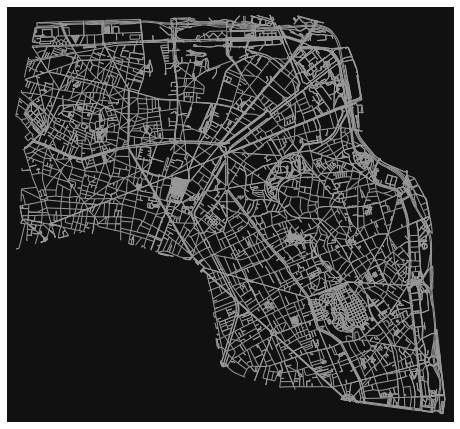

In [122]:
fig, ax = ox.plot_graph(newG)

In [123]:
newG

In [124]:
gdNotes,gdStreets = ox.utils_graph.graph_to_gdfs(newG)

In [125]:
gdStreets

osmid                 name  \
u     v     key                                                           
0     1     0                            315818975  Rue Henri Duvernois   
      2     0                             31093720    Rue Louis Lumière   
      3     0                             85735969    Rue Louis Lumière   
      4     0               [266463585, 611974677]      Rue Louis Ganne   
1     0     0                            315818975  Rue Henri Duvernois   
...                                            ...                  ...   
11780 11781 0                            940403525                  NaN   
11783 11781 0                            940403523                  NaN   
11798 11793 0    [948624025, 948624026, 948624022]                  NaN   
11801 11800 0                            949217360                  NaN   
11802 11800 0                            949217359                  NaN   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11780 11781 0             footway      NaN   False    3.772   
11783 11781 0             footway      NaN   False  103.066   
11798 11793 0    [steps, footway]      NaN   False   11.596   
11801 11800 0             service      NaN   False   12.733   
11802 11800 0             service      NaN   False   14.452   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11780 11781 0      LINESTRING (2.37582 48.86381, 2.37577 48.86379)   
11783 11781 0    LINESTRING (2.37654 48.86328, 2.37624 48.86316...   
11798 11793 0    LINESTRING (2.35467 48.87559, 2.35476 48.87559...   
11801 11800 0      LINESTRING (2.38817 48.86929, 2.38824 48.86919)   
11802 11800 0    LINESTRING (2.38810 48.86928, 2.38812 48.86925...   

                 u_original  v_original  trees  ...  greenspaces  freshplaces  \
u     v     key                                 ...                             
0     1     0        125730   268675130      6  ...            3            1   
      2     0        125730  2841627108     34  ...            3            0   
      3     0        125730   244455548     25  ...            4            2   
      4     0        125730  1089076050     12  ...            3            2   
1     0     0     268675130      125730      6  ...            3            1   
...                     ...         ...    ...  ...          ...          ...   
11780 11781 0    8709472145  8709472149     27  ...            0            0   
11783 11781 0    8709472155  8709472149     49  ...            1            0   
11798 11793 0    8780635282  8780635283     21  ...            0            0   
11801 11800 0    8787276190  8787276186      9  ...            3            2   
11802 11800 0    8787276188  8787276186     14  ...            3            2   

                 lanes  tunnel junction  ref width access        service  \
u     v     key                                                            
0     1     0      NaN     NaN      NaN  NaN   NaN    NaN            NaN   
      2     0        2     NaN      NaN  NaN   NaN    Na

In [126]:
s = gdStreets.apply(lambda x: pd.Series(x['highway']),axis=1).stack()
L = list(s.unique())
L

['residential',
 'cycleway',
 'living_street',
 'footway',
 'primary',
 'tertiary',
 'trunk_link',
 'trunk',
 'service',
 'pedestrian',
 'secondary',
 'unclassified',
 'steps',
 'path',
 'secondary_link',
 'tertiary_link',
 'primary_link',
 'motorway_link',
 'track']

In [127]:
for typeStreet in L:
    gdStreets[typeStreet] = False
    gdStreets.loc[gdStreets.highway.apply(lambda x: typeStreet in x), typeStreet] = True

In [128]:
gdStreets

osmid                 name  \
u     v     key                                                           
0     1     0                            315818975  Rue Henri Duvernois   
      2     0                             31093720    Rue Louis Lumière   
      3     0                             85735969    Rue Louis Lumière   
      4     0               [266463585, 611974677]      Rue Louis Ganne   
1     0     0                            315818975  Rue Henri Duvernois   
...                                            ...                  ...   
11780 11781 0                            940403525                  NaN   
11783 11781 0                            940403523                  NaN   
11798 11793 0    [948624025, 948624026, 948624022]                  NaN   
11801 11800 0                            949217360                  NaN   
11802 11800 0                            949217359                  NaN   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11780 11781 0             footway      NaN   False    3.772   
11783 11781 0             footway      NaN   False  103.066   
11798 11793 0    [steps, footway]      NaN   False   11.596   
11801 11800 0             service      NaN   False   12.733   
11802 11800 0             service      NaN   False   14.452   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11780 11781 0      LINESTRING (2.37582 48.86381, 2.37577 48.86379)   
11783 11781 0    LINESTRING (2.37654 48.86328, 2.37624 48.86316...   
11798 11793 0    LINESTRING (2.35467 48.87559, 2.35476 48.87559...   
11801 11800 0      LINESTRING (2.38817 48.86929, 2.38824 48.86919)   
11802 11800 0    LINESTRING (2.38810 48.86928, 2.38812 48.86925...   

                 u_original  v_original  trees  ...  pedestrian  secondary  \
u     v     key                                 ...                          
0     1     0        125730   268675130      6  ...       False      False   
      2     0        125730  2841627108     34  ...       False      False   
      3     0        125730   244455548     25  ...       False      False   
      4     0        125730  1089076050     12  ...       False      False   
1     0     0     268675130      125730      6  ...       False      False   
...                     ...         ...    ...  ...         ...        ...   
11780 11781 0    8709472145  8709472149     27  ...       False      False   
11783 11781 0    8709472155  8709472149     49  ...       False      False   
11798 11793 0    8780635282  8780635283     21  ...       False      False   
11801 11800 0    8787276190  8787276186      9  ...       False      False   
11802 11800 0    8787276188  8787276186     14  ...       False      False   

                 unclassified  steps   path secondary_link tertiary_link  \
u     v     key                                                            
0     1     0           False  False  False          False         False   
      2     0           False  False  False          False         False   
      3     0      

In [129]:
Feats = ["trees","lights","fountains","greenspaces","freshplaces"] 
for feat in Feats:
    gdStreets["p"+feat] = (10000*gdStreets[feat] / gdStreets["length"]).astype(int)

In [130]:
gdStreets

osmid                 name  \
u     v     key                                                           
0     1     0                            315818975  Rue Henri Duvernois   
      2     0                             31093720    Rue Louis Lumière   
      3     0                             85735969    Rue Louis Lumière   
      4     0               [266463585, 611974677]      Rue Louis Ganne   
1     0     0                            315818975  Rue Henri Duvernois   
...                                            ...                  ...   
11780 11781 0                            940403525                  NaN   
11783 11781 0                            940403523                  NaN   
11798 11793 0    [948624025, 948624026, 948624022]                  NaN   
11801 11800 0                            949217360                  NaN   
11802 11800 0                            949217359                  NaN   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11780 11781 0             footway      NaN   False    3.772   
11783 11781 0             footway      NaN   False  103.066   
11798 11793 0    [steps, footway]      NaN   False   11.596   
11801 11800 0             service      NaN   False   12.733   
11802 11800 0             service      NaN   False   14.452   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11780 11781 0      LINESTRING (2.37582 48.86381, 2.37577 48.86379)   
11783 11781 0    LINESTRING (2.37654 48.86328, 2.37624 48.86316...   
11798 11793 0    LINESTRING (2.35467 48.87559, 2.35476 48.87559...   
11801 11800 0      LINESTRING (2.38817 48.86929, 2.38824 48.86919)   
11802 11800 0    LINESTRING (2.38810 48.86928, 2.38812 48.86925...   

                 u_original  v_original  trees  ...  secondary_link  \
u     v     key                                 ...                   
0     1     0        125730   268675130      6  ...           False   
      2     0        125730  2841627108     34  ...           False   
      3     0        125730   244455548     25  ...           False   
      4     0        125730  1089076050     12  ...           False   
1     0     0     268675130      125730      6  ...           False   
...                     ...         ...    ...  ...             ...   
11780 11781 0    8709472145  8709472149     27  ...           False   
11783 11781 0    8709472155  8709472149     49  ...           False   
11798 11793 0    8780635282  8780635283     21  ...           False   
11801 11800 0    8787276190  8787276186      9  ...           False   
11802 11800 0    8787276188  8787276186     14  ...           False   

                 tertiary_link  primary_link  motorway_link  track ptrees  \
u     v     key                                                             
0     1     0            False         False          False  False   6891   
      2     0            False         False          False  False   2641   
      3     0            False         False          False  False   2360   
      4     0            Fals

In [131]:
newG = ox.utils_graph.graph_from_gdfs(gdNotes,gdStreets)
saveGraph(newG,"Gf")